# Confirm TensorFlow can see the GPU

Simply select "GPU" in the Accelerator drop-down in Notebook Settings (either through the Edit menu or the command palette at cmd/ctrl-shift-P).

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


In [2]:
import tensorflow as tf
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

Found GPU at: /device:GPU:0


# Observe TensorFlow speedup on GPU relative to CPU

This example constructs a typical convolutional neural network layer over a
random image and manually places the resulting ops on either the CPU or the GPU
to compare execution speed.

In [3]:
import tensorflow as tf
import timeit

# See https://www.tensorflow.org/tutorials/using_gpu#allowing_gpu_memory_growth
config = tf.ConfigProto()
config.gpu_options.allow_growth = True

with tf.device('/cpu:0'):
  random_image_cpu = tf.random_normal((100, 100, 100, 3))
  net_cpu = tf.layers.conv2d(random_image_cpu, 32, 7)
  net_cpu = tf.reduce_sum(net_cpu)

with tf.device('/gpu:0'):
  random_image_gpu = tf.random_normal((100, 100, 100, 3))
  net_gpu = tf.layers.conv2d(random_image_gpu, 32, 7)
  net_gpu = tf.reduce_sum(net_gpu)

sess = tf.Session(config=config)

# Test execution once to detect errors early.
try:
  sess.run(tf.global_variables_initializer())
except tf.errors.InvalidArgumentError:
  print(
      '\n\nThis error most likely means that this notebook is not '
      'configured to use a GPU.  Change this in Notebook Settings via the '
      'command palette (cmd/ctrl-shift-P) or the Edit menu.\n\n')
  raise

def cpu():
  sess.run(net_cpu)
  
def gpu():
  sess.run(net_gpu)
  
# Runs the op several times.
print('Time (s) to convolve 32x7x7x3 filter over random 100x100x100x3 images '
      '(batch x height x width x channel). Sum of ten runs.')
print('CPU (s):')
cpu_time = timeit.timeit('cpu()', number=10, setup="from __main__ import cpu")
print(cpu_time)
print('GPU (s):')
gpu_time = timeit.timeit('gpu()', number=10, setup="from __main__ import gpu")
print(gpu_time)
print('GPU speedup over CPU: {}x'.format(int(cpu_time/gpu_time)))

sess.close()

W0817 22:22:22.741228 140178159085440 deprecation.py:323] From <ipython-input-3-055975cd90d7>:10: conv2d (from tensorflow.python.layers.convolutional) is deprecated and will be removed in a future version.
Instructions for updating:
Use `tf.keras.layers.Conv2D` instead.
W0817 22:22:22.751965 140178159085440 deprecation.py:506] From /usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/init_ops.py:1251: calling VarianceScaling.__init__ (from tensorflow.python.ops.init_ops) with dtype is deprecated and will be removed in a future version.
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor


Time (s) to convolve 32x7x7x3 filter over random 100x100x100x3 images (batch x height x width x channel). Sum of ten runs.
CPU (s):
3.4924357570000666
GPU (s):
2.7039380549999805
GPU speedup over CPU: 1x


#  Let's just try out inference using a pre-trained model

In [4]:
%cd /content

/content


In [0]:
!mkdir Tensorflow_object_detector

In [6]:
%cd /content/Tensorflow_object_detector

/content/Tensorflow_object_detector


## Clone the models repo

In [7]:
!git clone https://github.com/tensorflow/models.git

Cloning into 'models'...
remote: Enumerating objects: 29816, done.
remote: Total 29816 (delta 0), reused 0 (delta 0), pack-reused 29816
Receiving objects: 100% (29816/29816), 510.20 MiB | 28.83 MiB/s, done.
Resolving deltas: 100% (18611/18611), done.
Checking out files: 100% (3058/3058), done.


In [8]:
!git clone https://github.com/cocodataset/cocoapi.git
!cd cocoapi/PythonAPI; make; cp -r pycocotools /content/Tensorflow_object_detector/models/research

Cloning into 'cocoapi'...
remote: Enumerating objects: 959, done.
remote: Total 959 (delta 0), reused 0 (delta 0), pack-reused 959
Receiving objects: 100% (959/959), 11.69 MiB | 13.08 MiB/s, done.
Resolving deltas: 100% (571/571), done.
python setup.py build_ext --inplace
running build_ext
cythoning pycocotools/_mask.pyx to pycocotools/_mask.c
/usr/local/lib/python3.6/dist-packages/Cython/Compiler/Main.py:369: FutureWarning: Cython directive 'language_level' not set, using 2 for now (Py2). This will change in a later release! File: /content/Tensorflow_object_detector/cocoapi/PythonAPI/pycocotools/_mask.pyx
  tree = Parsing.p_module(s, pxd, full_module_name)
building 'pycocotools._mask' extension
creating build
creating build/common
creating build/temp.linux-x86_64-3.6
creating build/temp.linux-x86_64-3.6/pycocotools
x86_64-linux-gnu-gcc -pthread -DNDEBUG -g -fwrapv -O2 -Wall -g -fstack-protector-strong -Wformat -Werror=format-security -Wdate-time -D_FORTIFY_SOURCE=2 -fPIC -I/usr/local/

In [0]:
!mkdir workspace


In [10]:
%cd /content/Tensorflow_object_detector/workspace
!mkdir training_OD

/content/Tensorflow_object_detector/workspace


In [11]:
%cd /content/Tensorflow_object_detector/workspace/training_OD
!mkdir annotations
#!mkdir images
!mkdir pre-trained_model
!mkdir training
!mkdir scripts

/content/Tensorflow_object_detector/workspace/training_OD


## Build object detection module

In [12]:
%cd /content/Tensorflow_object_detector/models/research

/content/Tensorflow_object_detector/models/research


In [13]:
g!apt-get install protobuf-compiler python-pil python-lxml python-tk
!pip install Cython
!pip install jupyter
!pip install matplotlib

Reading package lists... Done
Building dependency tree       
Reading state information... Done
protobuf-compiler is already the newest version (3.0.0-9.1ubuntu1).
python-tk is already the newest version (2.7.16-2~18.04).
The following package was automatically installed and is no longer required:
  libnvidia-common-410
Use 'apt autoremove' to remove it.
The following additional packages will be installed:
  python-bs4 python-chardet python-html5lib python-olefile
  python-pkg-resources python-six python-webencodings
Suggested packages:
  python-genshi python-lxml-dbg python-lxml-doc python-pil-doc python-pil-dbg
  python-setuptools
The following NEW packages will be installed:
  python-bs4 python-chardet python-html5lib python-lxml python-olefile
  python-pil python-pkg-resources python-six python-webencodings
0 upgraded, 9 newly installed, 0 to remove and 4 not upgraded.
Need to get 1,818 kB of archives.
After this operation, 7,688 kB of additional disk space will be used.
Get:1 http

In [14]:
%cd /content/Tensorflow_object_detector/models/research

/content/Tensorflow_object_detector/models/research


In [0]:
# in research folder 
!protoc object_detection/protos/*.proto --python_out=.

## Basic imports

In [16]:
%cd /content/Tensorflow_object_detector/models/research/object_detection

/content/Tensorflow_object_detector/models/research/object_detection


In [0]:
from distutils.version import StrictVersion
import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import zipfile
import shutil

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image
import shutil

# This is needed we are in the object_detection folder.
sys.path.append("..")
from object_detection.utils import ops as utils_ops

if StrictVersion(tf.__version__) < StrictVersion('1.9.0'):
  raise ImportError('Please upgrade your TensorFlow installation to v1.9.* or later!')

## Object Detection imports

In [0]:
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

# ignore the warning

## Loading

In [0]:
import shutil

In [20]:
shutil.copytree("/content/drive/My Drive/RFCN/jpg","/content/Tensorflow_object_detector/workspace/training_OD/images/jpg")


'/content/Tensorflow_object_detector/workspace/training_OD/images/jpg'

In [21]:
shutil.copy("/content/drive/My Drive/RFCN/dataset_in.csv","/content/Tensorflow_object_detector/workspace/training_OD/annotations")

'/content/Tensorflow_object_detector/workspace/training_OD/annotations/dataset_in.csv'

## Image Preprocessing

## Converting from Grayscale to RGB

In [22]:

RESEIZE ='/content/Tensorflow_object_detector/workspace/training_OD/images/jpg'
for file_name in os.listdir(RESEIZE):
  print("Processing %s" % file_name)
  
  image = Image.open(os.path.join(RESEIZE, file_name))
  image.show()
  rgb_image = image.convert('RGB')
  rgb_image.show()
  print(rgb_image.mode)

  dir = '/content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages'
  if not os.path.exists(dir):
       os.makedirs(dir)
  #output_file_name = os.path.join(dir, "rgb_" + file_name)
  output_file_name = os.path.join(dir,file_name)
  rgb_image.save(output_file_name)
print("All done")



Processing 9569_017.jpg
RGB
Processing 5622_013.jpg
RGB
Processing 5095_019.jpg
RGB
Processing ti11492316_2318.jpg
RGB
Processing 5375_004.jpg
RGB
Processing 5347_192.jpg
RGB
Processing 5848_023.jpg
RGB
Processing 5182_078.jpg
RGB
Processing 9566_031.jpg
RGB
Processing 2117_344.jpg
RGB
Processing 1079_023.jpg
RGB
Processing 1040_032.jpg
RGB
Processing 1777_016.jpg
RGB
Processing 9517_045.jpg
RGB
Processing 5963_008.jpg
RGB
Processing 5361_015.jpg
RGB
Processing 9567_052.jpg
RGB
Processing 6546_011.jpg
RGB
Processing 5727_105.jpg
RGB
Processing 5830_462.jpg
RGB
Processing 9566_029.jpg
RGB
Processing 9562_024.jpg
RGB
Processing 1676_008.jpg
RGB
Processing 1556_006.jpg
RGB
Processing 6580_018.jpg
RGB
Processing 9520_037.jpg
RGB
Processing 0113_013.jpg
RGB
Processing ti10161630.jpg
RGB
Processing 9512_043.jpg
RGB
Processing 6346_024.jpg
RGB
Processing 1717_086.jpg
RGB
Processing 9563_061.jpg
RGB
Processing 9515_024.jpg
RGB
Processing 1353_032.jpg
RGB
Processing 9533_038.jpg
RGB
Processing 

In [0]:
from matplotlib import pyplot as plt
image = Image.open(os.path.join('/content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages','ti16240205.jpg'))
print(image.mode)
print(image.size)
#image_np = load_image_into_numpy_array(image)
#plt.imshow(image_np)


In [0]:
import cv2 
img = cv2.imread(os.path.join('/content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages','ti16240205.jpg'))
print(img.shape)

In [0]:
#!rm -rf /content/Tensorflow_object_detector/workspace/training_OD/images/reseizedImages

## Image Reseize

Checking file: /content/Tensorflow_object_detector/workspace/training_OD/annotations/dataset_in.csv in folder: /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages
Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti01410757.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 1 files and realized 0 errors


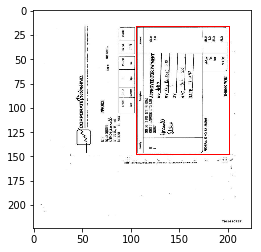

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti01410757.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 2 files and realized 0 errors


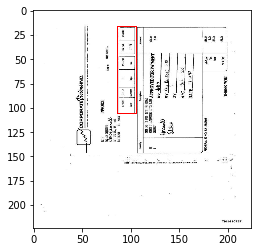

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti01410757.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 3 files and realized 0 errors


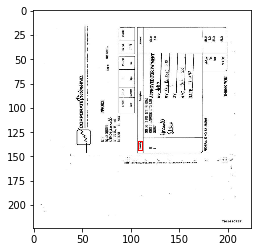

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti01410757.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 4 files and realized 0 errors


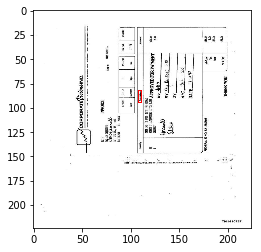

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti01410757.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 5 files and realized 0 errors


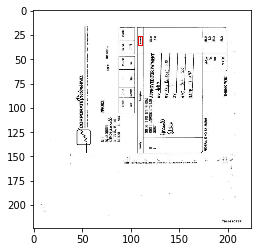

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti01410757.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 6 files and realized 0 errors


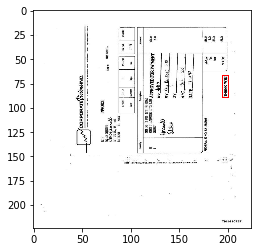

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161372.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 7 files and realized 0 errors


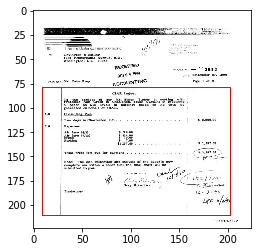

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161372.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 8 files and realized 0 errors


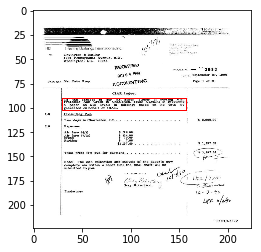

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161372.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 9 files and realized 0 errors


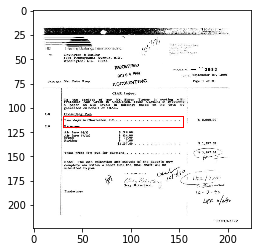

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161372.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 10 files and realized 0 errors


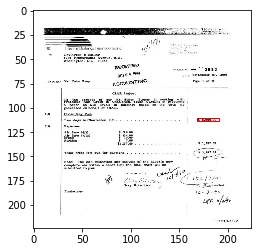

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161372.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 11 files and realized 0 errors


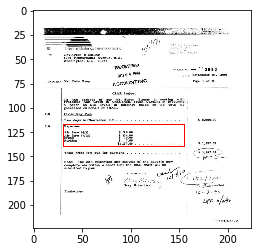

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161372.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 12 files and realized 0 errors


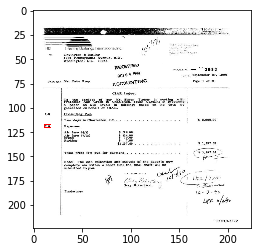

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161372.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 13 files and realized 0 errors


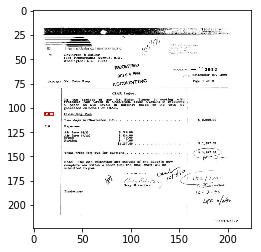

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161372.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 14 files and realized 0 errors


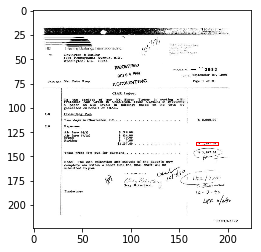

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161372.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 15 files and realized 0 errors


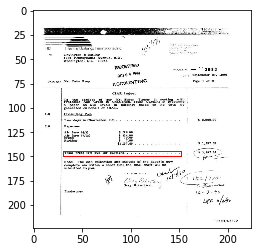

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161372.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 16 files and realized 0 errors


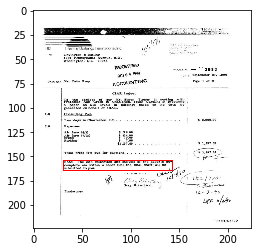

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161404.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 17 files and realized 0 errors


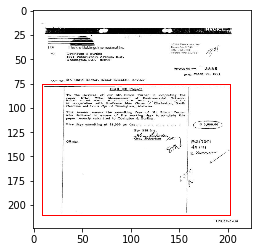

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161404.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 18 files and realized 0 errors


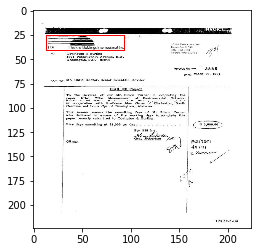

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161422.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 19 files and realized 0 errors


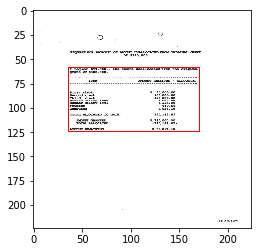

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161433.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 20 files and realized 0 errors


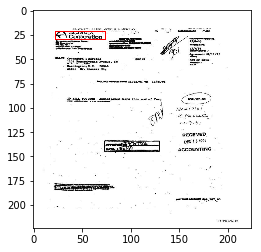

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161433.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 21 files and realized 0 errors


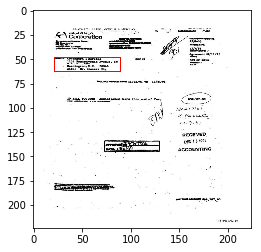

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161457.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 22 files and realized 0 errors


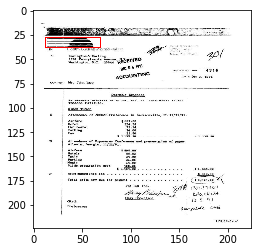

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161457.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 23 files and realized 0 errors


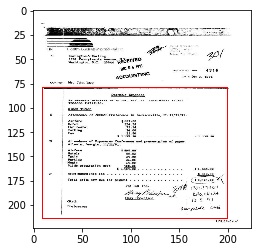

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161457.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 24 files and realized 0 errors


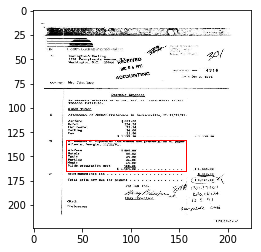

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161457.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 25 files and realized 0 errors


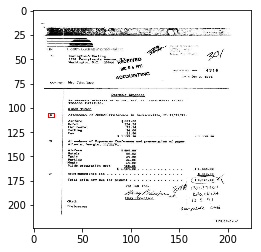

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161457.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 26 files and realized 0 errors


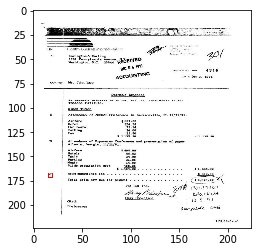

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161457.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 27 files and realized 0 errors


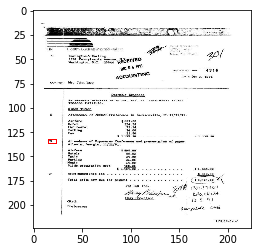

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161457.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 28 files and realized 0 errors


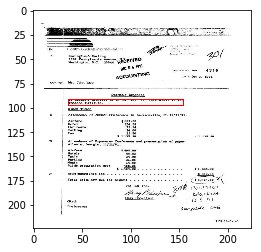

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161457.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 29 files and realized 0 errors


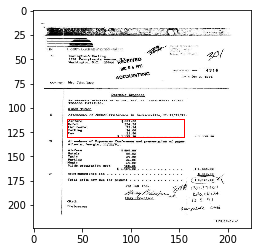

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161457.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 30 files and realized 0 errors


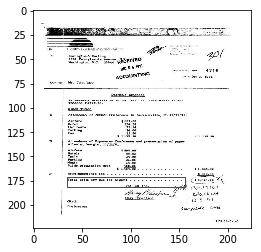

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161484.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 31 files and realized 0 errors


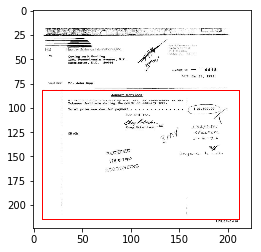

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161484.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 32 files and realized 0 errors


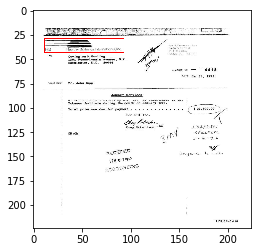

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161491.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 33 files and realized 0 errors


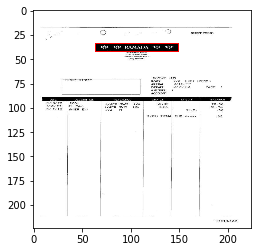

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161491.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 34 files and realized 0 errors


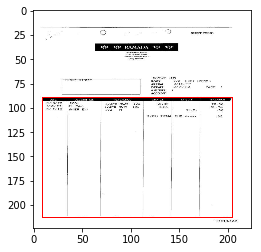

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161592.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 35 files and realized 0 errors


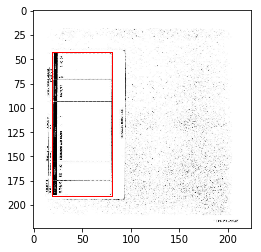

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161592.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 36 files and realized 0 errors


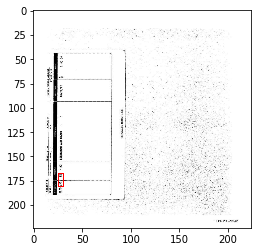

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161592.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 37 files and realized 0 errors


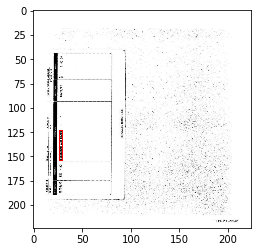

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161592.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 38 files and realized 0 errors


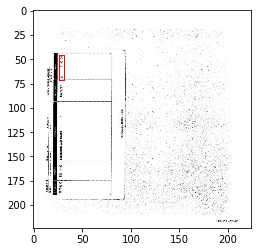

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161592.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 39 files and realized 0 errors


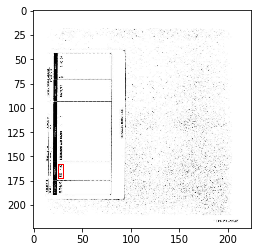

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161592.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 40 files and realized 0 errors


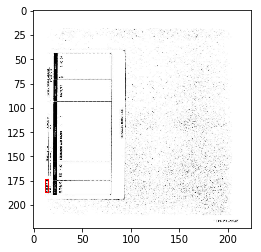

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161630.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 41 files and realized 0 errors


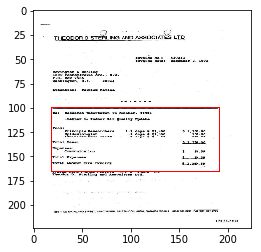

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161630.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 42 files and realized 0 errors


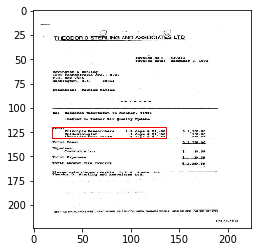

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161630.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 43 files and realized 0 errors


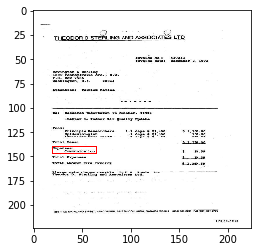

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161630.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 44 files and realized 0 errors


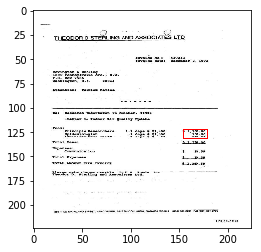

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161630.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 45 files and realized 0 errors


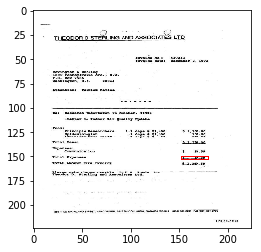

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161631.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 46 files and realized 0 errors


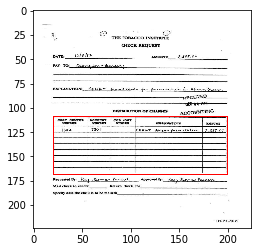

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11121470.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 47 files and realized 0 errors


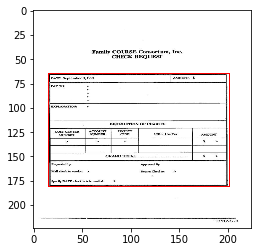

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492017.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 48 files and realized 0 errors


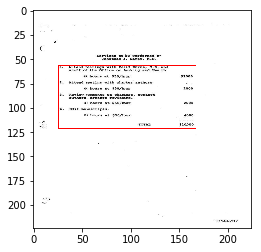

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492017.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 49 files and realized 0 errors


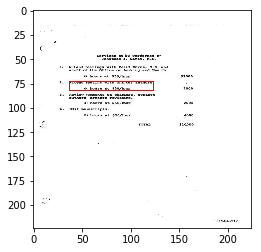

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492017.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 50 files and realized 0 errors


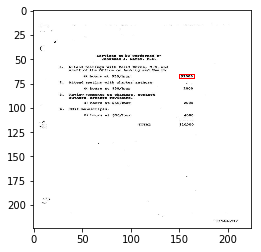

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492017.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 51 files and realized 0 errors


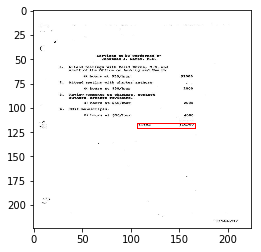

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492017.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 52 files and realized 0 errors


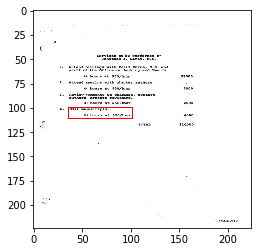

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492017.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 53 files and realized 0 errors


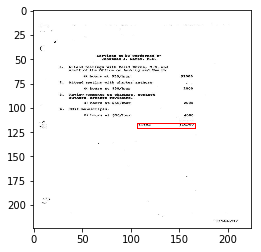

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492017.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 54 files and realized 0 errors


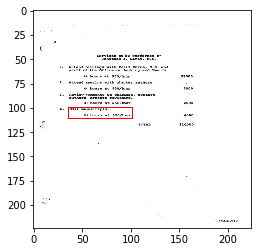

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492270.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 55 files and realized 0 errors


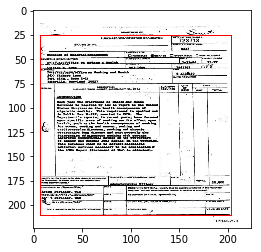

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492270.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 56 files and realized 0 errors


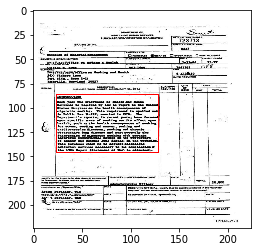

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492270.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 57 files and realized 0 errors


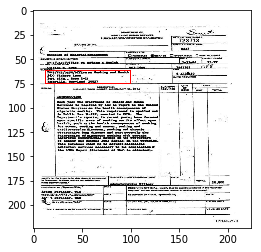

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492276_2278.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 58 files and realized 0 errors


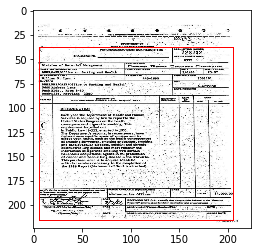

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492276_2278.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 59 files and realized 0 errors


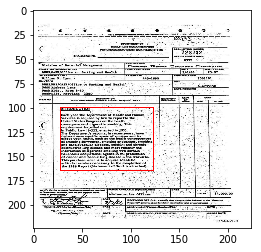

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492276_2278.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 60 files and realized 0 errors


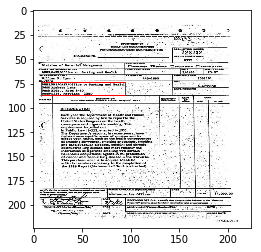

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492276_2278.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 61 files and realized 0 errors


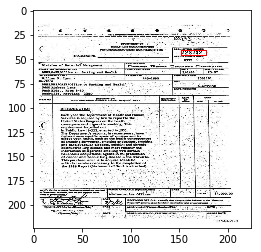

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492288_2290.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 62 files and realized 0 errors


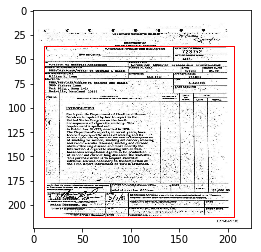

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492288_2290.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 63 files and realized 0 errors


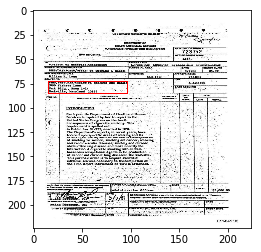

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492288_2290.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 64 files and realized 0 errors


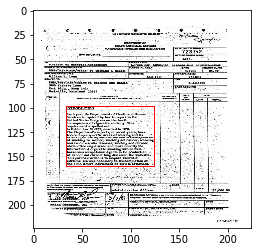

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492288_2290.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 65 files and realized 0 errors


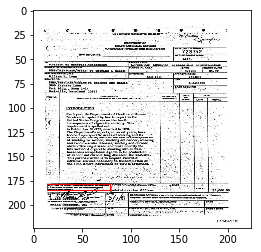

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492291_2293.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 66 files and realized 0 errors


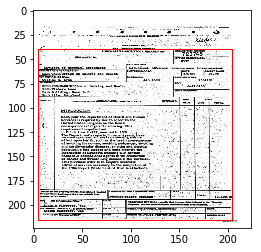

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492291_2293.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 67 files and realized 0 errors


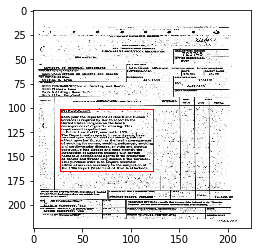

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492291_2293.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 68 files and realized 0 errors


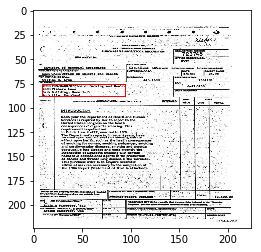

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492305_2306.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 69 files and realized 0 errors


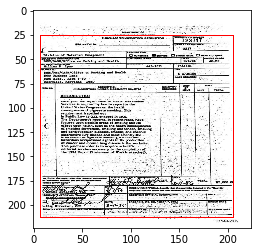

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492316_2318.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 70 files and realized 0 errors


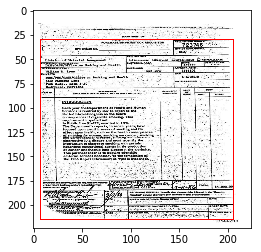

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492407_2408.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 71 files and realized 0 errors


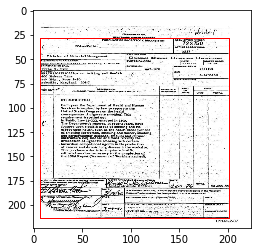

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492415_2417.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 72 files and realized 0 errors


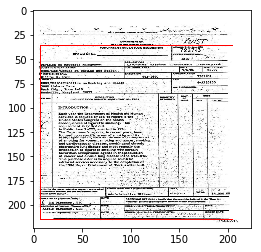

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492427_2429.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 73 files and realized 0 errors


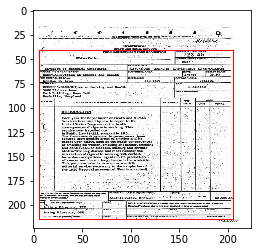

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492427_2429.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 74 files and realized 0 errors


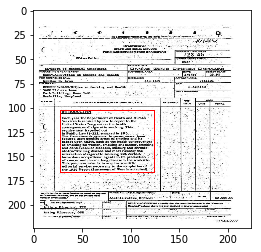

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492443_2445.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 75 files and realized 0 errors


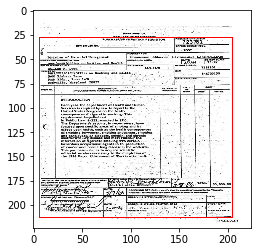

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492443_2445.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 76 files and realized 0 errors


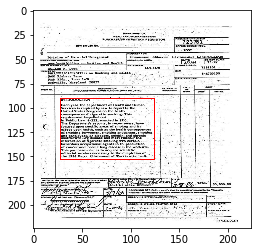

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492443_2445.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 77 files and realized 0 errors


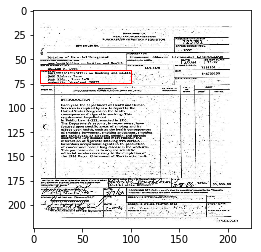

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492443_2445.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 78 files and realized 0 errors


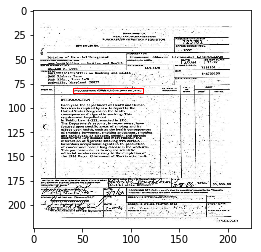

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492443_2445.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 79 files and realized 0 errors


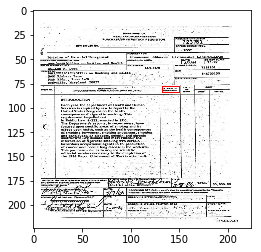

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492443_2445.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 80 files and realized 0 errors


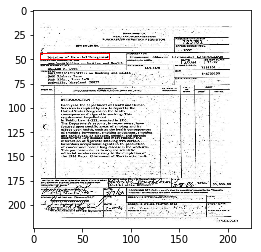

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492443_2445.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 81 files and realized 0 errors


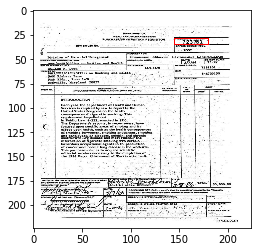

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492446_2448.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 82 files and realized 0 errors


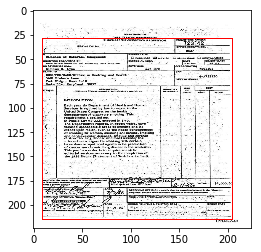

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492446_2448.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 83 files and realized 0 errors


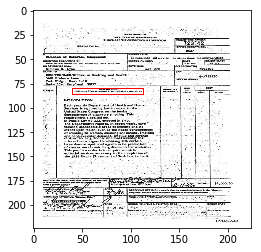

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492446_2448.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 84 files and realized 0 errors


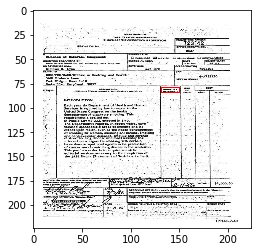

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492446_2448.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 85 files and realized 0 errors


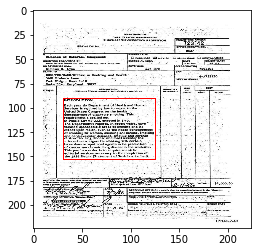

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492446_2448.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 86 files and realized 0 errors


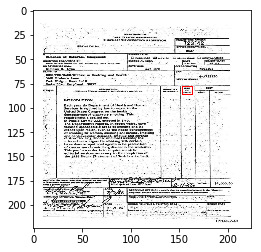

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492446_2448.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 87 files and realized 0 errors


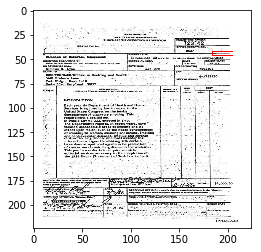

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492446_2448.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 88 files and realized 0 errors


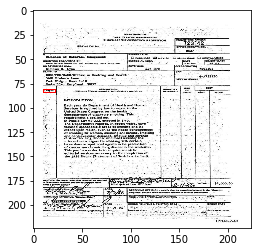

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492446_2448.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 89 files and realized 0 errors


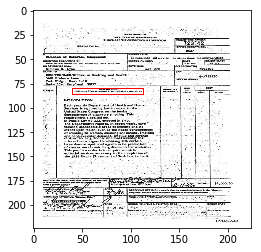

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492446_2448.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 90 files and realized 0 errors


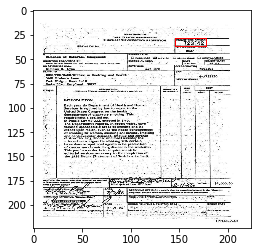

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492446_2448.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 91 files and realized 0 errors


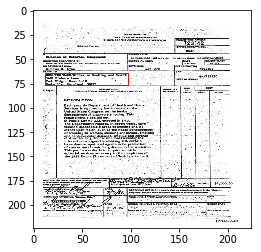

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492452_2454.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 92 files and realized 0 errors


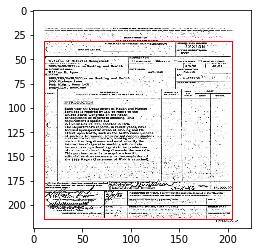

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492452_2454.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 93 files and realized 0 errors


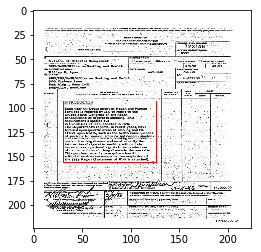

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492452_2454.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 94 files and realized 0 errors


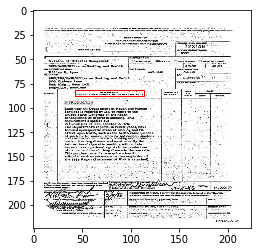

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492452_2454.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 95 files and realized 0 errors


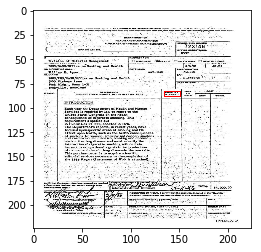

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492452_2454.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 96 files and realized 0 errors


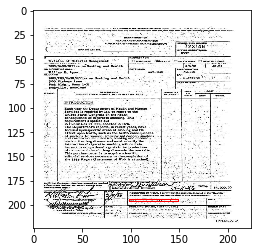

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492452_2454.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 97 files and realized 0 errors


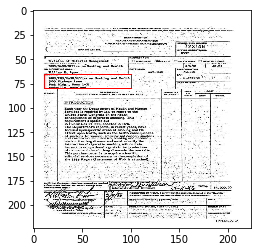

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492452_2454.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 98 files and realized 0 errors


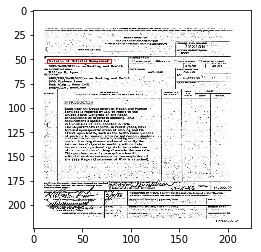

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492452_2454.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 99 files and realized 0 errors


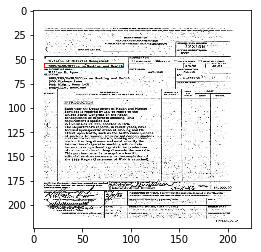

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492458_2460.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 100 files and realized 0 errors


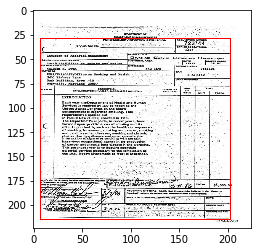

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492458_2460.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 101 files and realized 0 errors


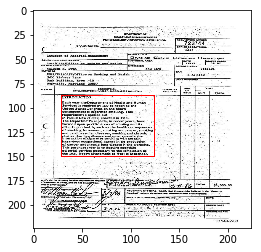

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492458_2460.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 102 files and realized 0 errors


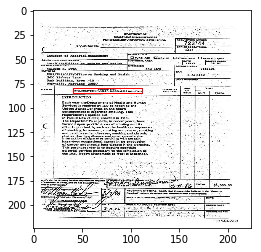

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492458_2460.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 103 files and realized 0 errors


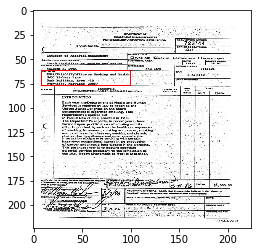

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492458_2460.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 104 files and realized 0 errors


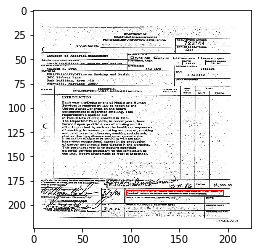

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492458_2460.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 105 files and realized 0 errors


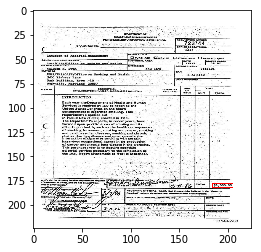

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492458_2460.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 106 files and realized 0 errors


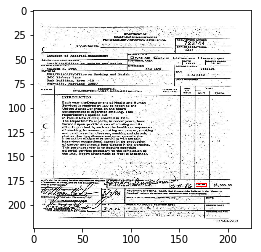

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492458_2460.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 107 files and realized 0 errors


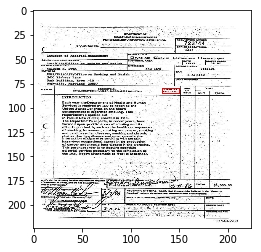

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492458_2460.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 108 files and realized 0 errors


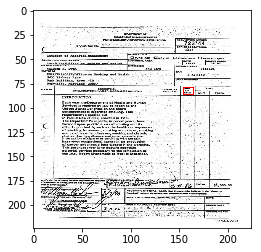

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492458_2460.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 109 files and realized 0 errors


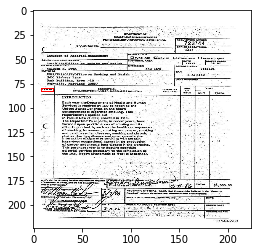

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492458_2460.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 110 files and realized 0 errors


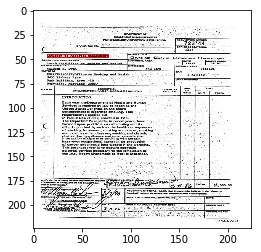

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492463_2465.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 111 files and realized 0 errors


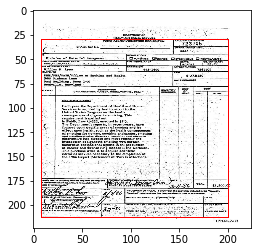

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492463_2465.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 112 files and realized 0 errors


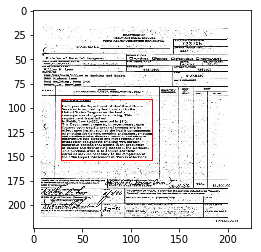

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492463_2465.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 113 files and realized 0 errors


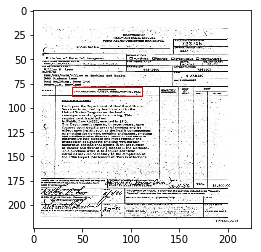

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492463_2465.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 114 files and realized 0 errors


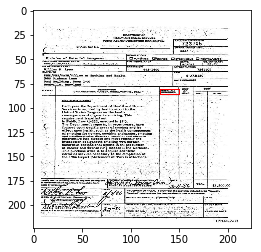

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492463_2465.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 115 files and realized 0 errors


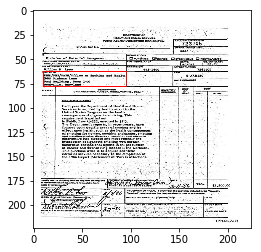

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492463_2465.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 116 files and realized 0 errors


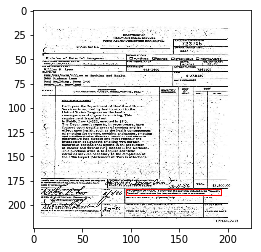

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492463_2465.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 117 files and realized 0 errors


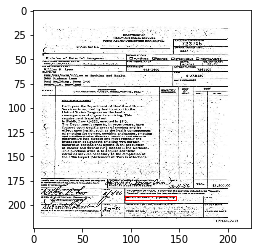

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492463_2465.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 118 files and realized 0 errors


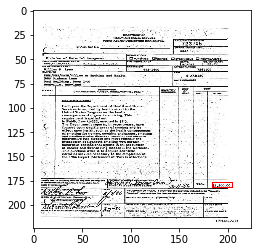

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492463_2465.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 119 files and realized 0 errors


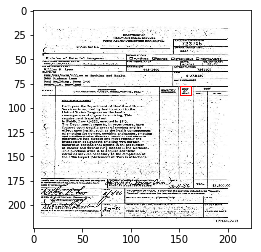

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492463_2465.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 120 files and realized 0 errors


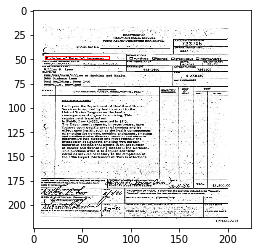

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492463_2465.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 121 files and realized 0 errors


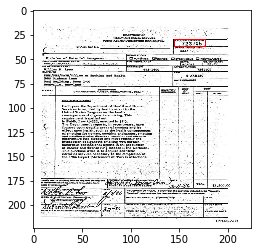

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492463_2465.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 122 files and realized 0 errors


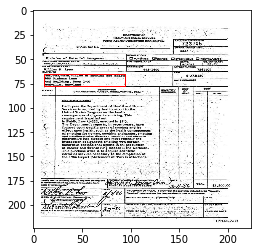

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492463_2465.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 123 files and realized 0 errors


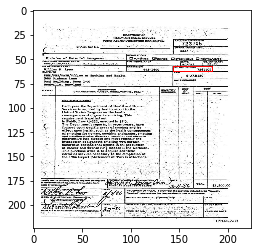

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492463_2465.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 124 files and realized 0 errors


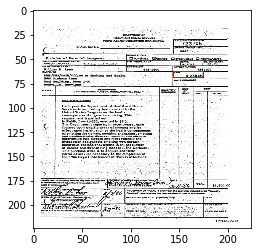

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492463_2465.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 125 files and realized 0 errors


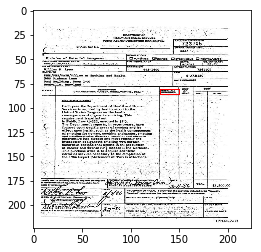

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti12590148.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 126 files and realized 0 errors


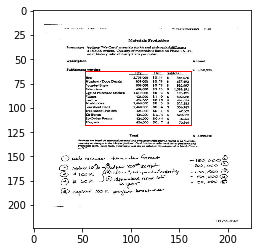

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti12590148.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 127 files and realized 0 errors


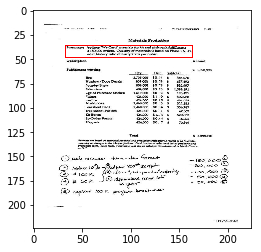

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti12590148.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 128 files and realized 0 errors


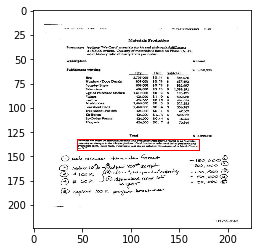

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti14861145.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 129 files and realized 0 errors


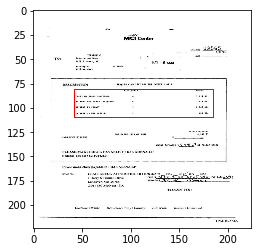

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti14861145.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 130 files and realized 0 errors


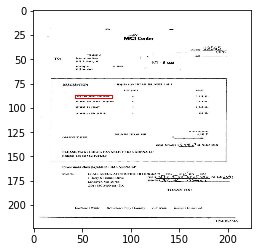

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti14861145.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 131 files and realized 0 errors


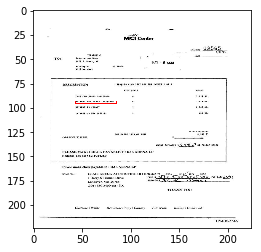

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti14861145.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 132 files and realized 0 errors


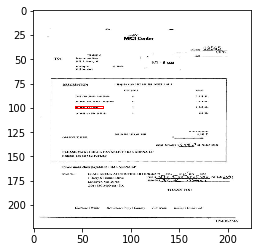

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti14861145.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 133 files and realized 0 errors


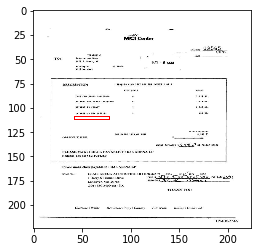

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti14861145.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 134 files and realized 0 errors


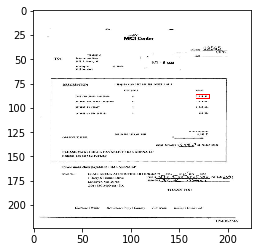

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti14861145.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 135 files and realized 0 errors


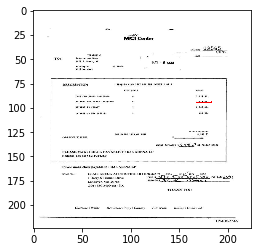

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti14861145.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 136 files and realized 0 errors


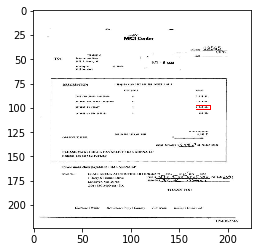

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti14861145.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 137 files and realized 0 errors


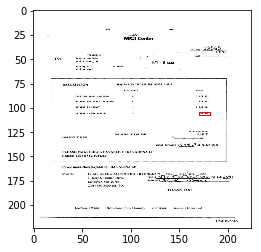

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti14940065.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 138 files and realized 0 errors


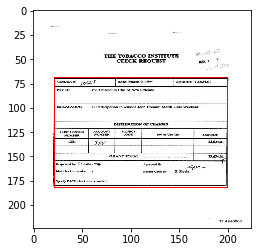

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti14940067.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 139 files and realized 0 errors


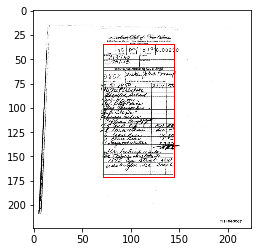

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti14940106.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 140 files and realized 0 errors


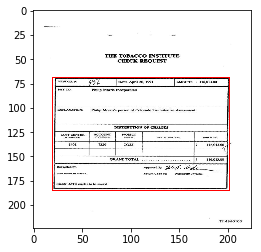

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti14940106.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 141 files and realized 0 errors


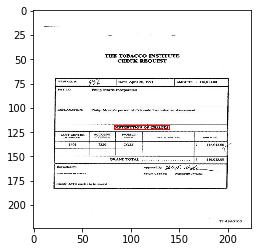

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti14940106.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 142 files and realized 0 errors


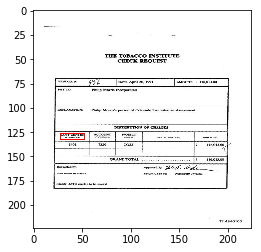

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti14940106.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 143 files and realized 0 errors


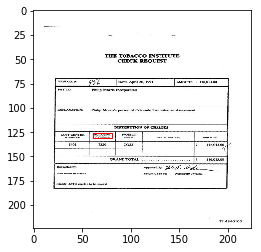

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti14940106.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 144 files and realized 0 errors


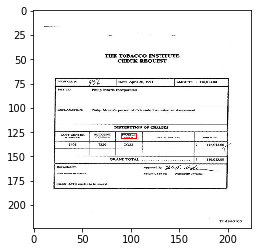

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti14940106.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 145 files and realized 0 errors


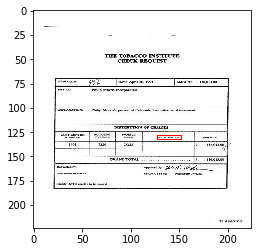

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti14940106.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 146 files and realized 0 errors


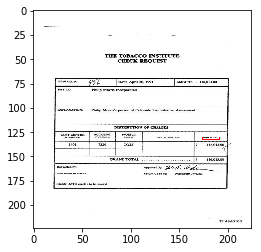

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti14940106.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 147 files and realized 0 errors


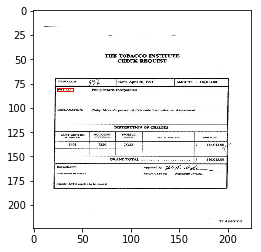

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti14940106.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 148 files and realized 0 errors


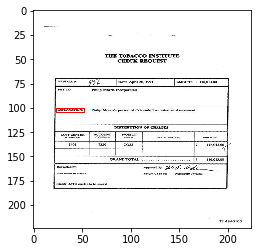

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15149006_9007.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 149 files and realized 0 errors


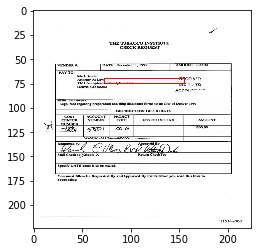

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15149006_9007.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 150 files and realized 0 errors


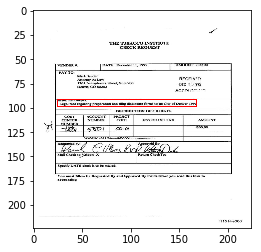

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15149006_9007.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 151 files and realized 0 errors


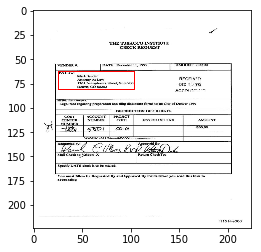

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15149006_9007.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 152 files and realized 0 errors


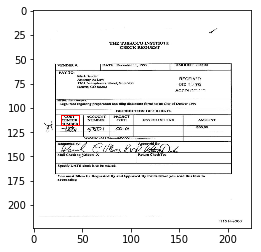

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15149006_9007.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 153 files and realized 0 errors


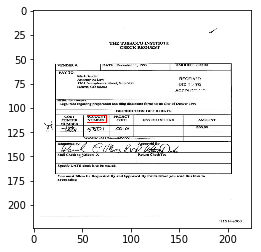

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15149006_9007.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 154 files and realized 0 errors


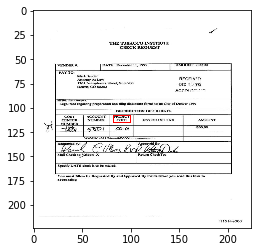

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15149006_9007.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 155 files and realized 0 errors


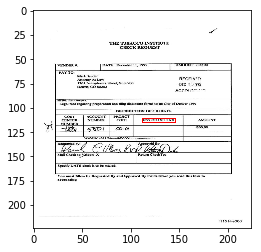

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15149006_9007.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 156 files and realized 0 errors


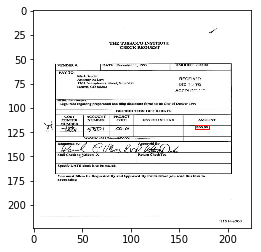

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15149006_9007.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 157 files and realized 0 errors


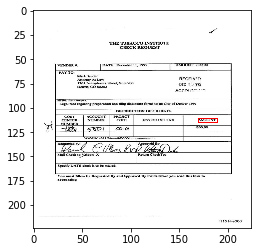

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15149006_9007.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 158 files and realized 0 errors


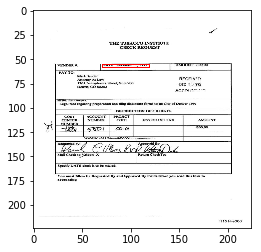

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269213_9214.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 159 files and realized 0 errors


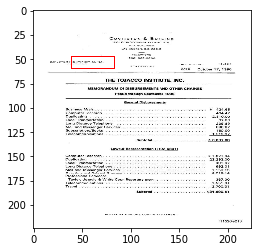

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269213_9214.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 160 files and realized 0 errors


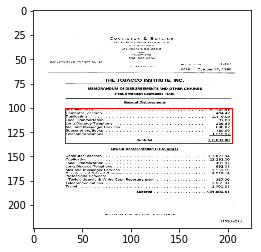

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269213_9214.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 161 files and realized 0 errors


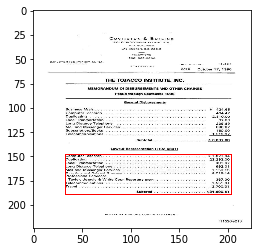

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269213_9214.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 162 files and realized 0 errors


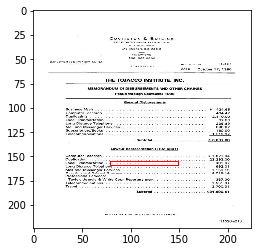

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269213_9214.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 163 files and realized 0 errors


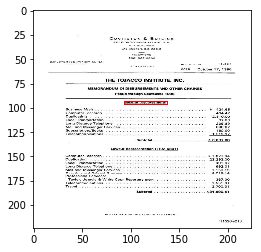

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269213_9214.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 164 files and realized 0 errors


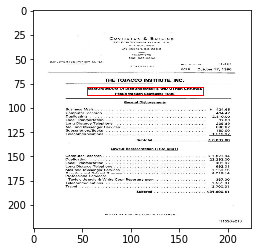

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269213_9214.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 165 files and realized 0 errors


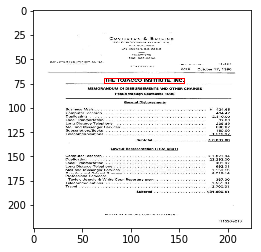

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269213_9214.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 166 files and realized 0 errors


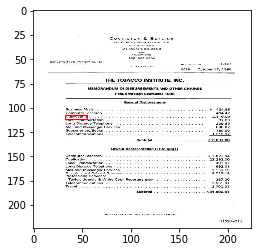

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269213_9214.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 167 files and realized 0 errors


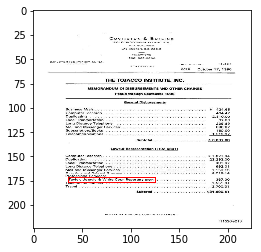

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269213_9214.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 168 files and realized 0 errors


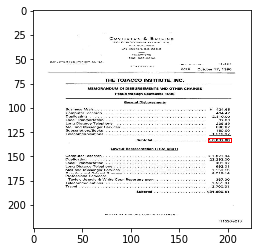

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269213_9214.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 169 files and realized 0 errors


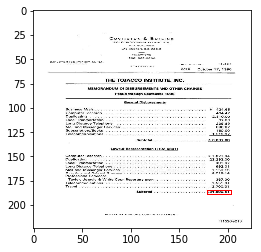

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269213_9214.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 170 files and realized 0 errors


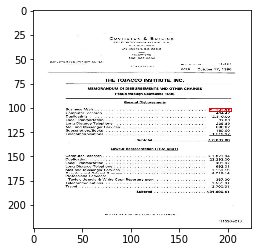

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269213_9214.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 171 files and realized 0 errors


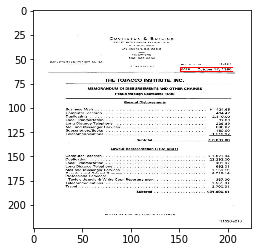

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269213_9214.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 172 files and realized 0 errors


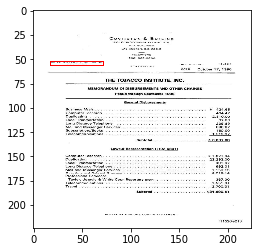

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269213_9214.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 173 files and realized 0 errors


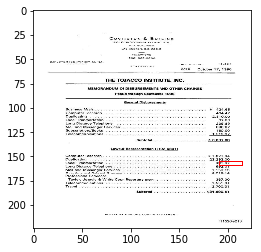

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269402.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 174 files and realized 0 errors


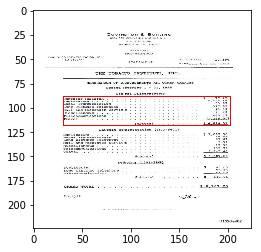

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269402.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 175 files and realized 0 errors


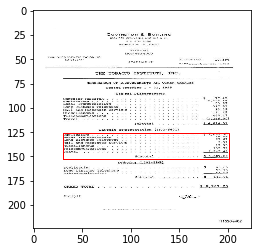

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269402.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 176 files and realized 0 errors


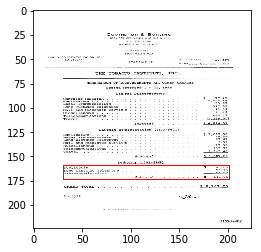

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269402.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 177 files and realized 0 errors


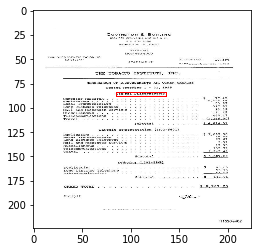

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269402.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 178 files and realized 0 errors


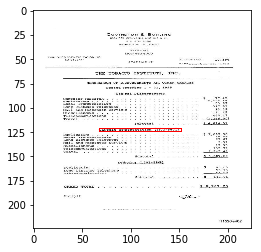

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269402.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 179 files and realized 0 errors


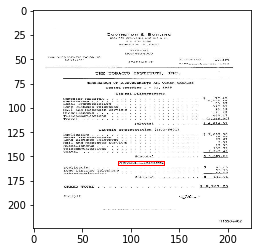

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269402.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 180 files and realized 0 errors


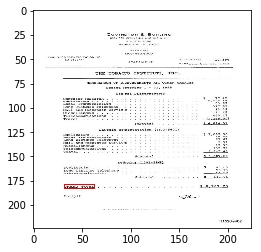

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269402.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 181 files and realized 0 errors


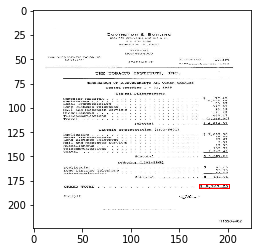

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269402.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 182 files and realized 0 errors


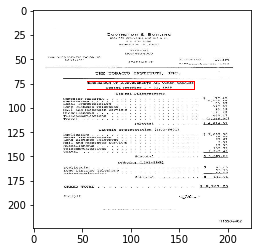

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269402.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 183 files and realized 0 errors


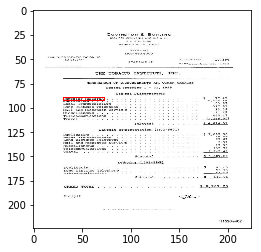

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269402.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 184 files and realized 0 errors


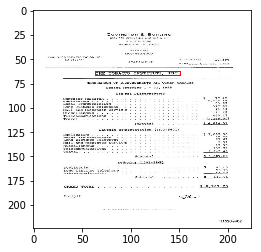

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269402.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 185 files and realized 0 errors


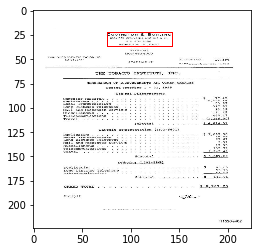

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269536.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 186 files and realized 0 errors


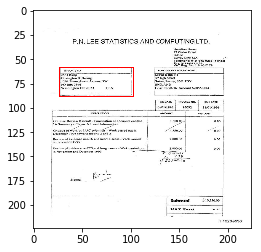

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269536.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 187 files and realized 0 errors


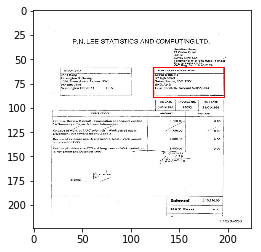

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269536.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 188 files and realized 0 errors


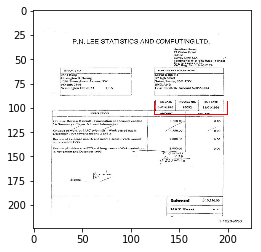

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269536.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 189 files and realized 0 errors


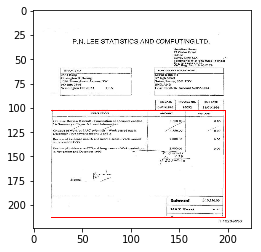

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269536.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 190 files and realized 0 errors


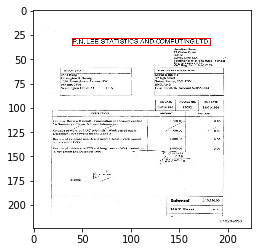

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269536.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 191 files and realized 0 errors


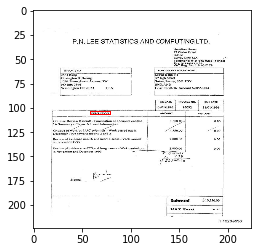

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269536.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 192 files and realized 0 errors


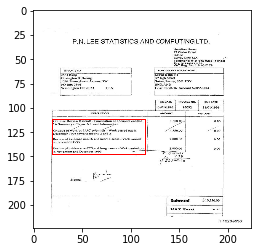

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269536.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 193 files and realized 0 errors


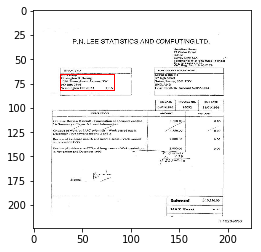

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269536.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 194 files and realized 0 errors


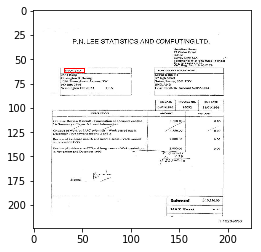

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269536.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 195 files and realized 0 errors


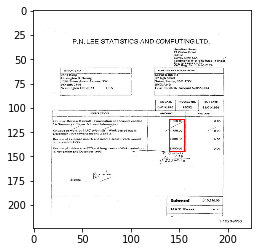

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269536.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 196 files and realized 0 errors


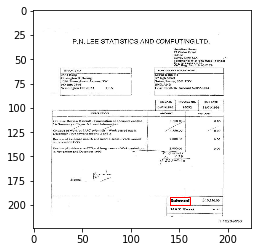

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269536.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 197 files and realized 0 errors


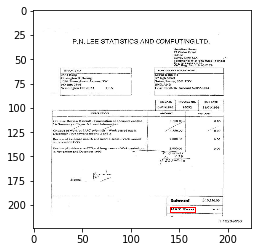

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269536.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 198 files and realized 0 errors


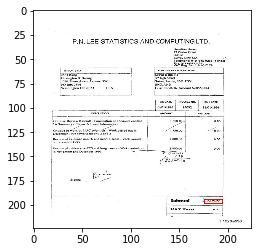

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269536.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 199 files and realized 0 errors


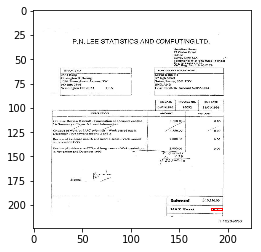

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269536.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 200 files and realized 0 errors


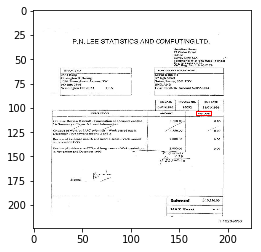

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269536.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 201 files and realized 0 errors


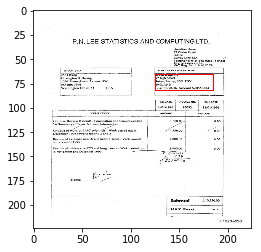

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15269536.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 202 files and realized 0 errors


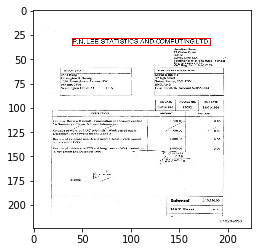

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15349892_9893.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 203 files and realized 0 errors


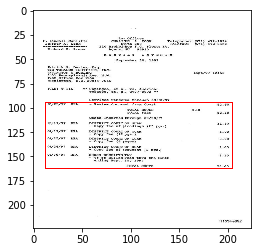

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15349892_9893.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 204 files and realized 0 errors


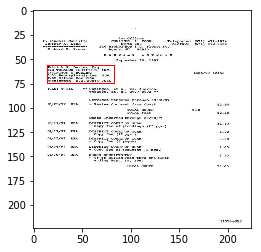

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15349892_9893.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 205 files and realized 0 errors


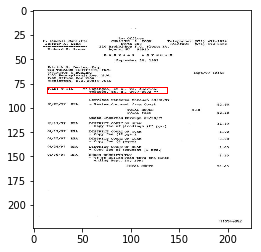

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15358003.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 206 files and realized 0 errors


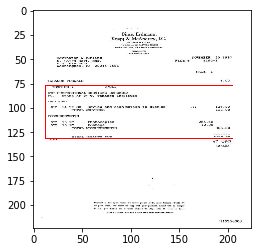

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15358103.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 207 files and realized 0 errors


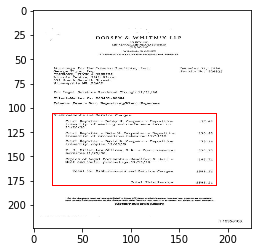

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15358103.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 208 files and realized 0 errors


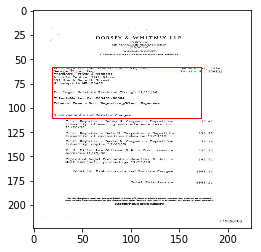

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15359176.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 209 files and realized 0 errors


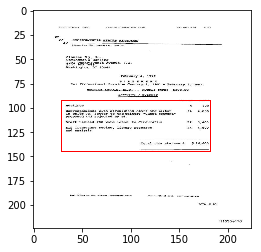

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15359176.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 210 files and realized 0 errors


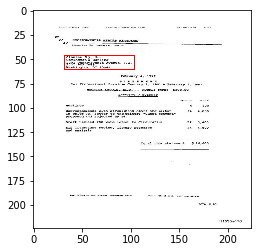

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15620757_0760.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 211 files and realized 0 errors


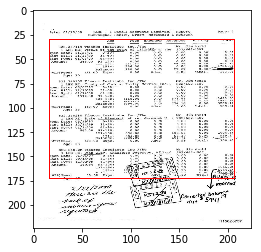

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15630651.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 212 files and realized 0 errors


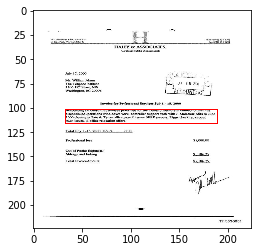

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15630651.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 213 files and realized 0 errors


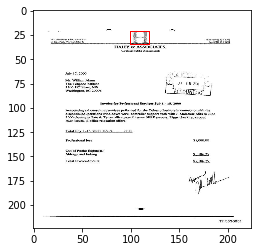

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15630654.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 214 files and realized 0 errors


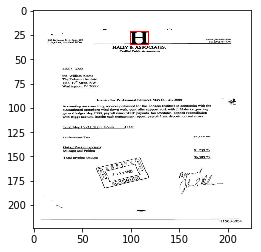

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15630654.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 215 files and realized 0 errors


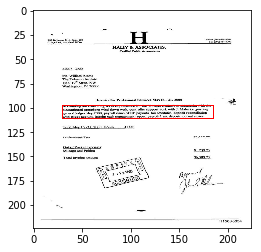

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15630654.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 216 files and realized 0 errors


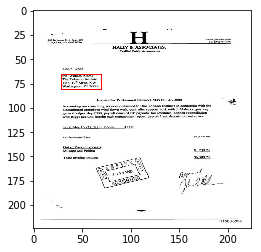

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15630654.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 217 files and realized 0 errors


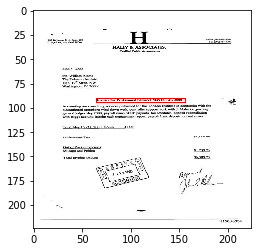

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15630654.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 218 files and realized 0 errors


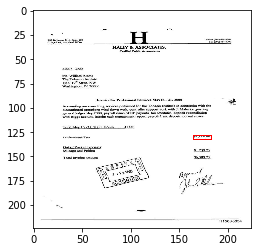

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15630654.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 219 files and realized 0 errors


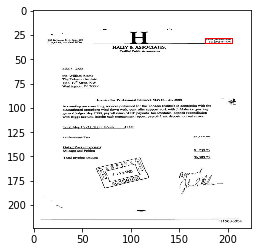

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti15630654.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 220 files and realized 0 errors


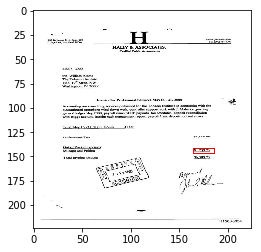

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16131018_1019.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 221 files and realized 0 errors


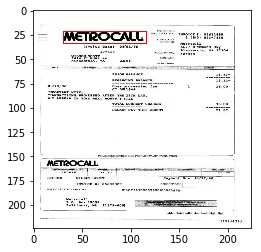

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16131018_1019.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 222 files and realized 0 errors


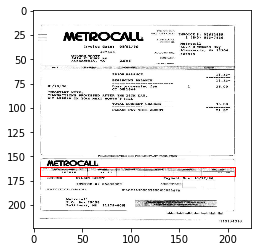

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16131018_1019.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 223 files and realized 0 errors


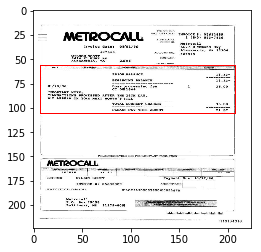

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16131018_1019.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 224 files and realized 0 errors


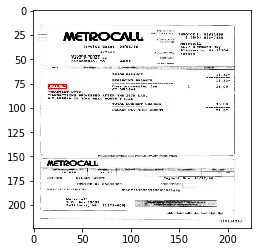

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16131018_1019.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 225 files and realized 0 errors


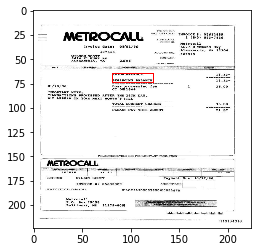

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16131018_1019.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 226 files and realized 0 errors


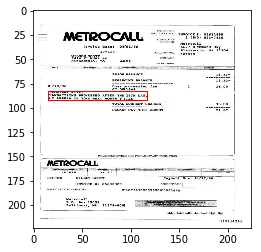

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16131018_1019.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 227 files and realized 0 errors


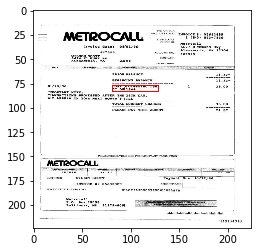

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16131018_1019.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 228 files and realized 0 errors


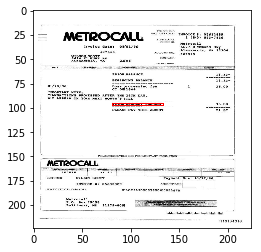

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16131018_1019.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 229 files and realized 0 errors


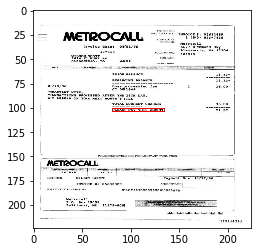

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16131018_1019.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 230 files and realized 0 errors


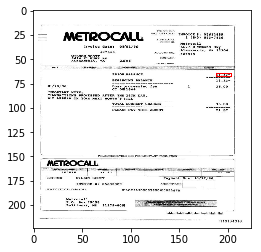

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16131018_1019.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 231 files and realized 0 errors


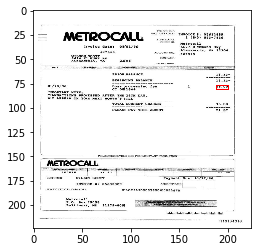

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16131018_1019.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 232 files and realized 0 errors


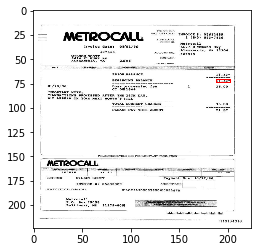

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16131018_1019.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 233 files and realized 0 errors


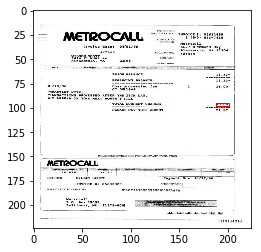

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16131018_1019.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 234 files and realized 0 errors


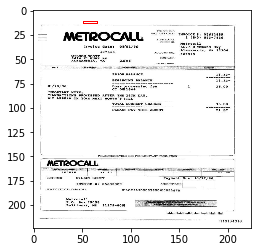

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16131018_1019.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 235 files and realized 0 errors


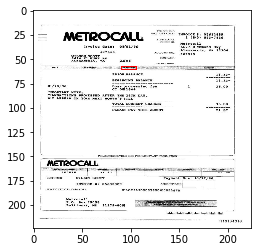

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16131018_1019.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 236 files and realized 0 errors


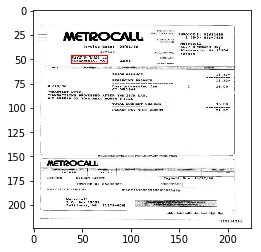

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16131018_1019.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 237 files and realized 0 errors


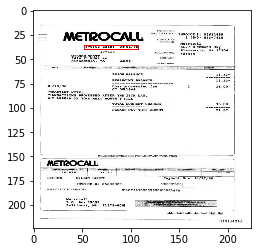

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16131018_1019.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 238 files and realized 0 errors


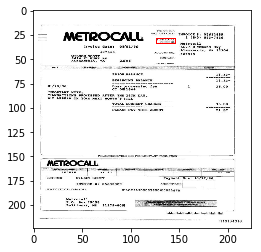

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16131018_1019.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 239 files and realized 0 errors


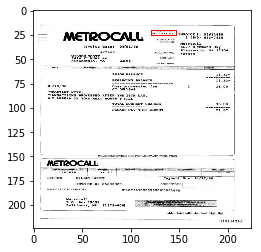

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16131018_1019.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 240 files and realized 0 errors


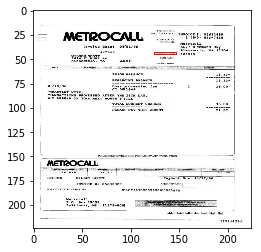

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16131018_1019.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 241 files and realized 0 errors


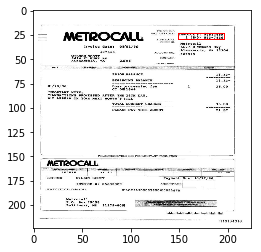

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16131018_1019.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 242 files and realized 0 errors


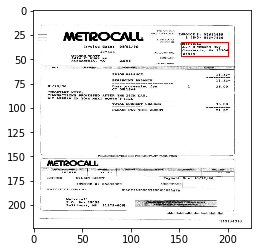

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16131018_1019.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 243 files and realized 0 errors


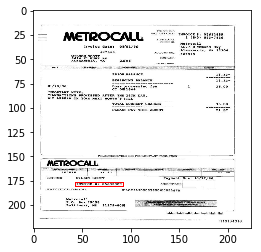

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16131018_1019.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 244 files and realized 0 errors


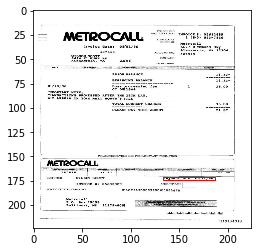

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240205.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 245 files and realized 0 errors


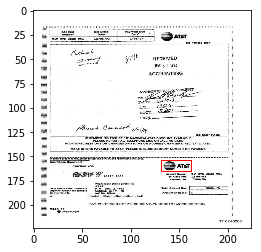

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240205.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 246 files and realized 0 errors


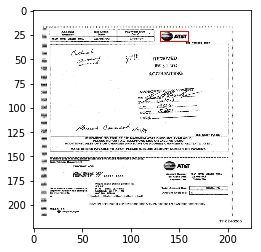

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240205.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 247 files and realized 0 errors


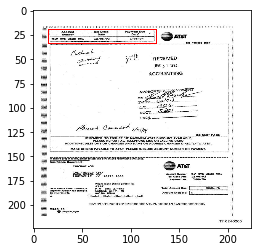

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240205.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 248 files and realized 0 errors


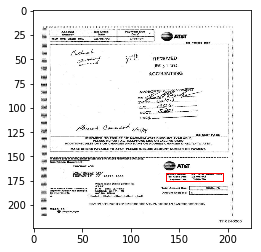

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240205.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 249 files and realized 0 errors


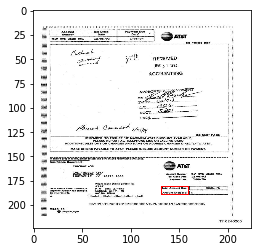

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240205.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 250 files and realized 0 errors


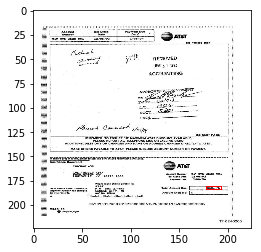

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240205.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 251 files and realized 0 errors


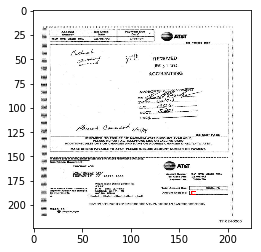

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240205.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 252 files and realized 0 errors


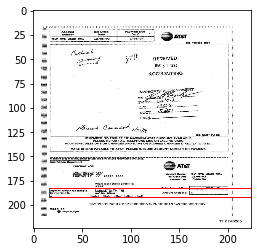

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240205.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 253 files and realized 0 errors


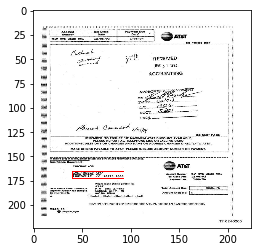

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240205.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 254 files and realized 0 errors


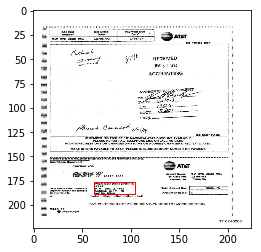

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240205.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 255 files and realized 0 errors


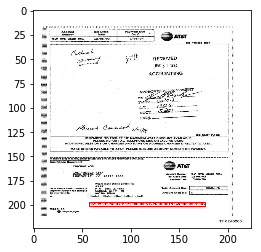

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240205.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 256 files and realized 0 errors


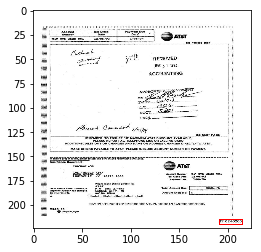

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240205.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 257 files and realized 0 errors


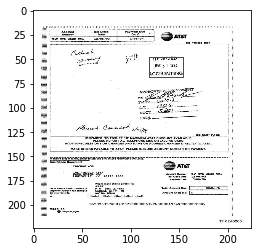

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240205.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 258 files and realized 0 errors


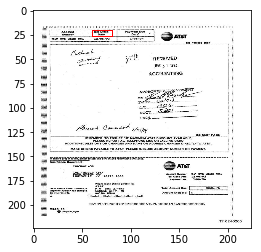

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240205.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 259 files and realized 0 errors


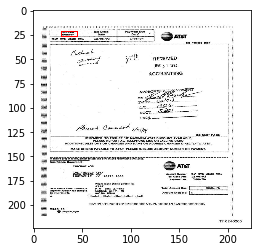

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240205.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 260 files and realized 0 errors


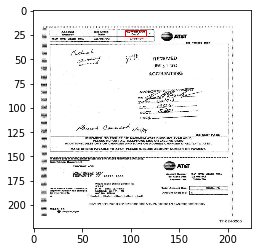

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240205.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 261 files and realized 0 errors


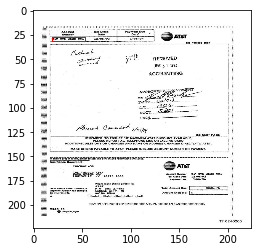

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240205.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 262 files and realized 0 errors


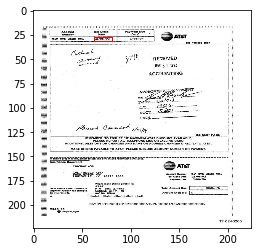

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240205.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 263 files and realized 0 errors


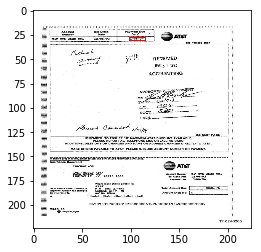

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240222.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 264 files and realized 0 errors


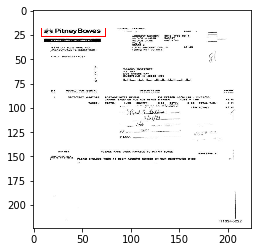

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240222.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 265 files and realized 0 errors


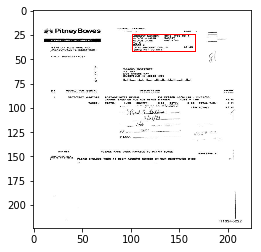

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240222.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 266 files and realized 0 errors


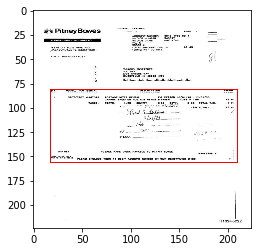

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240222.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 267 files and realized 0 errors


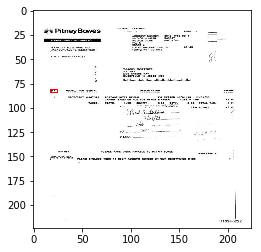

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240222.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 268 files and realized 0 errors


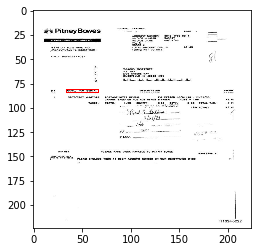

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240222.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 269 files and realized 0 errors


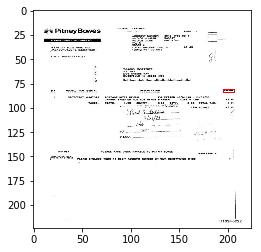

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240222.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 270 files and realized 0 errors


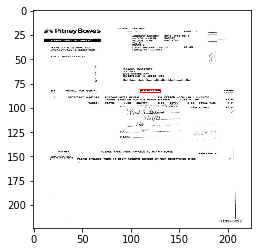

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240222.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 271 files and realized 0 errors


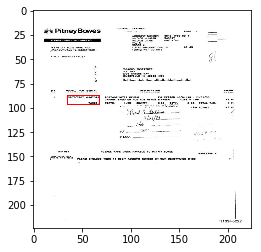

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240222.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 272 files and realized 0 errors


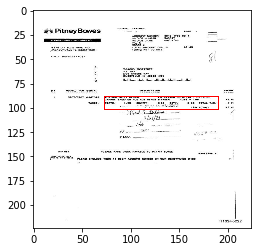

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240222.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 273 files and realized 0 errors


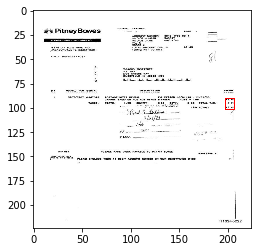

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240222.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 274 files and realized 0 errors


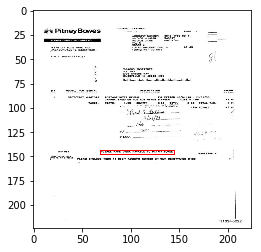

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240222.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 275 files and realized 0 errors


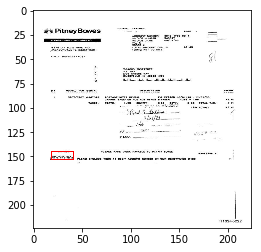

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240222.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 276 files and realized 0 errors


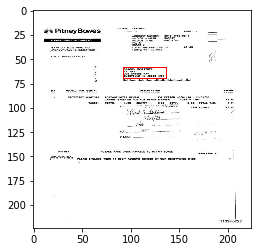

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240222.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 277 files and realized 0 errors


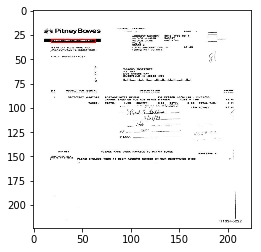

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240222.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 278 files and realized 0 errors


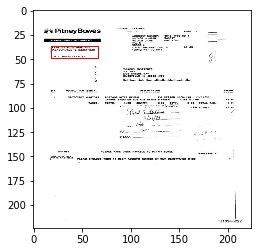

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240222.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 279 files and realized 0 errors


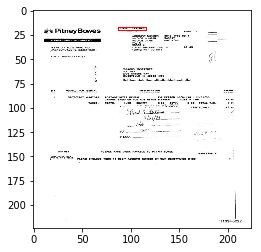

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240222.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 280 files and realized 0 errors


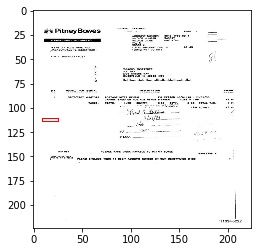

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240222.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 281 files and realized 0 errors


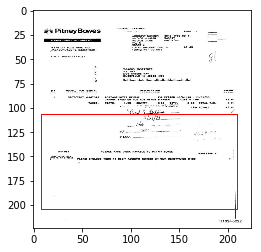

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240222.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 282 files and realized 0 errors


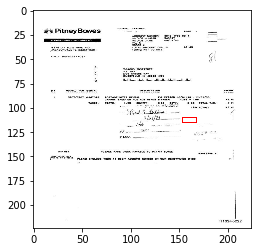

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240222.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 283 files and realized 0 errors


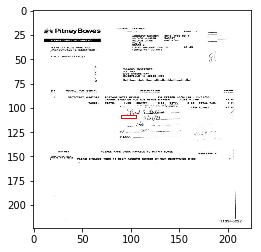

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240222.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 284 files and realized 0 errors


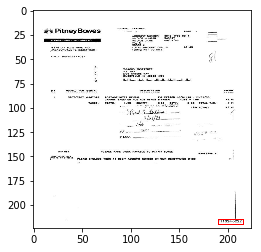

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240222.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 285 files and realized 0 errors


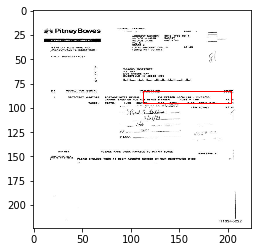

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240222.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 286 files and realized 0 errors


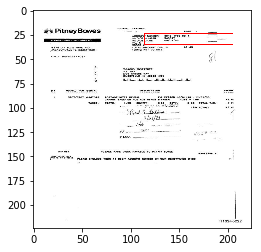

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240222.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 287 files and realized 0 errors


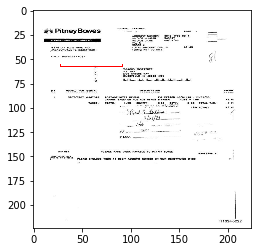

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16240222.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 288 files and realized 0 errors


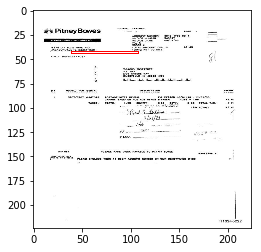

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16310759.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 289 files and realized 0 errors


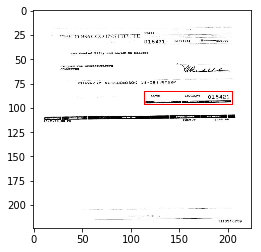

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16310759.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 290 files and realized 0 errors


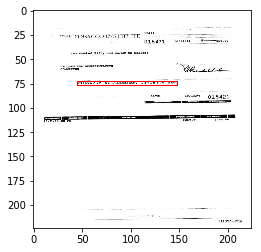

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16310759.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 291 files and realized 0 errors


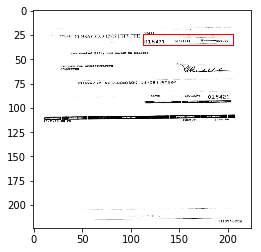

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16310759.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 292 files and realized 0 errors


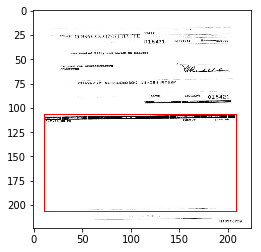

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16310759.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 293 files and realized 0 errors


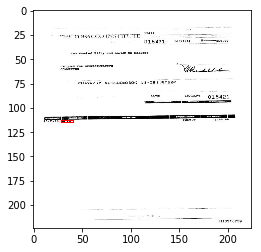

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16310759.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 294 files and realized 0 errors


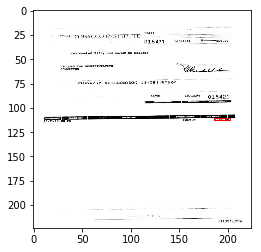

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16310759.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 295 files and realized 0 errors


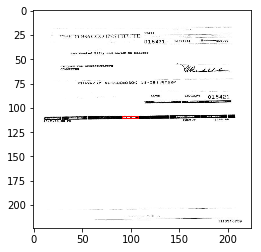

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16310759.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 296 files and realized 0 errors


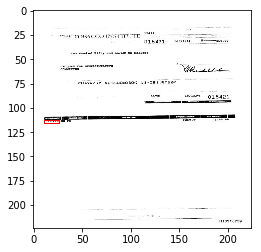

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16310776.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 297 files and realized 0 errors


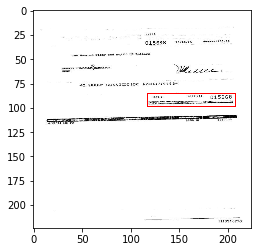

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16310776.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 298 files and realized 0 errors


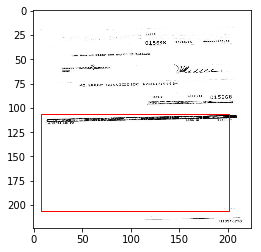

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16310776.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 299 files and realized 0 errors


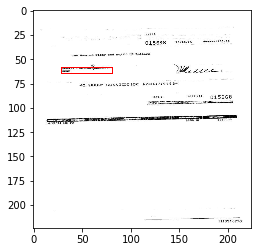

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16310776.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 300 files and realized 0 errors


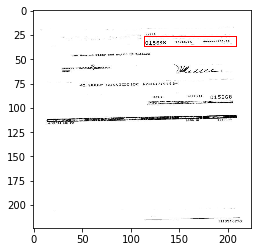

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16310776.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 301 files and realized 0 errors


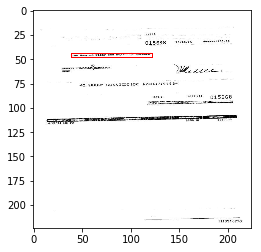

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16310776.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 302 files and realized 0 errors


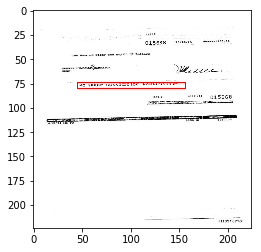

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16310776.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 303 files and realized 0 errors


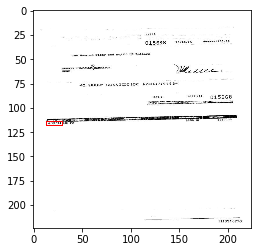

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16310776.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 304 files and realized 0 errors


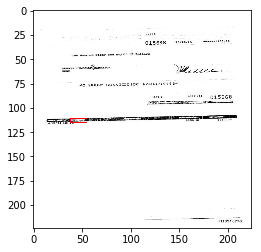

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16310776.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 305 files and realized 0 errors


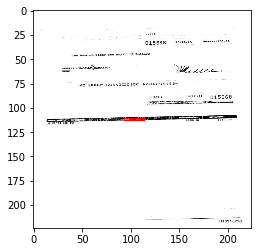

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16310776.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 306 files and realized 0 errors


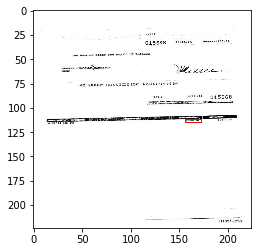

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16310776.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 307 files and realized 0 errors


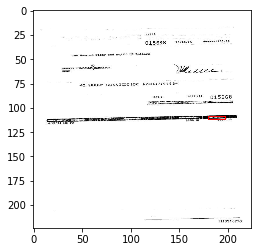

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16310776.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 308 files and realized 0 errors


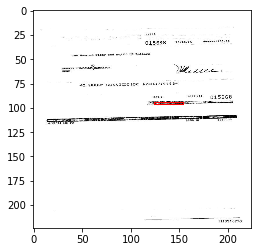

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16310776.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 309 files and realized 0 errors


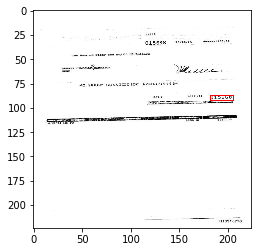

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti16310776.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 310 files and realized 0 errors


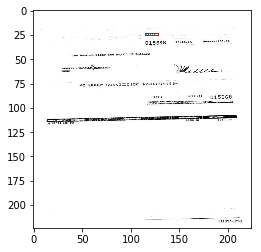

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747862.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 311 files and realized 0 errors


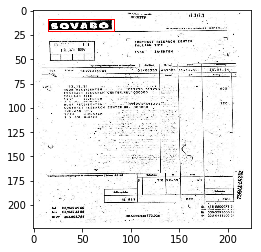

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747862.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 312 files and realized 0 errors


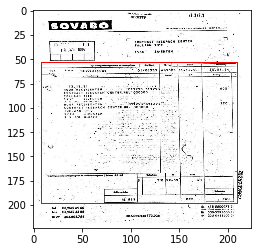

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747912.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 313 files and realized 0 errors


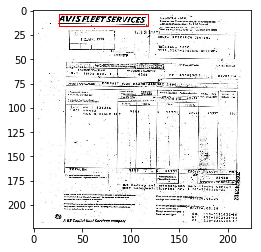

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747912.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 314 files and realized 0 errors


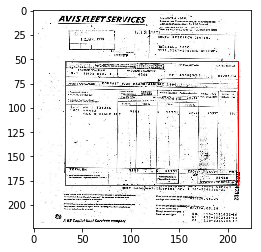

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747912.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 315 files and realized 0 errors


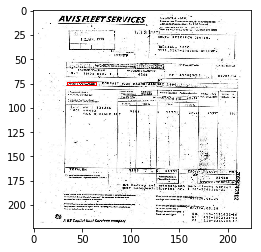

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747912.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 316 files and realized 0 errors


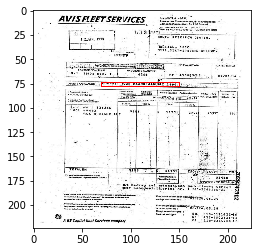

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747912.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 317 files and realized 0 errors


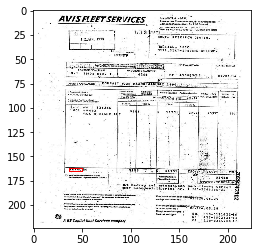

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747912.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 318 files and realized 0 errors


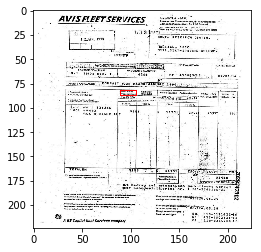

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747912.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 319 files and realized 0 errors


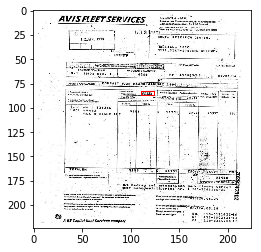

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747912.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 320 files and realized 0 errors


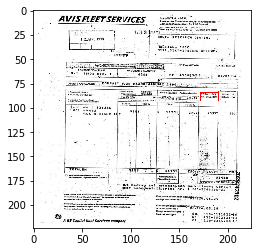

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747912.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 321 files and realized 0 errors


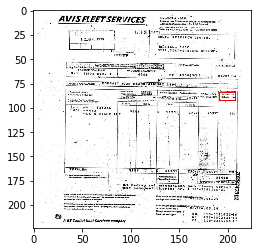

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747912.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 322 files and realized 0 errors


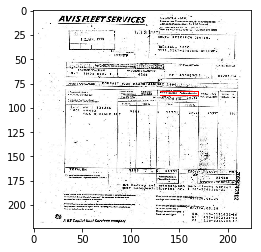

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747912.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 323 files and realized 0 errors


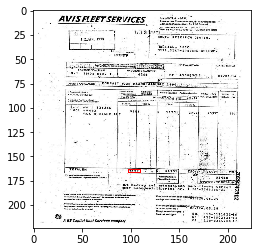

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747912.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 324 files and realized 0 errors


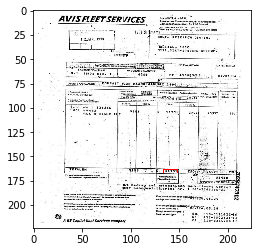

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747912.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 325 files and realized 0 errors


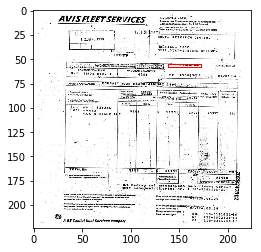

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747912.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 326 files and realized 0 errors


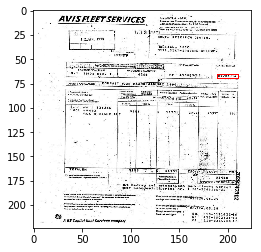

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747912.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 327 files and realized 0 errors


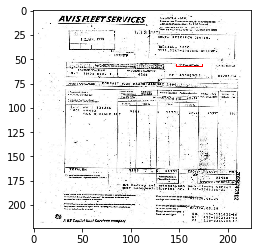

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747912.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 328 files and realized 0 errors


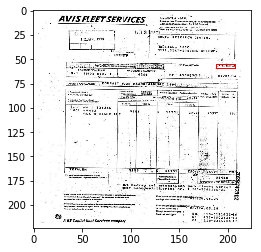

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747912.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 329 files and realized 0 errors


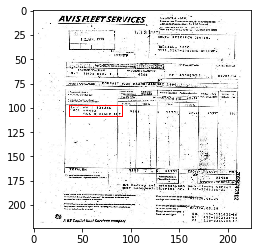

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747912.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 330 files and realized 0 errors


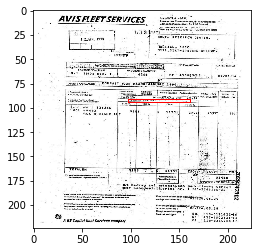

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747912.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 331 files and realized 0 errors


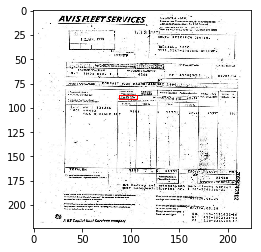

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747692.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 332 files and realized 0 errors


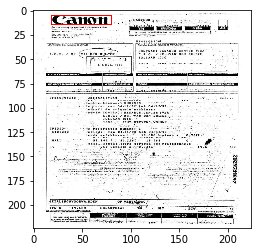

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747692.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 333 files and realized 0 errors


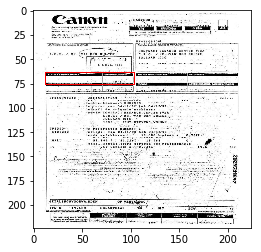

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747692.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 334 files and realized 0 errors


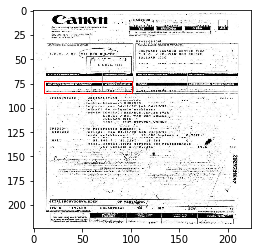

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747692.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 335 files and realized 0 errors


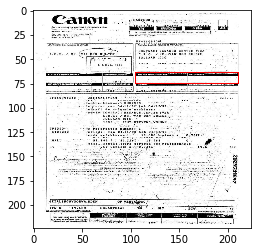

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747692.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 336 files and realized 0 errors


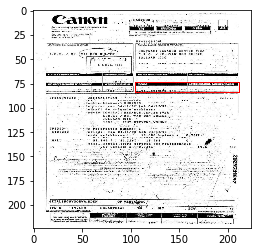

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747692.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 337 files and realized 0 errors


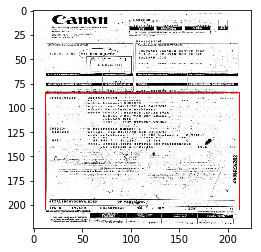

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747692.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 338 files and realized 0 errors


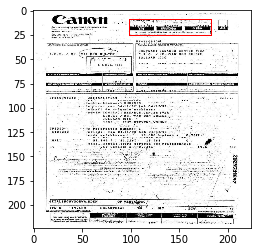

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747692.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 339 files and realized 0 errors


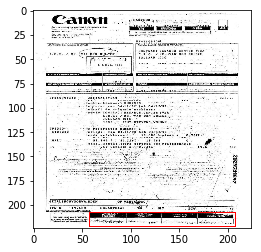

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747692.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 340 files and realized 0 errors


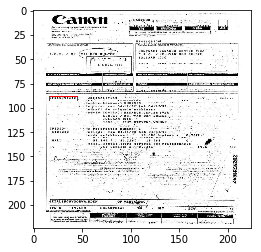

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747692.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 341 files and realized 0 errors


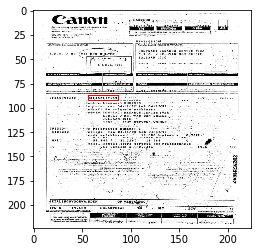

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747692.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 342 files and realized 0 errors


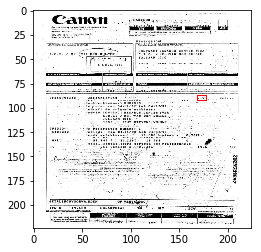

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747692.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 343 files and realized 0 errors


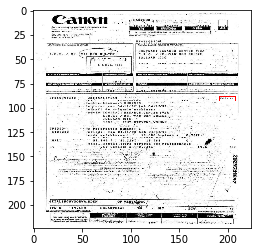

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747692.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 344 files and realized 0 errors


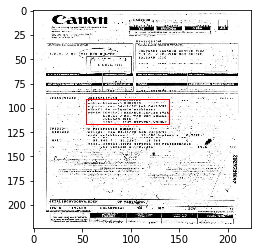

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747692.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 345 files and realized 0 errors


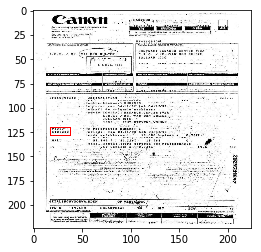

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747692.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 346 files and realized 0 errors


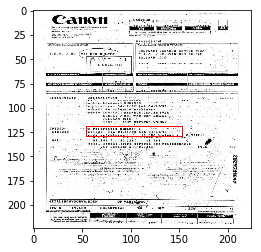

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747692.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 347 files and realized 0 errors


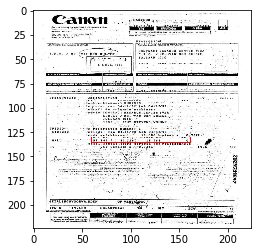

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747692.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 348 files and realized 0 errors


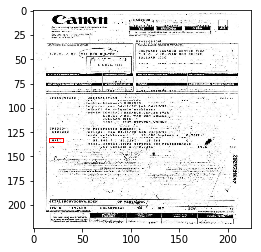

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747692.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 349 files and realized 0 errors


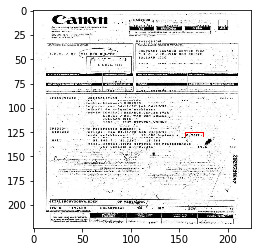

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747692.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 350 files and realized 0 errors


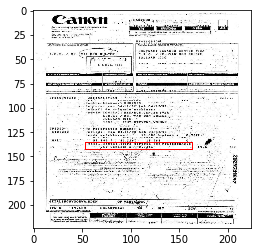

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747692.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 351 files and realized 0 errors


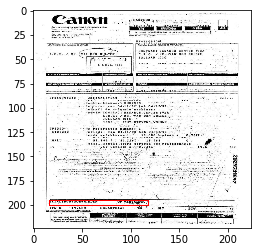

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747692.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 352 files and realized 0 errors


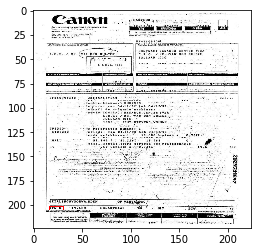

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747692.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 353 files and realized 0 errors


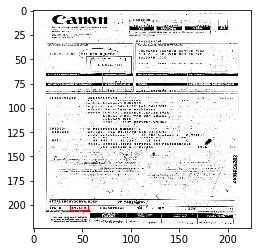

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747692.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 354 files and realized 0 errors


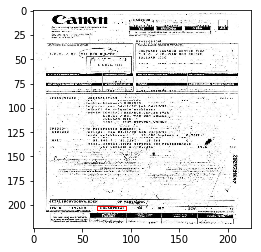

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747692.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 355 files and realized 0 errors


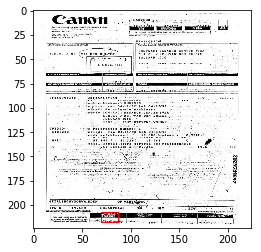

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747692.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 356 files and realized 0 errors


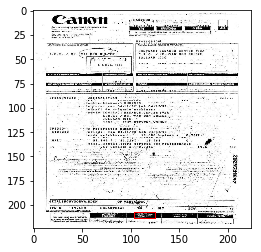

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747692.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 357 files and realized 0 errors


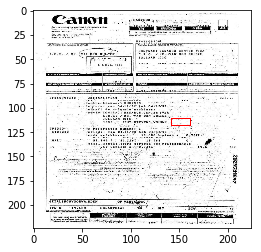

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747692.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 358 files and realized 0 errors


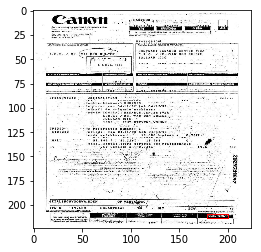

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747747_2028747748.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 359 files and realized 0 errors


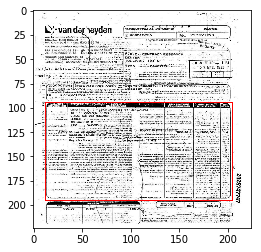

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747747_2028747748.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 360 files and realized 0 errors


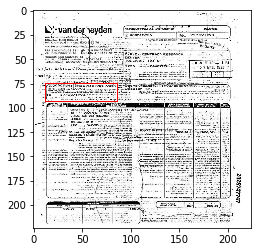

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747747_2028747748.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 361 files and realized 0 errors


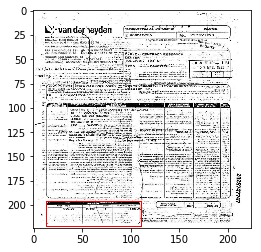

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747762.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 362 files and realized 0 errors


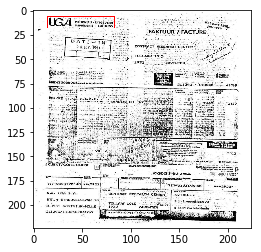

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747762.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 363 files and realized 0 errors


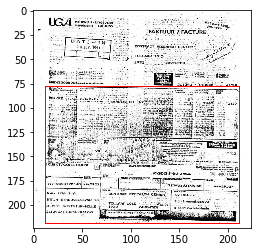

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747762.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 364 files and realized 0 errors


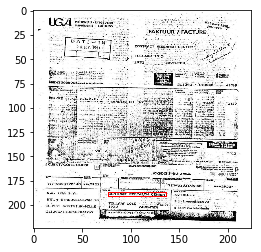

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747762.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 365 files and realized 0 errors


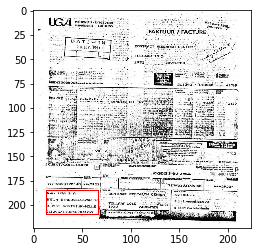

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747762.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 366 files and realized 0 errors


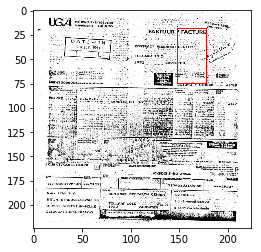

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747762.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 367 files and realized 0 errors


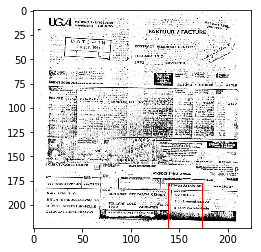

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747762.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 368 files and realized 0 errors


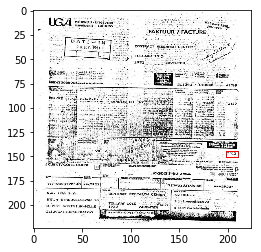

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747762.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 369 files and realized 0 errors


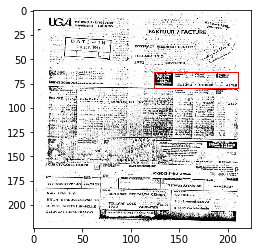

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747778_2028747779.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 370 files and realized 0 errors


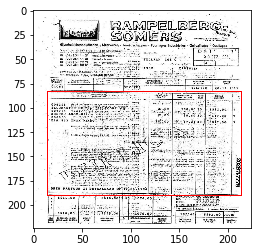

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747778_2028747779.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 371 files and realized 0 errors


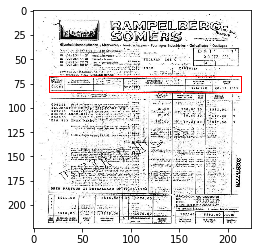

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747778_2028747779.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 372 files and realized 0 errors


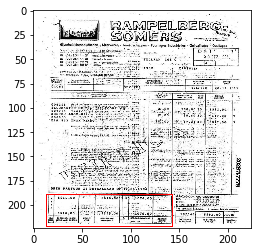

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747778_2028747779.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 373 files and realized 0 errors


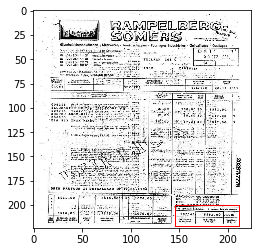

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747778_2028747779.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 374 files and realized 0 errors


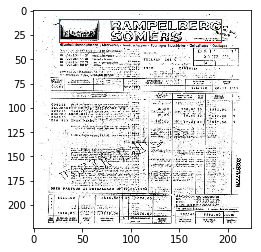

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747778_2028747779.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 375 files and realized 0 errors


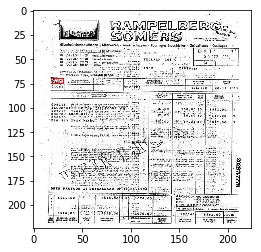

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747778_2028747779.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 376 files and realized 0 errors


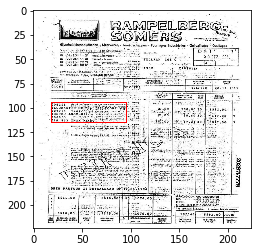

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747778_2028747779.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 377 files and realized 0 errors


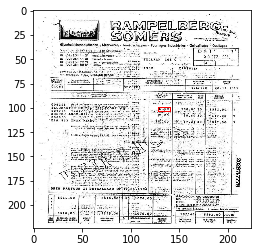

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747778_2028747779.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 378 files and realized 0 errors


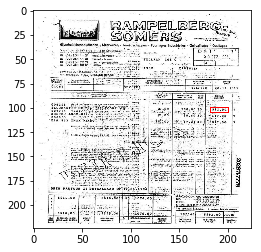

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747778_2028747779.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 379 files and realized 0 errors


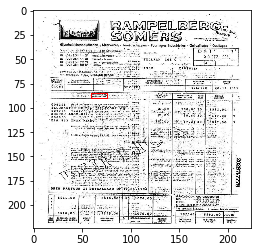

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747778_2028747779.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 380 files and realized 0 errors


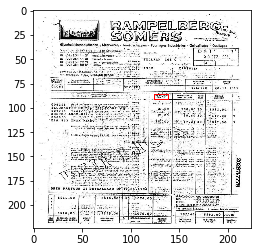

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747778_2028747779.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 381 files and realized 0 errors


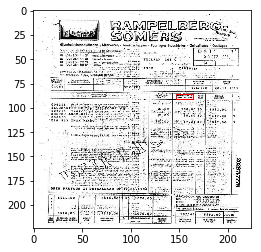

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747778_2028747779.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 382 files and realized 0 errors


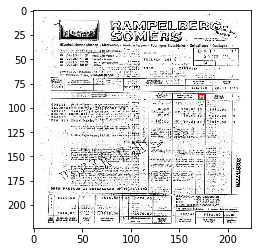

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747778_2028747779.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 383 files and realized 0 errors


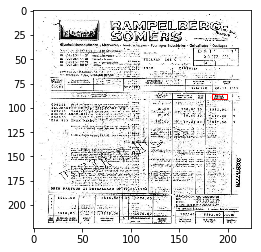

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2028747778_2028747779.jpg
(1000, 777, 3)
0.2882882882882883 0.224
(224, 224, 3)
Reseized one image done
Checked 384 files and realized 0 errors


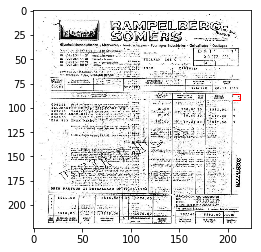

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000308007.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 385 files and realized 0 errors


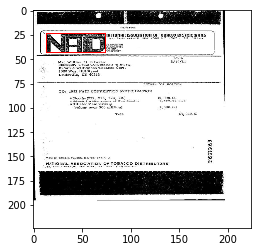

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000308007.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 386 files and realized 0 errors


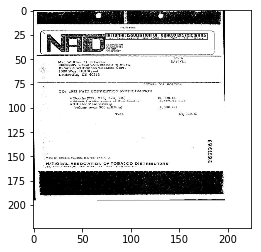

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000308007.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 387 files and realized 0 errors


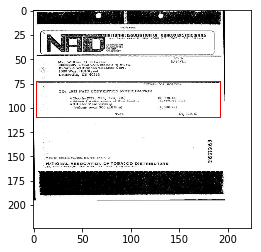

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000308007.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 388 files and realized 0 errors


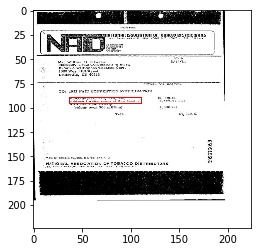

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000173065.jpg
(1000, 767, 3)
0.2920469361147327 0.224
(224, 224, 3)
Reseized one image done
Checked 389 files and realized 0 errors


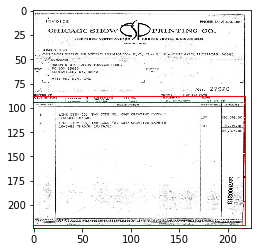

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000173065.jpg
(1000, 767, 3)
0.2920469361147327 0.224
(224, 224, 3)
Reseized one image done
Checked 390 files and realized 0 errors


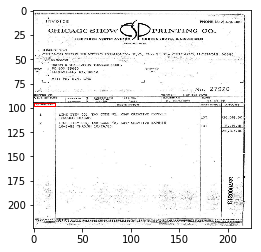

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000173065.jpg
(1000, 767, 3)
0.2920469361147327 0.224
(224, 224, 3)
Reseized one image done
Checked 391 files and realized 0 errors


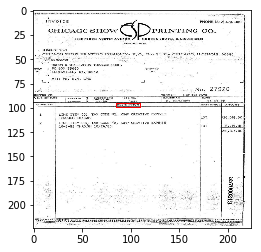

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000173065.jpg
(1000, 767, 3)
0.2920469361147327 0.224
(224, 224, 3)
Reseized one image done
Checked 392 files and realized 0 errors


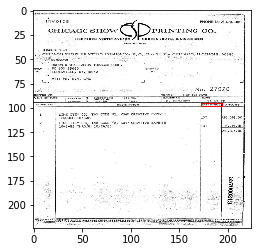

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000173065.jpg
(1000, 767, 3)
0.2920469361147327 0.224
(224, 224, 3)
Reseized one image done
Checked 393 files and realized 0 errors


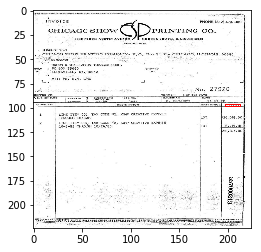

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000173065.jpg
(1000, 767, 3)
0.2920469361147327 0.224
(224, 224, 3)
Reseized one image done
Checked 394 files and realized 0 errors


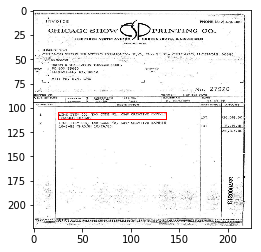

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000173065.jpg
(1000, 767, 3)
0.2920469361147327 0.224
(224, 224, 3)
Reseized one image done
Checked 395 files and realized 0 errors


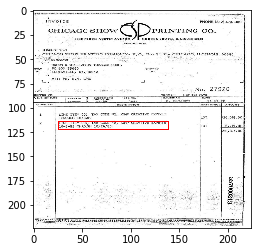

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000173065.jpg
(1000, 767, 3)
0.2920469361147327 0.224
(224, 224, 3)
Reseized one image done
Checked 396 files and realized 0 errors


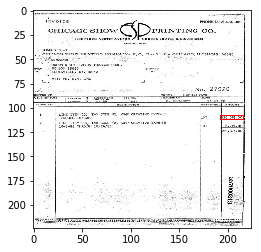

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000173065.jpg
(1000, 767, 3)
0.2920469361147327 0.224
(224, 224, 3)
Reseized one image done
Checked 397 files and realized 0 errors


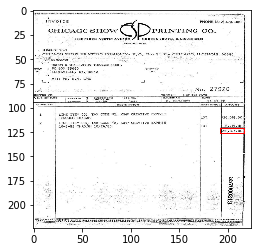

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000173065.jpg
(1000, 767, 3)
0.2920469361147327 0.224
(224, 224, 3)
Reseized one image done
Checked 398 files and realized 0 errors


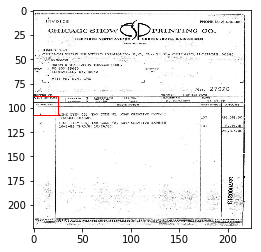

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226470.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 399 files and realized 0 errors


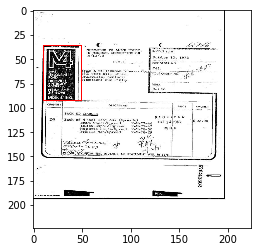

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226470.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 400 files and realized 0 errors


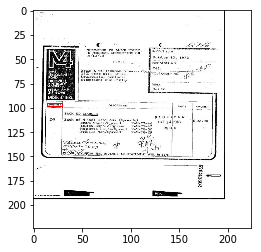

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226470.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 401 files and realized 0 errors


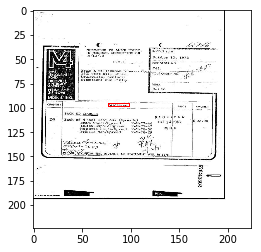

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226470.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 402 files and realized 0 errors


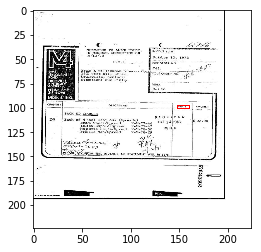

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226470.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 403 files and realized 0 errors


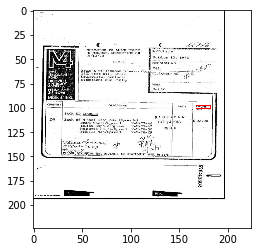

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226470.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 404 files and realized 0 errors


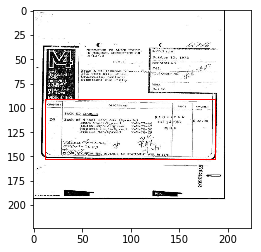

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226477.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 405 files and realized 0 errors


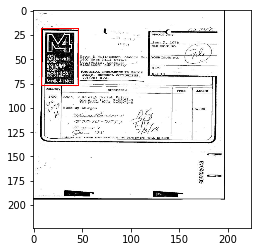

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226477.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 406 files and realized 0 errors


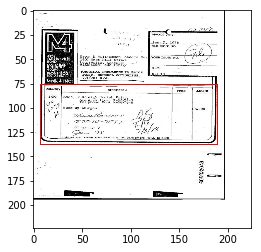

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226477.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 407 files and realized 0 errors


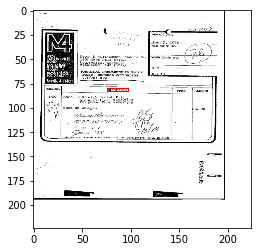

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226477.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 408 files and realized 0 errors


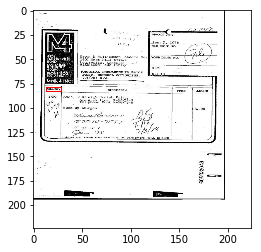

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226477.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 409 files and realized 0 errors


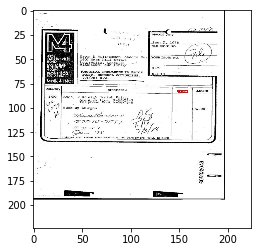

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226477.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 410 files and realized 0 errors


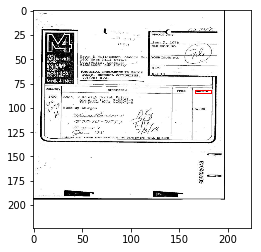

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226477.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 411 files and realized 0 errors


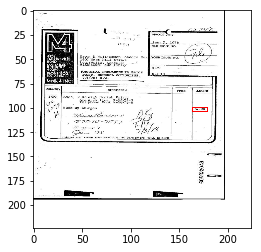

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226477.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 412 files and realized 0 errors


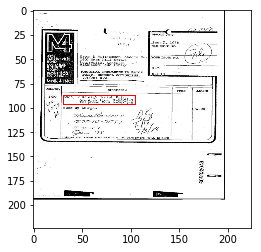

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226477.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 413 files and realized 0 errors


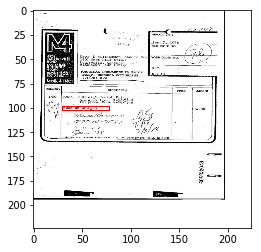

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226480.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 414 files and realized 0 errors


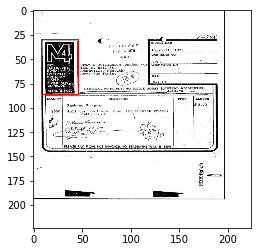

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226480.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 415 files and realized 0 errors


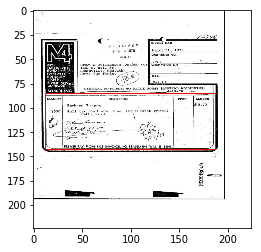

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226480.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 416 files and realized 0 errors


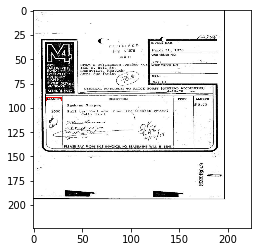

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226480.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 417 files and realized 0 errors


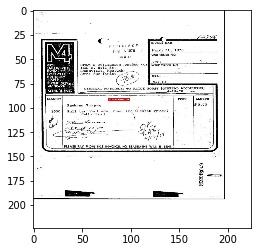

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226480.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 418 files and realized 0 errors


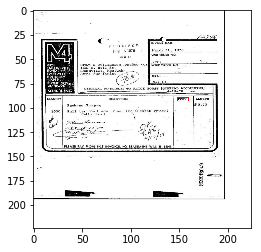

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226480.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 419 files and realized 0 errors


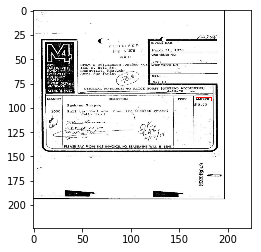

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226480.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 420 files and realized 0 errors


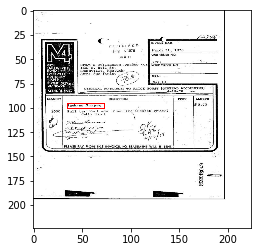

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226480.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 421 files and realized 0 errors


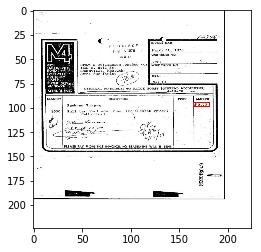

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226480.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 422 files and realized 0 errors


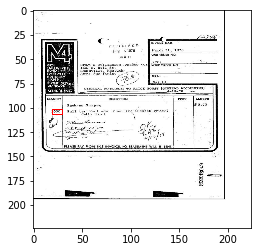

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226480.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 423 files and realized 0 errors


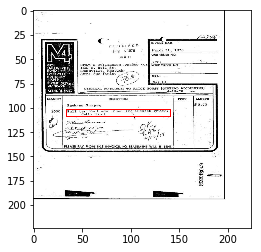

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226483.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 424 files and realized 0 errors


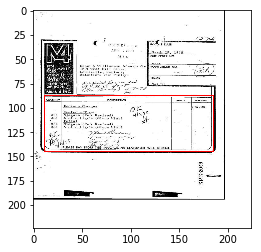

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226483.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 425 files and realized 0 errors


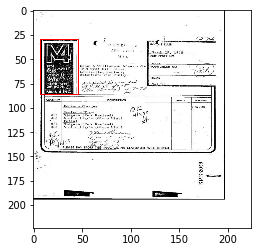

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226483.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 426 files and realized 0 errors


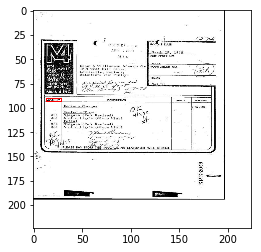

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226483.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 427 files and realized 0 errors


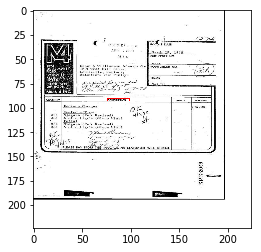

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226483.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 428 files and realized 0 errors


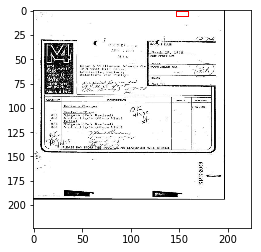

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226483.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 429 files and realized 0 errors


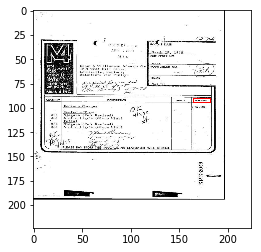

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226483.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 430 files and realized 0 errors


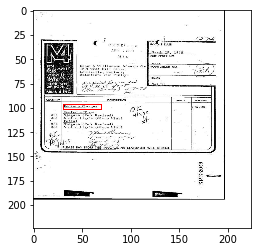

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226483.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 431 files and realized 0 errors


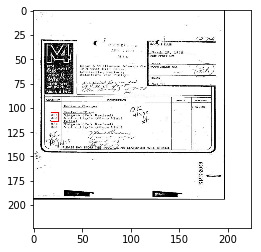

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226483.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 432 files and realized 0 errors


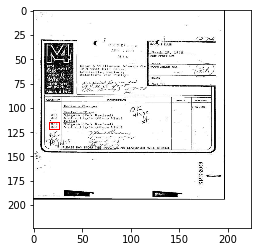

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226483.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 433 files and realized 0 errors


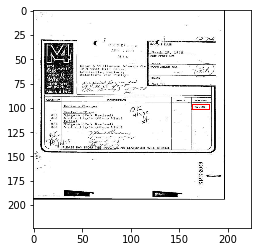

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226483.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 434 files and realized 0 errors


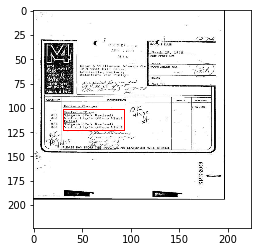

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226486.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 435 files and realized 0 errors


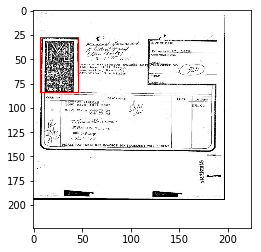

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226486.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 436 files and realized 0 errors


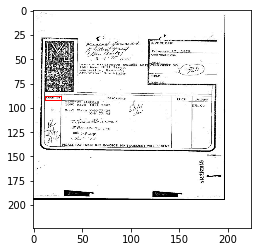

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226486.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 437 files and realized 0 errors


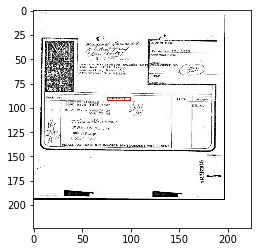

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226486.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 438 files and realized 0 errors


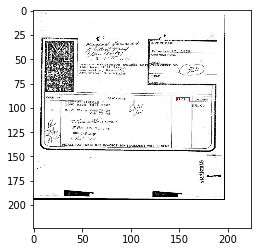

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226486.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 439 files and realized 0 errors


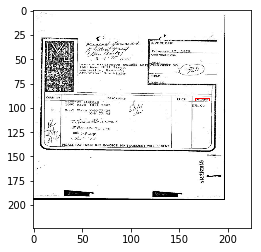

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226486.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 440 files and realized 0 errors


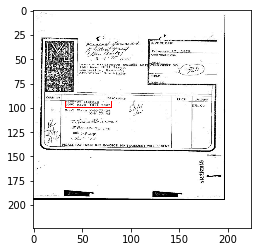

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226486.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 441 files and realized 0 errors


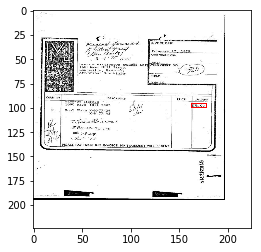

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226486.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 442 files and realized 0 errors


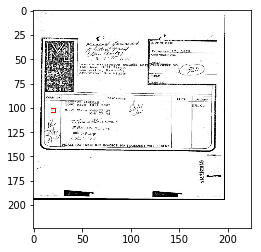

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226486.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 443 files and realized 0 errors


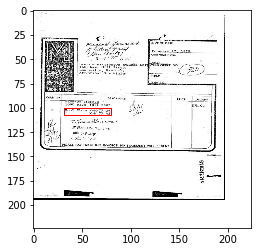

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226488.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 444 files and realized 0 errors


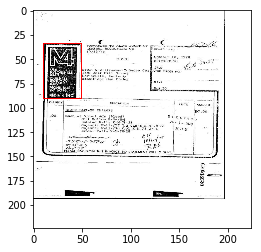

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226488.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 445 files and realized 0 errors


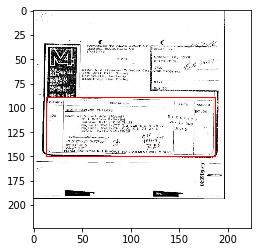

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226488.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 446 files and realized 0 errors


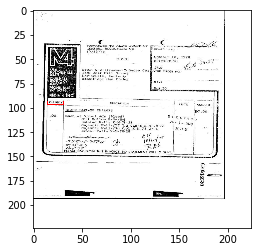

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226488.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 447 files and realized 0 errors


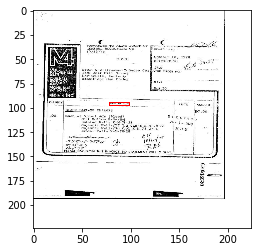

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226488.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 448 files and realized 0 errors


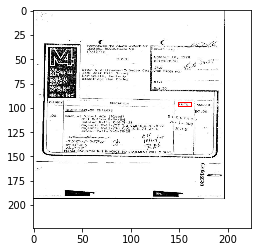

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226488.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 449 files and realized 0 errors


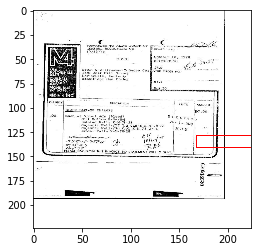

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226488.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 450 files and realized 0 errors


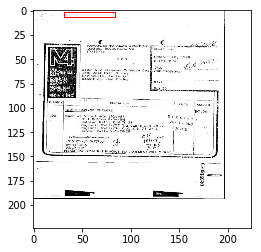

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226488.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 451 files and realized 0 errors


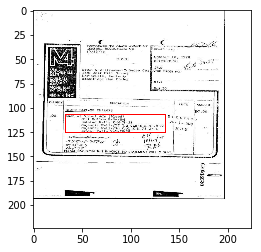

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0000226488.jpg
(1000, 762, 3)
0.29396325459317585 0.224
(224, 224, 3)
Reseized one image done
Checked 452 files and realized 0 errors


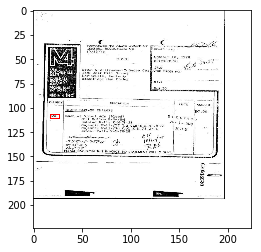

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0101_003.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 453 files and realized 0 errors


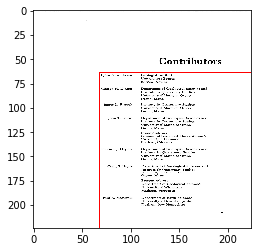

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0110_099.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 454 files and realized 0 errors


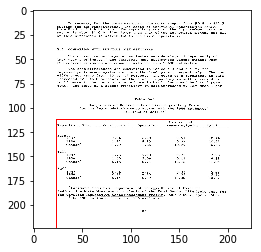

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0113_013.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 455 files and realized 0 errors


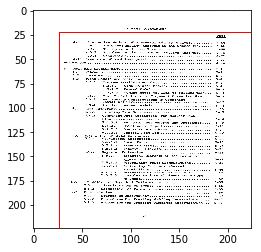

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0140_007.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 456 files and realized 0 errors


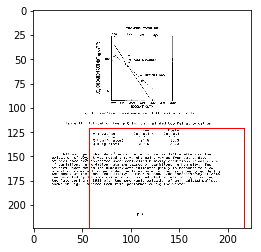

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0146_281.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 457 files and realized 0 errors


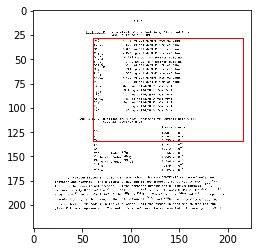

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0146_281.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 458 files and realized 0 errors


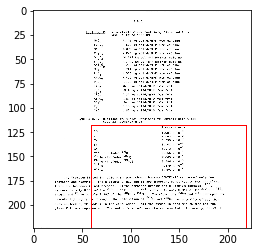

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0147_090.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 459 files and realized 0 errors


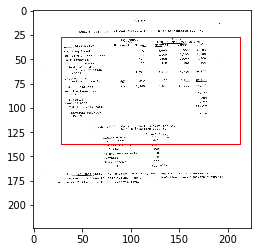

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0147_090.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 460 files and realized 0 errors


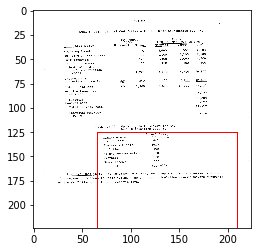

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0147_125.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 461 files and realized 0 errors


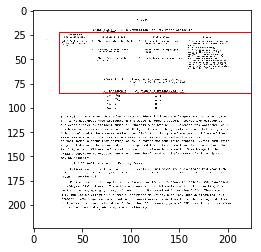

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0147_125.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 462 files and realized 0 errors


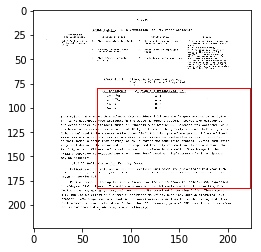

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0147_256.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 463 files and realized 0 errors


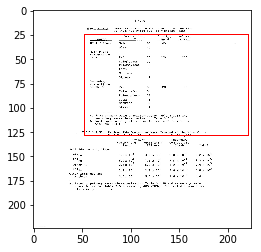

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0147_256.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 464 files and realized 0 errors


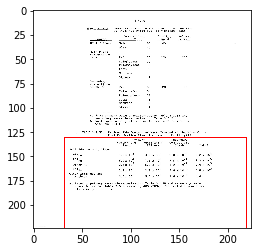

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0148_271.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 465 files and realized 0 errors


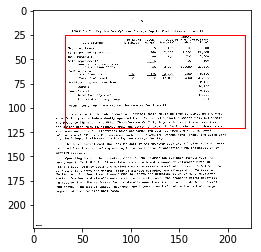

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0148_479.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 466 files and realized 0 errors


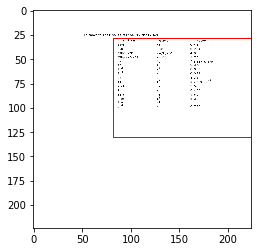

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0151_180.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 467 files and realized 0 errors


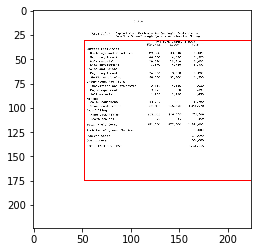

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0151_208.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 468 files and realized 0 errors


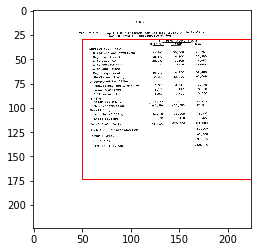

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0154_080.jpg
(2550, 3312, 3)
0.06763285024154589 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 469 files and realized 0 errors


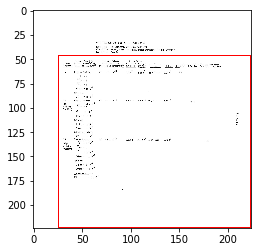

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0154_474.jpg
(2550, 3312, 3)
0.06763285024154589 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 470 files and realized 0 errors


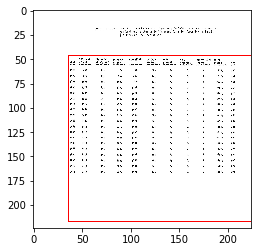

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0155_081.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 471 files and realized 0 errors


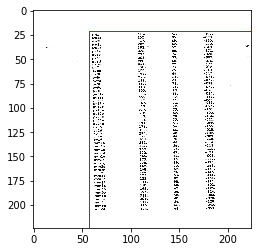

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0199_384.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 472 files and realized 0 errors


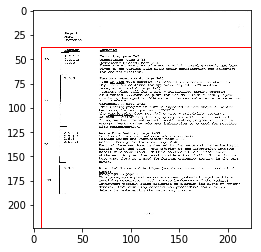

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0203_075.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 473 files and realized 0 errors


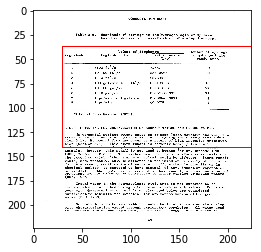

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0206_007.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 474 files and realized 0 errors


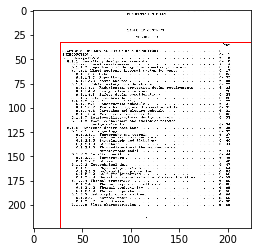

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0206_048.jpg
(2550, 3312, 3)
0.06763285024154589 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 475 files and realized 0 errors


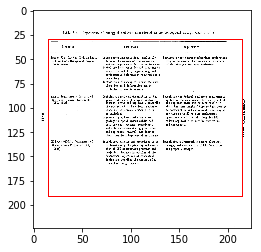

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0207_025.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 476 files and realized 0 errors


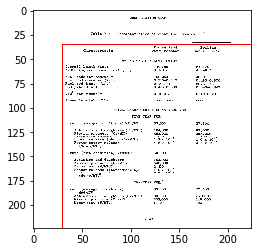

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0209_207.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 477 files and realized 0 errors


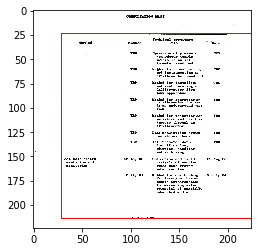

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0210_111.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 478 files and realized 0 errors


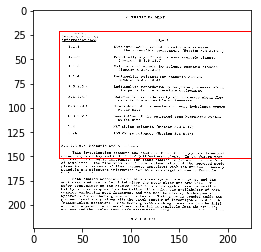

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0212_175.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 479 files and realized 0 errors


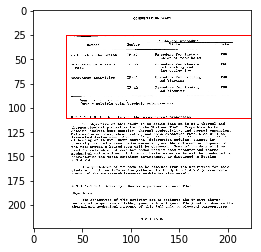

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0219_043.jpg
(2550, 3312, 3)
0.06763285024154589 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 480 files and realized 0 errors


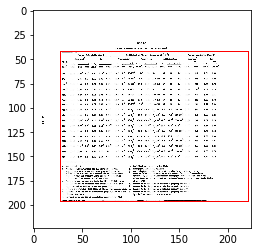

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0220_030.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 481 files and realized 0 errors


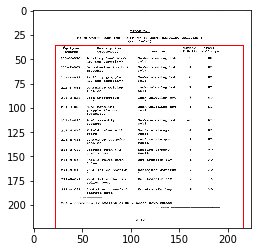

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0223_017.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 482 files and realized 0 errors


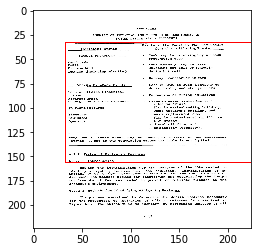

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0626_005.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 483 files and realized 0 errors


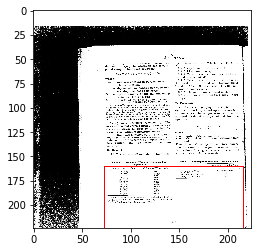

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0626_005.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 484 files and realized 0 errors


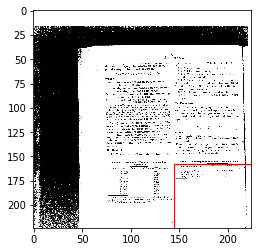

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0651_008.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 485 files and realized 0 errors


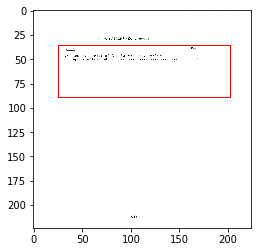

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0651_013.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 486 files and realized 0 errors


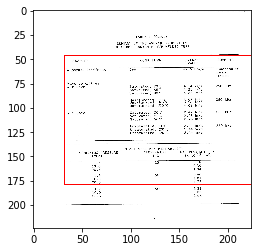

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0651_013.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 487 files and realized 0 errors


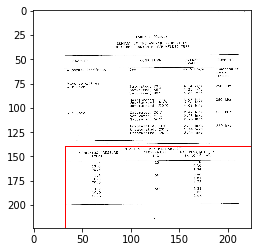

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0667_005.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 488 files and realized 0 errors


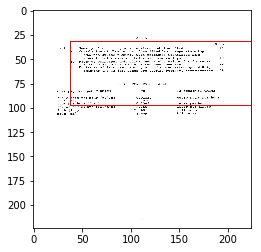

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0667_005.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 489 files and realized 0 errors


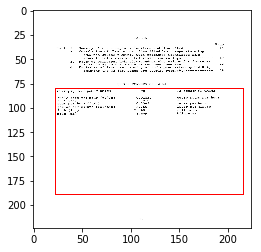

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0672_278.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 490 files and realized 0 errors


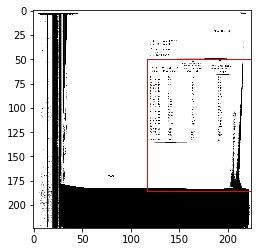

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0672_356.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 491 files and realized 0 errors


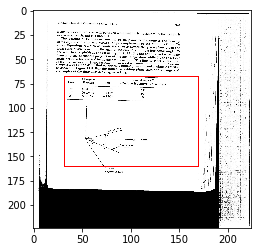

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0685_048.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 492 files and realized 0 errors


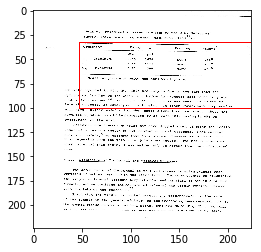

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0717_023.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 493 files and realized 0 errors


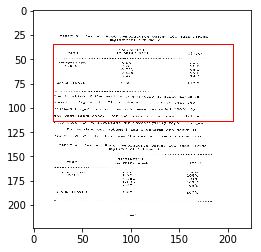

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0717_023.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 494 files and realized 0 errors


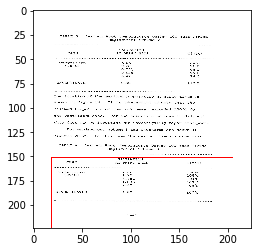

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0725_043.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 495 files and realized 0 errors


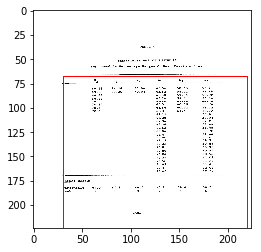

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0765_005.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 496 files and realized 0 errors


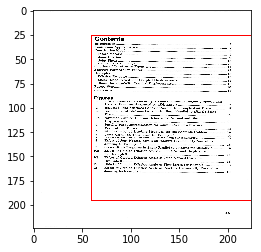

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1012_041.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 497 files and realized 0 errors


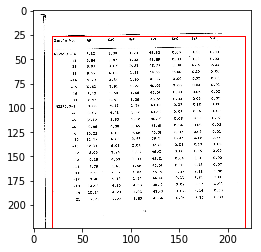

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1040_032.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 498 files and realized 0 errors


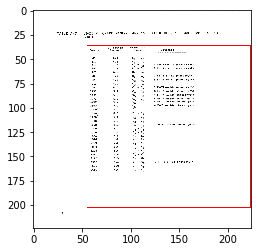

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1060_146.jpg
(2544, 3312, 3)
0.06763285024154589 0.0880503144654088
(224, 224, 3)
Reseized one image done
Checked 499 files and realized 0 errors


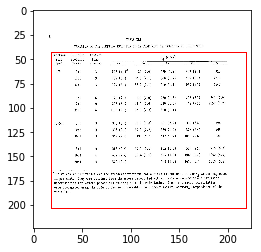

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1060_195.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 500 files and realized 0 errors


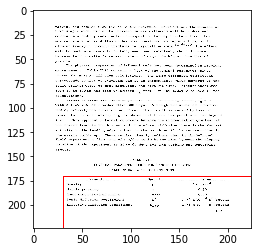

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1060_223.jpg
(2544, 3312, 3)
0.06763285024154589 0.0880503144654088
(224, 224, 3)
Reseized one image done
Checked 501 files and realized 0 errors


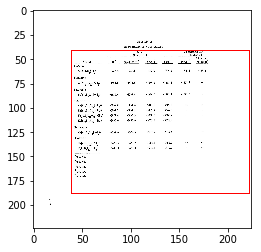

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1063_086.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 502 files and realized 0 errors


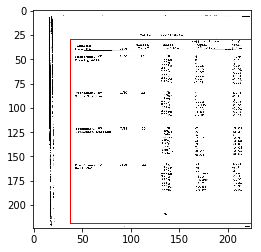

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1078_082.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 503 files and realized 0 errors


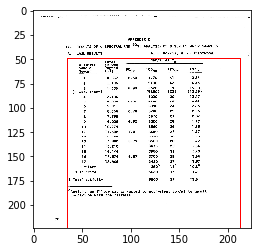

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1079_023.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 504 files and realized 0 errors


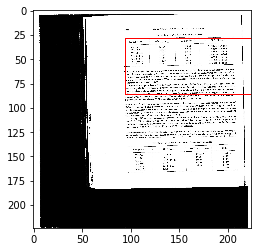

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1079_023.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 505 files and realized 0 errors


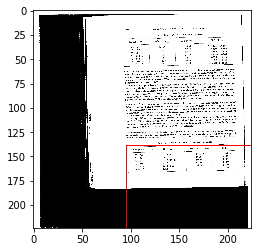

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1112_023.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 506 files and realized 0 errors


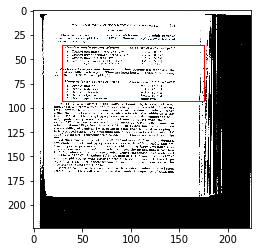

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1112_023.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 507 files and realized 0 errors


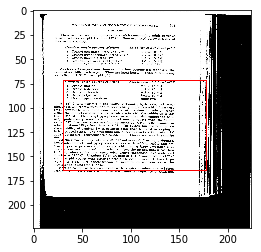

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1124_024.jpg
(2544, 3312, 3)
0.06763285024154589 0.0880503144654088
(224, 224, 3)
Reseized one image done
Checked 508 files and realized 0 errors


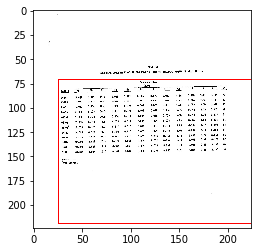

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1124_039.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 509 files and realized 0 errors


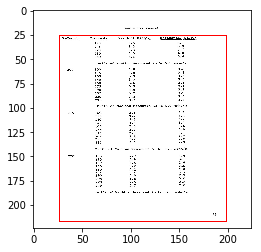

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1132_108.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 510 files and realized 0 errors


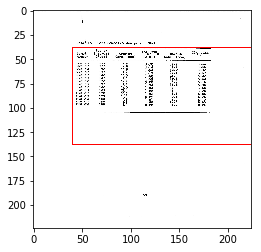

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1156_004.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 511 files and realized 0 errors


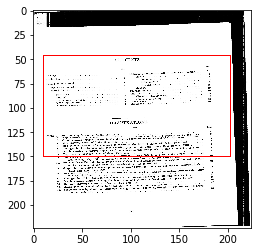

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1156_004.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 512 files and realized 0 errors


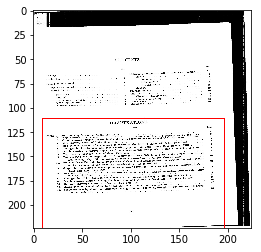

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1164_010.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 513 files and realized 0 errors


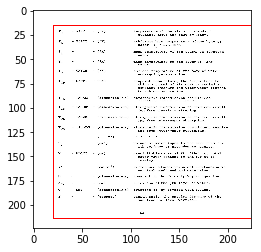

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1175_032.jpg
(2550, 3312, 3)
0.06763285024154589 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 514 files and realized 0 errors


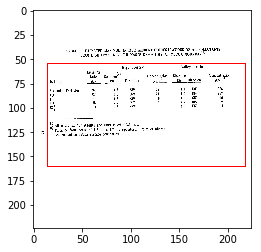

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1194_021.jpg
(2550, 3312, 3)
0.06763285024154589 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 515 files and realized 0 errors


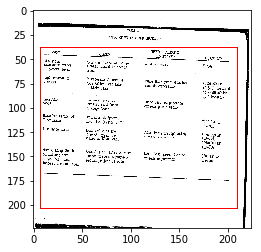

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1201_273.jpg
(2550, 3312, 3)
0.06763285024154589 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 516 files and realized 0 errors


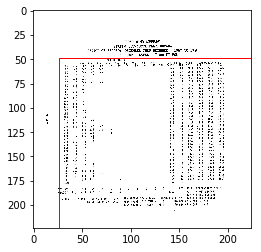

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1201_293.jpg
(2550, 3312, 3)
0.06763285024154589 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 517 files and realized 0 errors


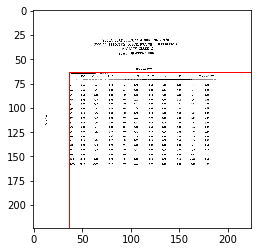

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1238_006.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 518 files and realized 0 errors


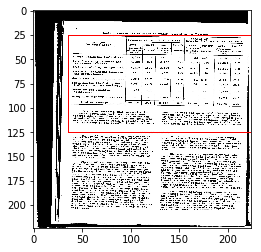

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1249_072.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 519 files and realized 0 errors


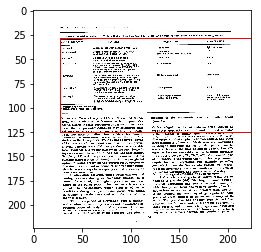

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1289_014.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 520 files and realized 0 errors


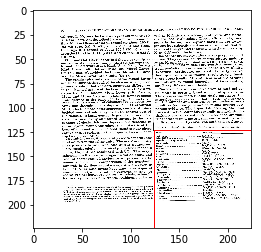

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1295_064.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 521 files and realized 0 errors


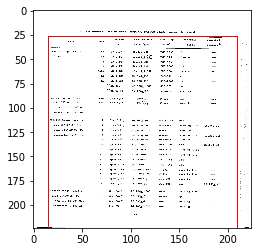

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1339_086.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 522 files and realized 0 errors


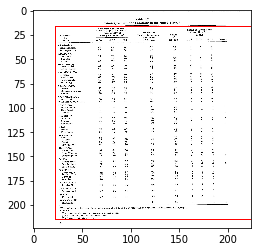

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1343_073.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 523 files and realized 0 errors


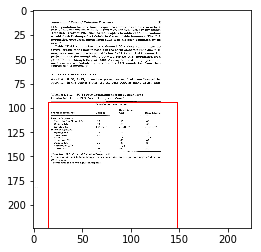

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1353_032.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 524 files and realized 0 errors


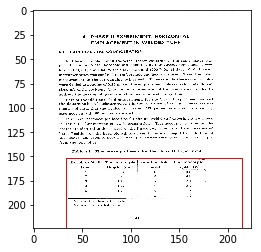

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1356_083.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 525 files and realized 0 errors


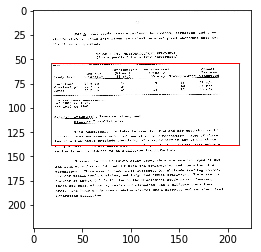

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1356_119.jpg
(2550, 3312, 3)
0.06763285024154589 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 526 files and realized 0 errors


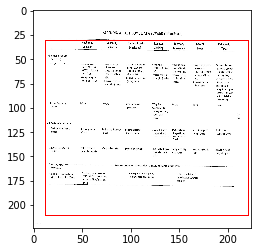

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1360_074.jpg
(2544, 3312, 3)
0.06763285024154589 0.0880503144654088
(224, 224, 3)
Reseized one image done
Checked 527 files and realized 0 errors


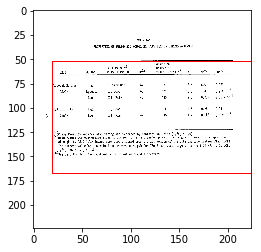

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1368_074.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 528 files and realized 0 errors


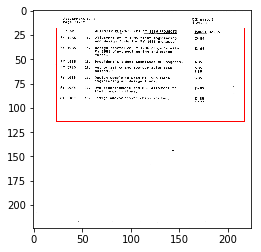

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1384_058.jpg
(2550, 3312, 3)
0.06763285024154589 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 529 files and realized 0 errors


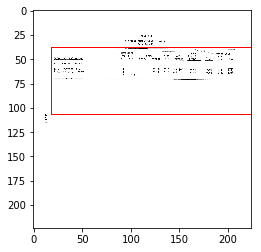

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1384_097.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 530 files and realized 0 errors


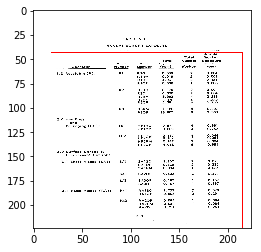

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1412_006.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 531 files and realized 0 errors


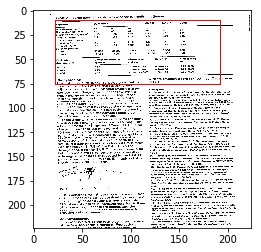

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0203_207.jpg
(2550, 3312, 3)
0.06763285024154589 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 532 files and realized 0 errors


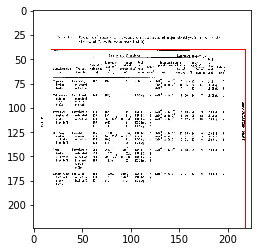

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/0725_026.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 533 files and realized 0 errors


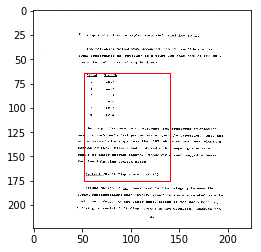

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1176_003.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 534 files and realized 0 errors


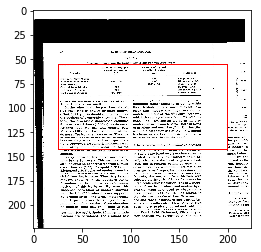

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1415_048.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 535 files and realized 0 errors


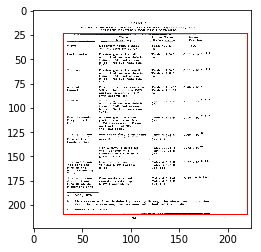

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1634_022.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 536 files and realized 0 errors


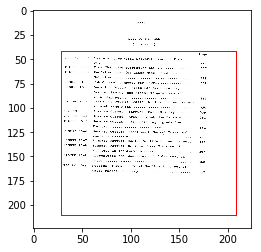

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1719_007.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 537 files and realized 0 errors


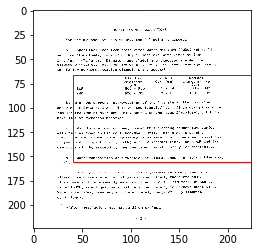

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1901_029.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 538 files and realized 0 errors


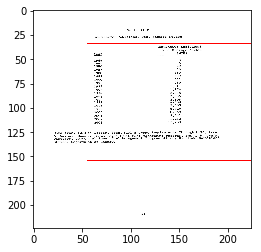

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5001_024.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 539 files and realized 0 errors


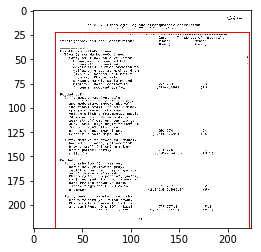

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5171_016.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 540 files and realized 0 errors


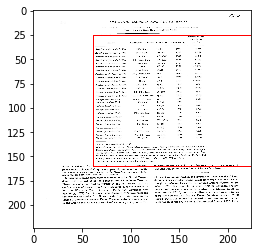

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5373_008.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 541 files and realized 0 errors


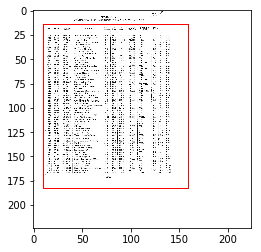

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5611_010.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 542 files and realized 0 errors


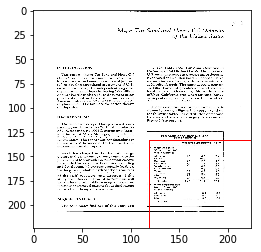

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5727_105.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 543 files and realized 0 errors


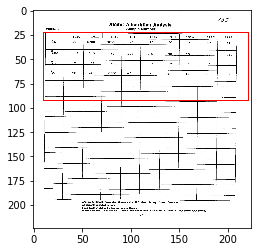

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5921_071.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 544 files and realized 0 errors


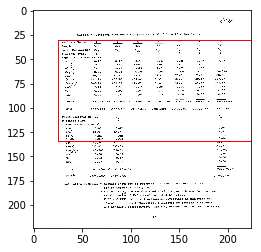

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5921_071.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 545 files and realized 0 errors


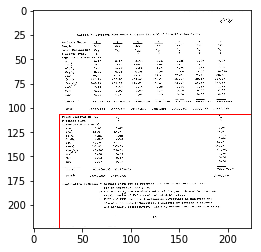

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/6504_018.jpg
(2544, 3312, 3)
0.06763285024154589 0.0880503144654088
(224, 224, 3)
Reseized one image done
Checked 546 files and realized 0 errors


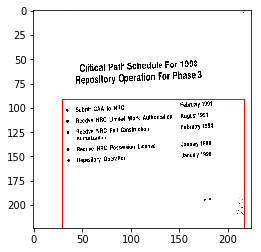

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/8013_494.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 547 files and realized 0 errors


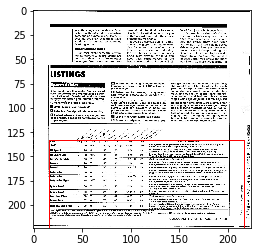

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9503_031.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 548 files and realized 0 errors


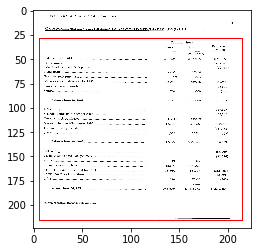

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9514_049.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 549 files and realized 0 errors


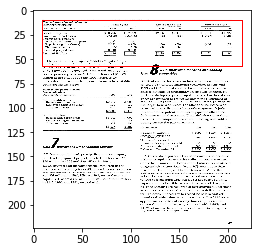

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9514_049.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 550 files and realized 0 errors


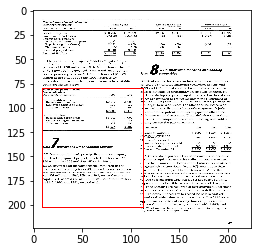

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9514_049.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 551 files and realized 0 errors


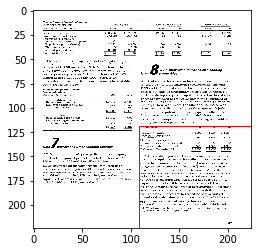

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9523_038.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 552 files and realized 0 errors


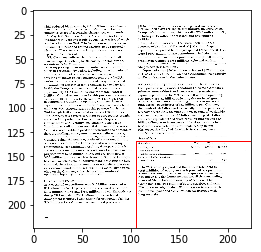

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9534_058.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 553 files and realized 0 errors


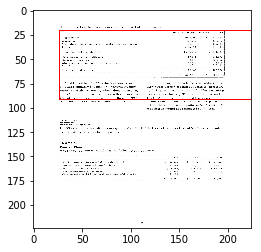

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9534_058.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 554 files and realized 0 errors


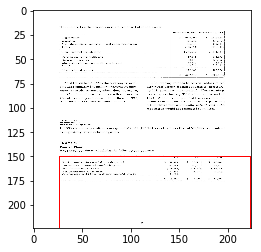

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9548_031.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 555 files and realized 0 errors


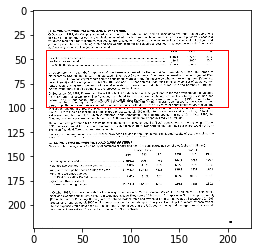

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9548_031.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 556 files and realized 0 errors


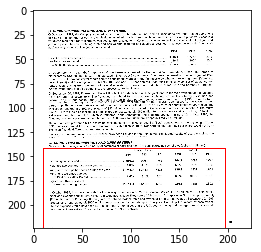

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9560_036.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 557 files and realized 0 errors


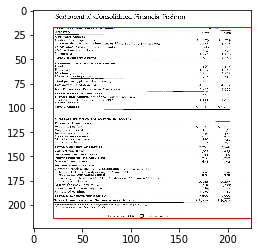

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1445_046.jpg
(2550, 3312, 3)
0.06763285024154589 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 558 files and realized 0 errors


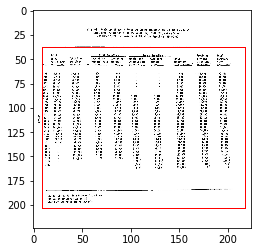

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1464_021.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 559 files and realized 0 errors


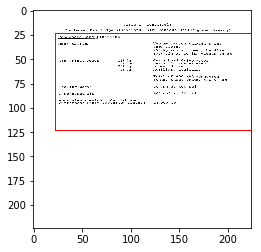

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1484_028.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 560 files and realized 0 errors


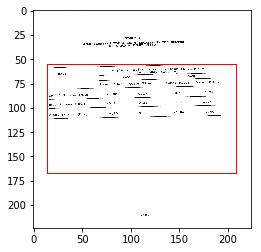

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1486_156.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 561 files and realized 0 errors


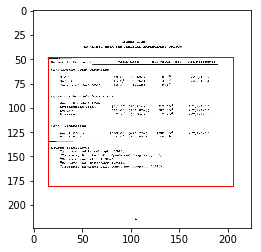

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1495_021.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 562 files and realized 0 errors


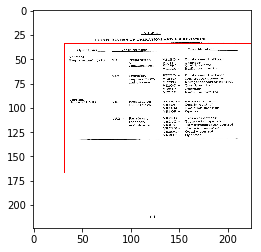

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1539_012.jpg
(2544, 3312, 3)
0.06763285024154589 0.0880503144654088
(224, 224, 3)
Reseized one image done
Checked 563 files and realized 0 errors


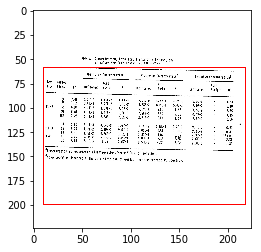

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1550_007.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 564 files and realized 0 errors


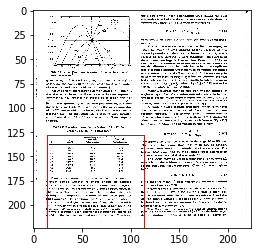

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1551_123.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 565 files and realized 0 errors


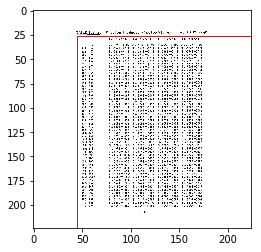

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1551_152.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 566 files and realized 0 errors


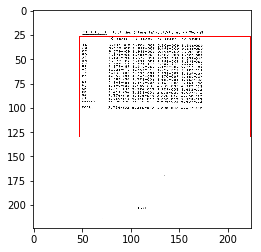

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1552_032.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 567 files and realized 0 errors


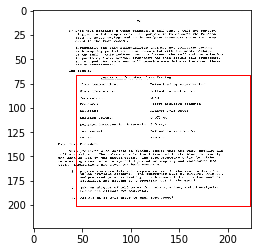

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1553_021.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 568 files and realized 0 errors


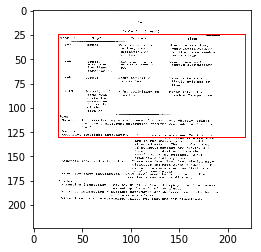

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1556_004.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 569 files and realized 0 errors


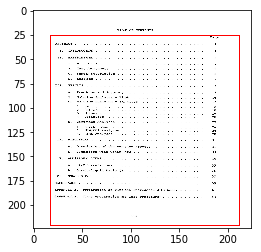

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1556_006.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 570 files and realized 0 errors


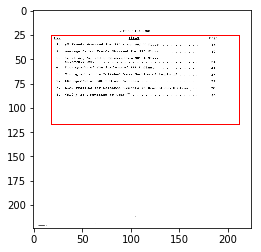

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1558_040.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 571 files and realized 0 errors


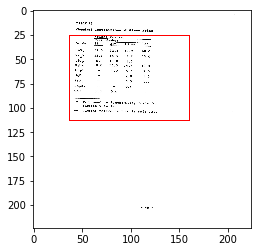

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1580_295.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 572 files and realized 0 errors


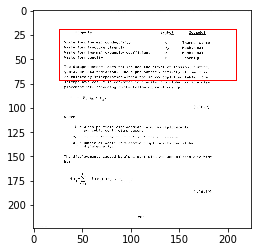

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1589_015.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 573 files and realized 0 errors


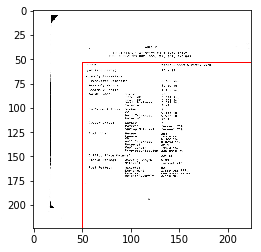

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1624_063.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 574 files and realized 0 errors


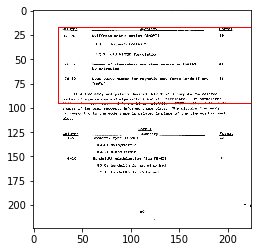

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1624_063.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 575 files and realized 0 errors


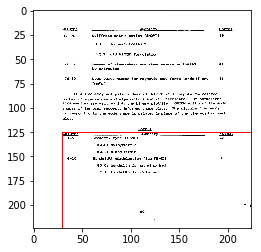

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1634_330.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 576 files and realized 0 errors


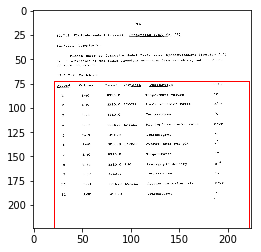

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1634_335.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 577 files and realized 0 errors


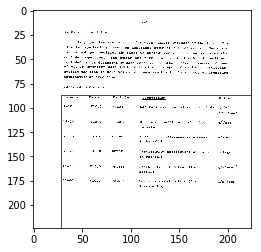

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1654_004.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 578 files and realized 0 errors


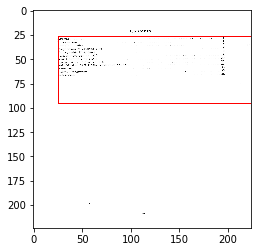

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1662_034.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 579 files and realized 0 errors


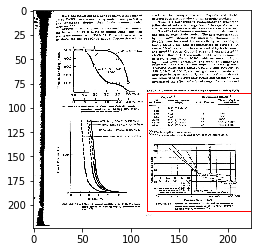

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1662_053.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 580 files and realized 0 errors


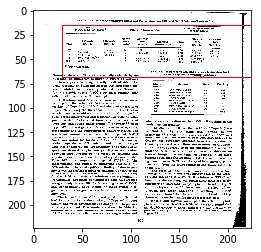

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1662_053.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 581 files and realized 0 errors


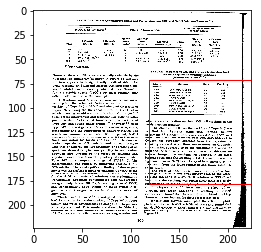

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1662_085.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 582 files and realized 0 errors


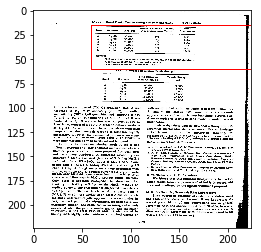

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1662_085.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 583 files and realized 0 errors


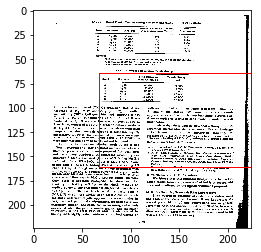

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1665_133.jpg
(2550, 3312, 3)
0.06763285024154589 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 584 files and realized 0 errors


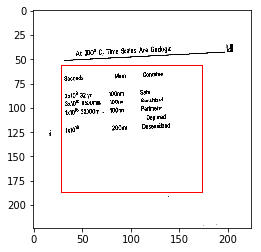

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1672_069.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 585 files and realized 0 errors


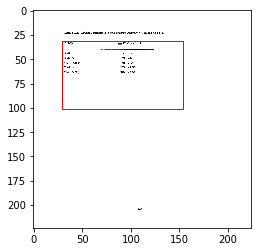

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1674_088.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 586 files and realized 0 errors


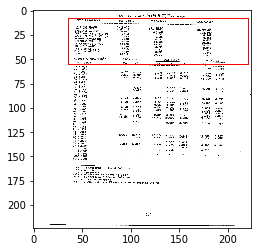

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1674_088.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 587 files and realized 0 errors


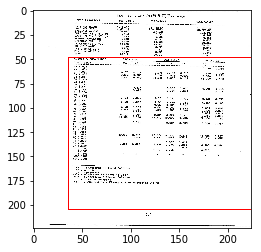

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1674_138.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 588 files and realized 0 errors


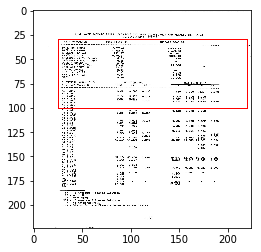

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1674_138.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 589 files and realized 0 errors


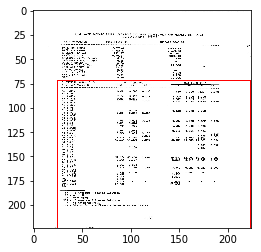

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1675_199.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 590 files and realized 0 errors


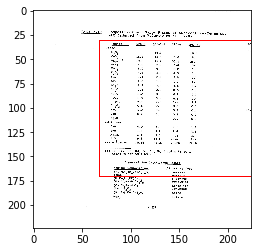

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1675_199.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 591 files and realized 0 errors


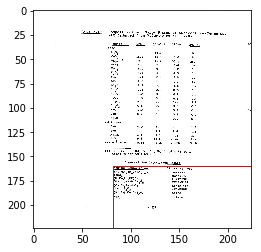

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1675_209.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 592 files and realized 0 errors


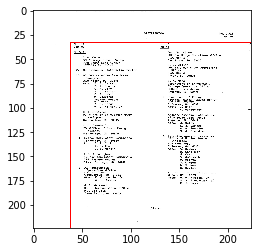

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1676_008.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 593 files and realized 0 errors


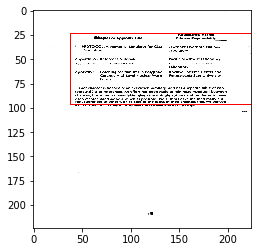

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1676_356.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 594 files and realized 0 errors


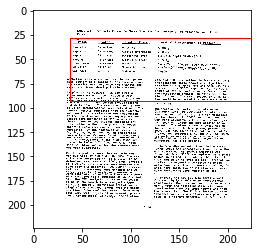

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1696_204.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 595 files and realized 0 errors


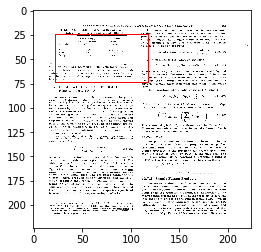

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1696_302.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 596 files and realized 0 errors


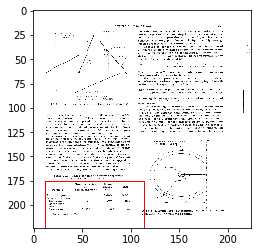

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1717_086.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 597 files and realized 0 errors


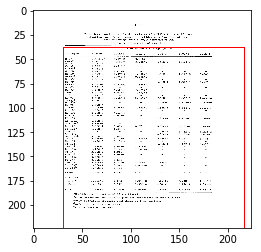

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1723_194.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 598 files and realized 0 errors


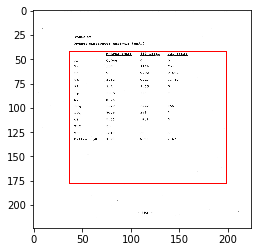

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1723_250.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 599 files and realized 0 errors


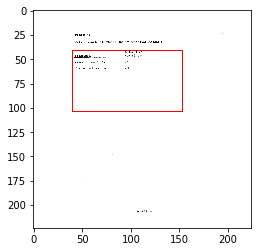

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1740_002.jpg
(2550, 3312, 3)
0.06763285024154589 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 600 files and realized 0 errors


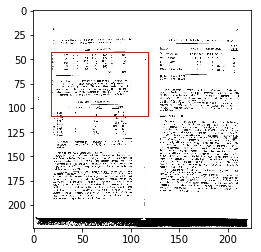

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1740_002.jpg
(2550, 3312, 3)
0.06763285024154589 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 601 files and realized 0 errors


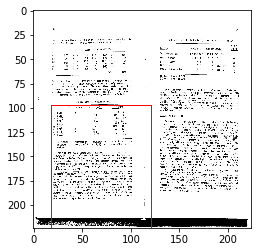

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1740_002.jpg
(2550, 3312, 3)
0.06763285024154589 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 602 files and realized 0 errors


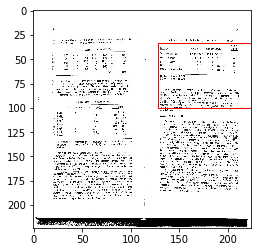

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1742_157.jpg
(2544, 3312, 3)
0.06763285024154589 0.0880503144654088
(224, 224, 3)
Reseized one image done
Checked 603 files and realized 0 errors


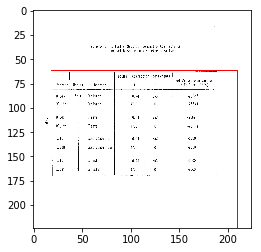

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1777_016.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 604 files and realized 0 errors


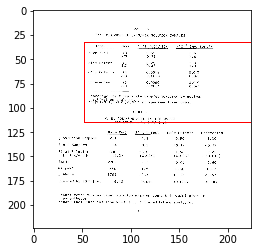

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1777_016.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 605 files and realized 0 errors


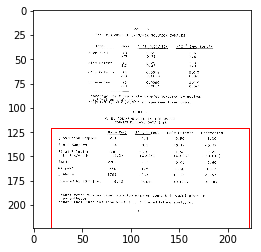

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1786_032.jpg
(2544, 3312, 3)
0.06763285024154589 0.0880503144654088
(224, 224, 3)
Reseized one image done
Checked 606 files and realized 0 errors


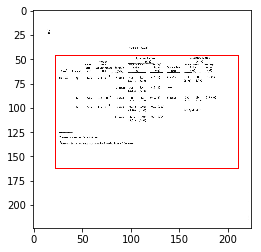

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1788_011.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 607 files and realized 0 errors


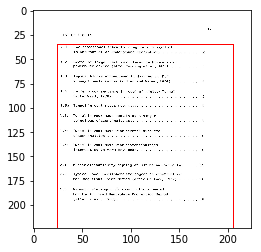

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1796_095.jpg
(2544, 3312, 3)
0.06763285024154589 0.0880503144654088
(224, 224, 3)
Reseized one image done
Checked 608 files and realized 0 errors


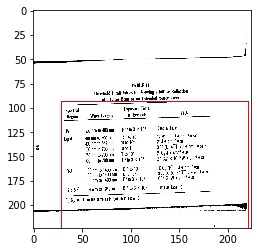

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1813_081.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 609 files and realized 0 errors


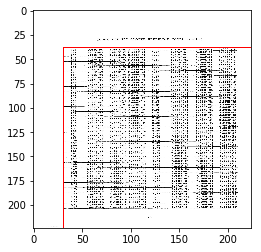

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1818_005.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 610 files and realized 0 errors


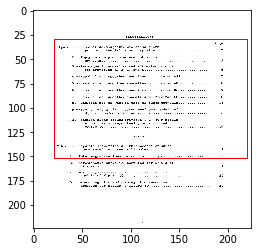

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1818_005.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 611 files and realized 0 errors


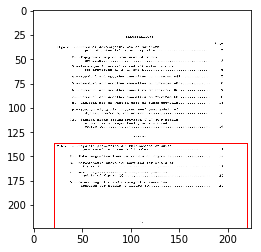

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1830_014.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 612 files and realized 0 errors


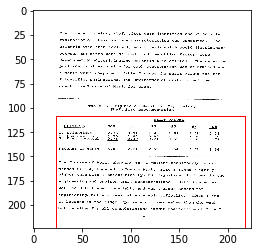

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1852_024.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 613 files and realized 0 errors


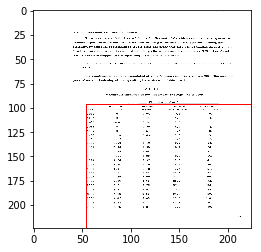

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1852_095.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 614 files and realized 0 errors


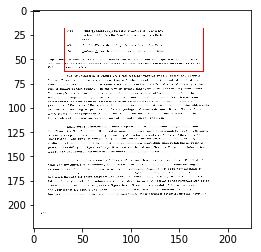

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1896_199.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 615 files and realized 0 errors


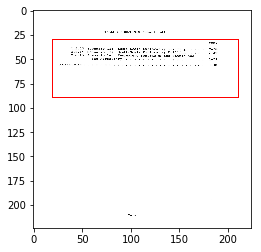

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1896_369.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 616 files and realized 0 errors


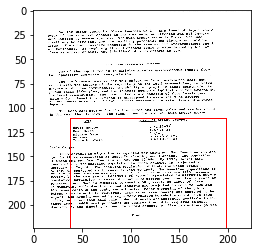

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1896_414.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 617 files and realized 0 errors


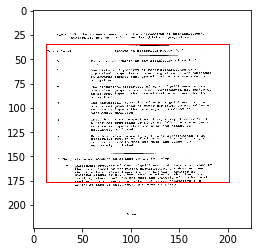

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1901_014.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 618 files and realized 0 errors


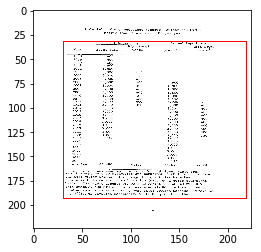

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1939_011.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 619 files and realized 0 errors


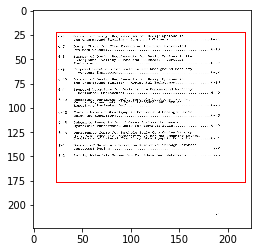

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/1999_019.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 620 files and realized 0 errors


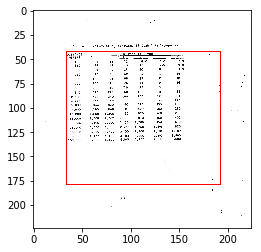

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2010_019.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 621 files and realized 0 errors


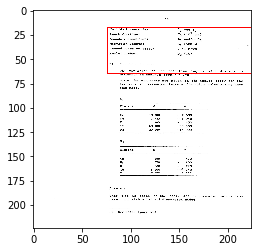

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2010_019.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 622 files and realized 0 errors


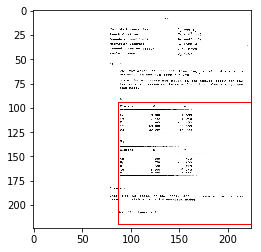

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2010_019.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 623 files and realized 0 errors


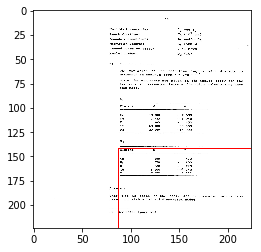

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2029_339.jpg
(2544, 3312, 3)
0.06763285024154589 0.0880503144654088
(224, 224, 3)
Reseized one image done
Checked 624 files and realized 0 errors


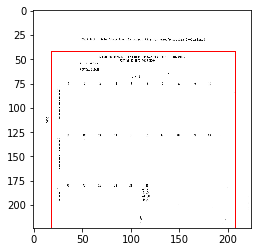

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2029_438.jpg
(2544, 3312, 3)
0.06763285024154589 0.0880503144654088
(224, 224, 3)
Reseized one image done
Checked 625 files and realized 0 errors


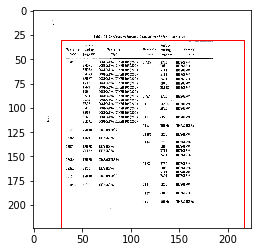

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2029_470.jpg
(2550, 3312, 3)
0.06763285024154589 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 626 files and realized 0 errors


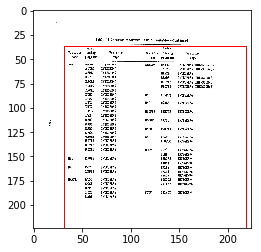

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2029_489.jpg
(2544, 3312, 3)
0.06763285024154589 0.0880503144654088
(224, 224, 3)
Reseized one image done
Checked 627 files and realized 0 errors


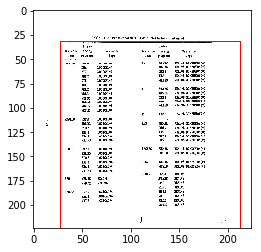

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2042_004.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 628 files and realized 0 errors


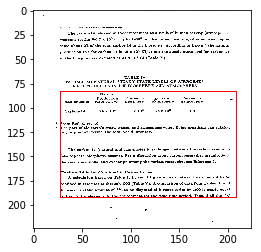

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2070_034.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 629 files and realized 0 errors


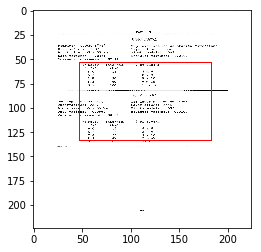

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2070_034.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 630 files and realized 0 errors


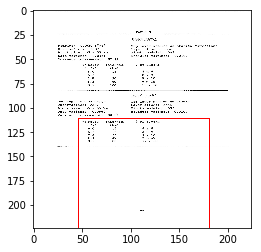

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2092_068.jpg
(2550, 3312, 3)
0.06763285024154589 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 631 files and realized 0 errors


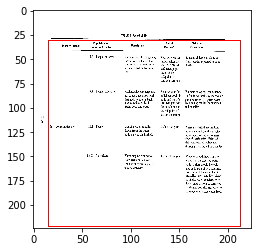

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2093_061.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 632 files and realized 0 errors


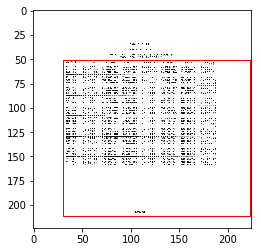

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2117_040.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 633 files and realized 0 errors


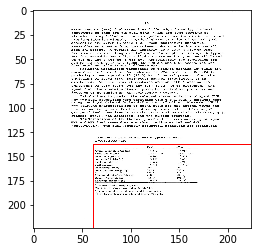

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2117_329.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 634 files and realized 0 errors


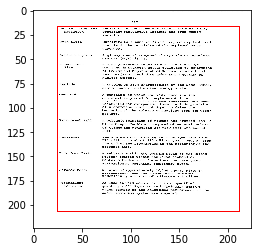

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2117_344.jpg
(2550, 3312, 3)
0.06763285024154589 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 635 files and realized 0 errors


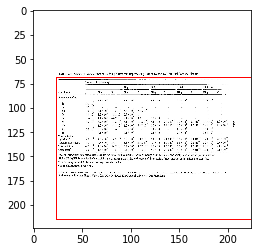

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2135_012.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 636 files and realized 0 errors


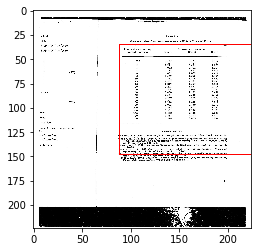

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2136_083.jpg
(2544, 3312, 3)
0.06763285024154589 0.0880503144654088
(224, 224, 3)
Reseized one image done
Checked 637 files and realized 0 errors


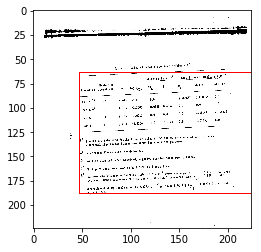

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/2306_093.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 638 files and realized 0 errors


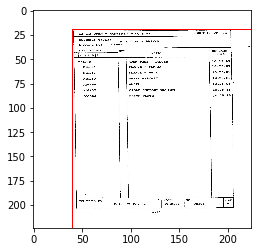

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5001_025.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 639 files and realized 0 errors


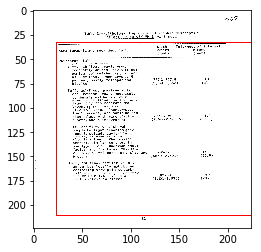

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5001_032.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 640 files and realized 0 errors


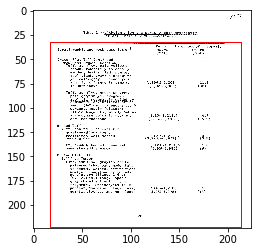

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5008_029.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 641 files and realized 0 errors


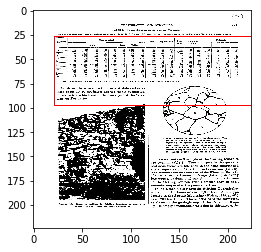

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5017_041.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 642 files and realized 0 errors


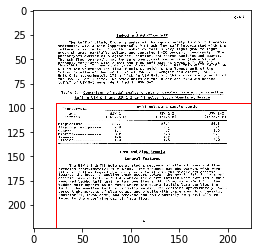

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5028_029.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 643 files and realized 0 errors


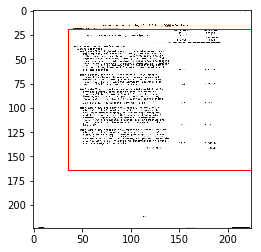

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5045_074.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 644 files and realized 0 errors


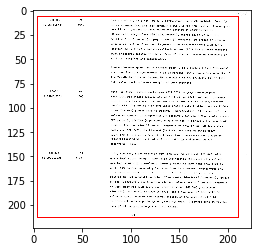

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5065_041.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 645 files and realized 0 errors


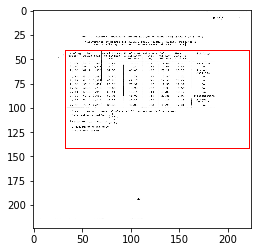

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5067_007.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 646 files and realized 0 errors


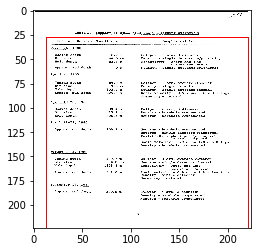

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5086_072.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 647 files and realized 0 errors


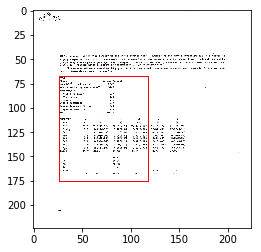

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5086_072.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 648 files and realized 0 errors


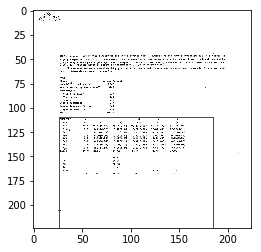

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5095_019.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 649 files and realized 0 errors


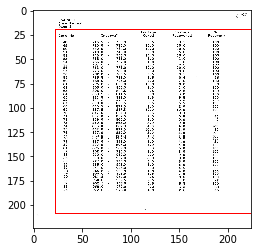

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5099_068.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 650 files and realized 0 errors


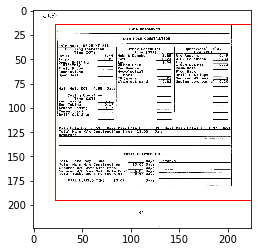

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5103_020.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 651 files and realized 0 errors


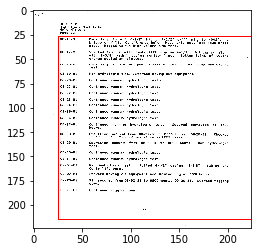

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5109_001.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 652 files and realized 0 errors


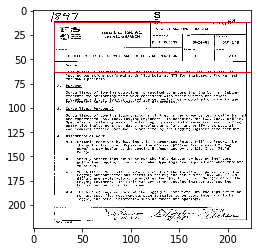

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5112_044.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 653 files and realized 0 errors


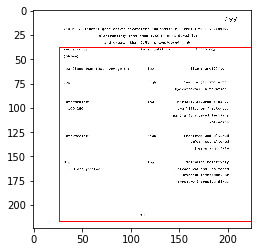

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5117_023.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 654 files and realized 0 errors


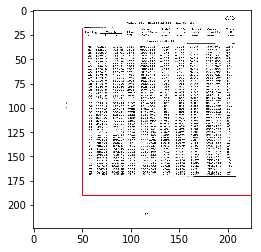

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5140_040.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 655 files and realized 0 errors


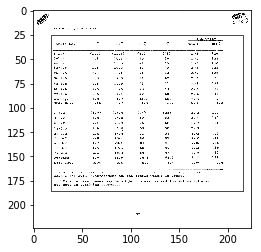

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5170_020.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 656 files and realized 0 errors


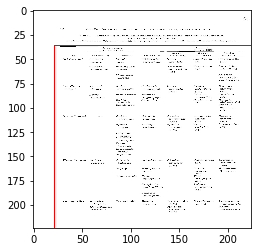

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5182_078.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 657 files and realized 0 errors


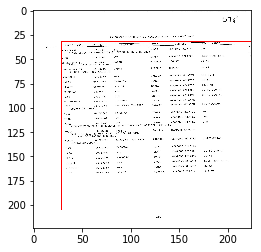

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5191_015.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 658 files and realized 0 errors


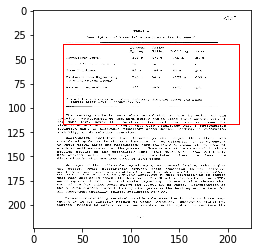

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5192_089.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 659 files and realized 0 errors


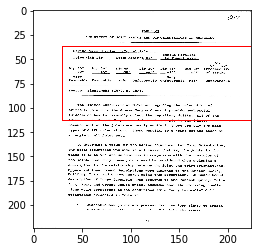

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5195_054.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 660 files and realized 0 errors


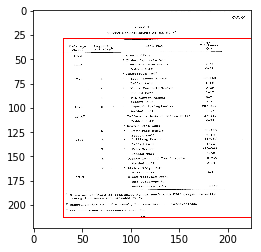

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5195_077.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 661 files and realized 0 errors


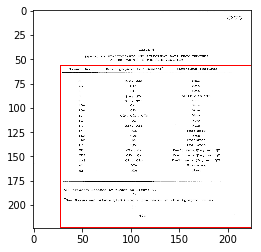

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5244_103.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 662 files and realized 0 errors


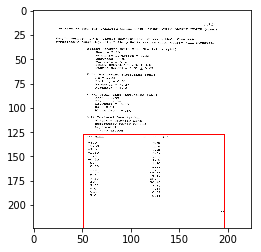

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5248_035.jpg
(2550, 3312, 3)
0.06763285024154589 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 663 files and realized 0 errors


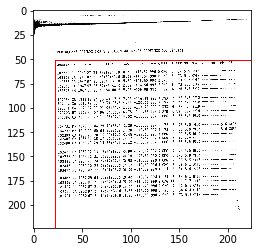

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5252_009.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 664 files and realized 0 errors


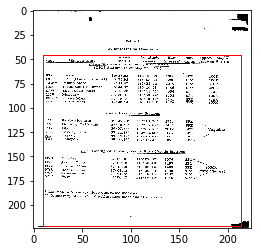

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5265_137.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 665 files and realized 0 errors


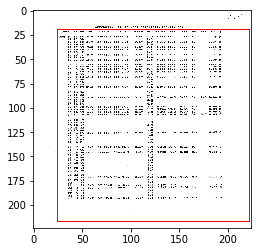

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5303_003.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 666 files and realized 0 errors


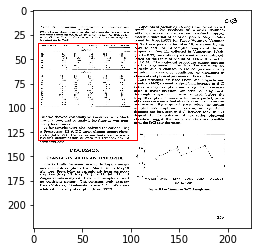

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5333_017.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 667 files and realized 0 errors


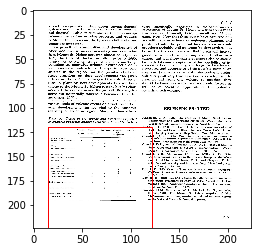

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5347_145.jpg
(2544, 3312, 3)
0.06763285024154589 0.0880503144654088
(224, 224, 3)
Reseized one image done
Checked 668 files and realized 0 errors


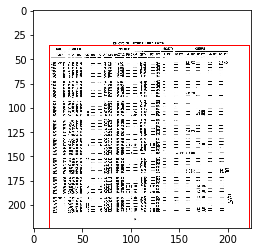

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5347_192.jpg
(2550, 3312, 3)
0.06763285024154589 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 669 files and realized 0 errors


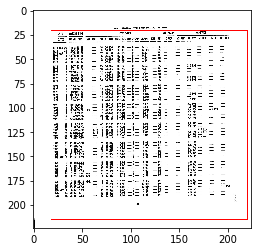

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5361_015.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 670 files and realized 0 errors


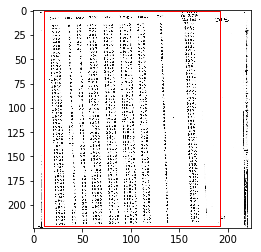

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5365_159.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 671 files and realized 0 errors


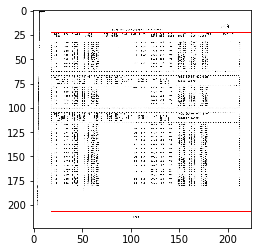

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5366_142.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 672 files and realized 0 errors


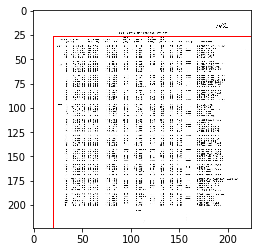

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5367_007.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 673 files and realized 0 errors


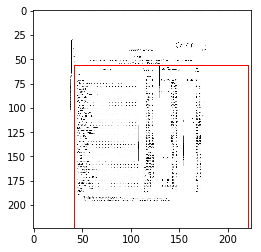

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5375_004.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 674 files and realized 0 errors


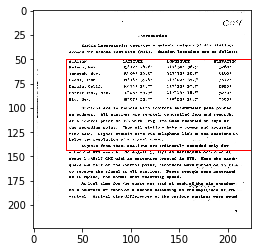

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5380_053.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 675 files and realized 0 errors


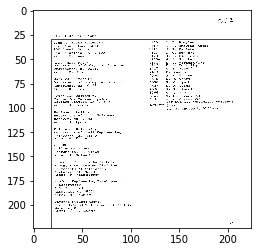

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5385_003.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 676 files and realized 0 errors


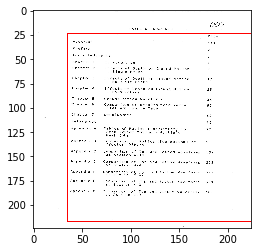

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5385_012.jpg
(2550, 3312, 3)
0.06763285024154589 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 677 files and realized 0 errors


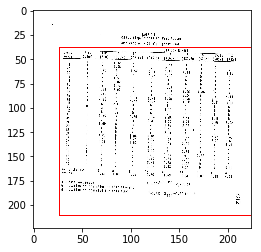

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5408_004.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 678 files and realized 0 errors


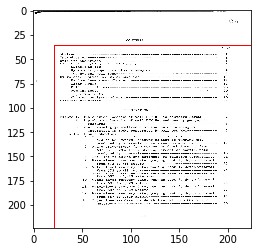

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5412_028.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 679 files and realized 0 errors


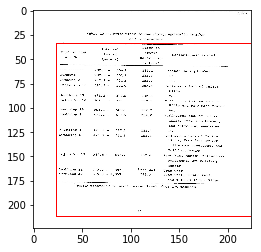

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5415_006.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 680 files and realized 0 errors


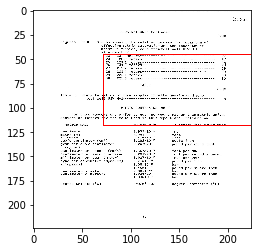

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5415_006.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 681 files and realized 0 errors


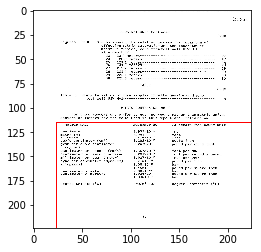

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5417_044.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 682 files and realized 0 errors


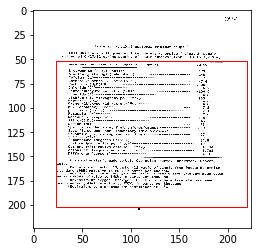

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5435_166.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 683 files and realized 0 errors


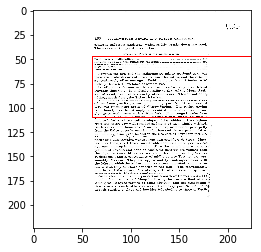

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5449_105.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 684 files and realized 0 errors


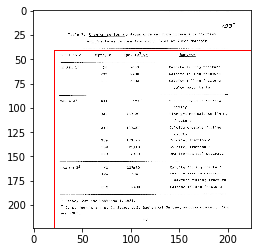

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5515_011.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 685 files and realized 0 errors


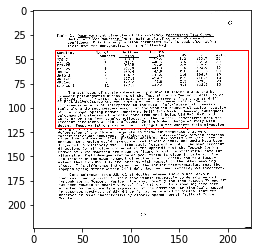

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5575_112.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 686 files and realized 0 errors


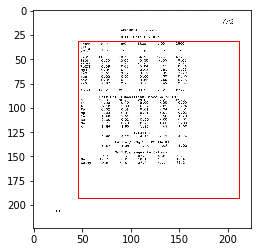

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5589_017.jpg
(2550, 3312, 3)
0.06763285024154589 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 687 files and realized 0 errors


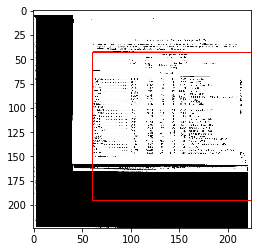

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5592_012.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 688 files and realized 0 errors


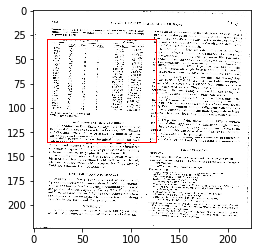

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5593_036.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 689 files and realized 0 errors


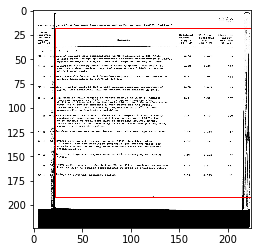

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5593_060.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 690 files and realized 0 errors


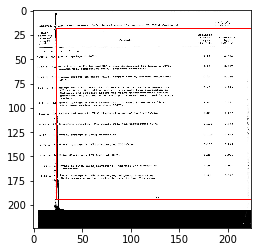

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5611_007.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 691 files and realized 0 errors


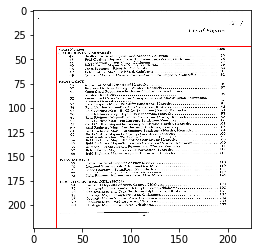

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5611_013.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 692 files and realized 0 errors


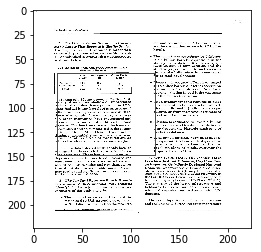

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5622_013.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 693 files and realized 0 errors


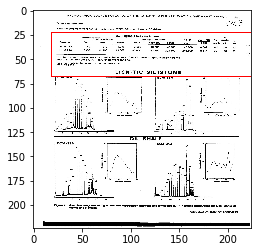

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5625_007.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 694 files and realized 0 errors


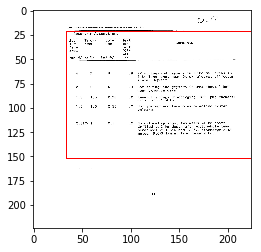

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5625_015.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 695 files and realized 0 errors


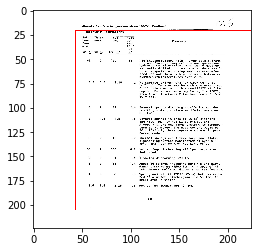

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5649_040.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 696 files and realized 0 errors


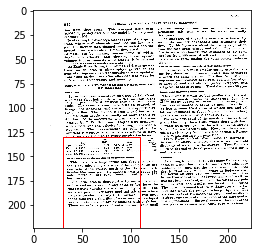

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5649_040.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 697 files and realized 0 errors


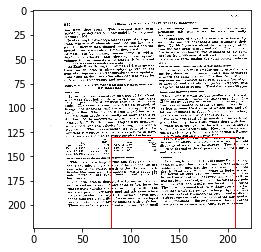

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5649_063.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 698 files and realized 0 errors


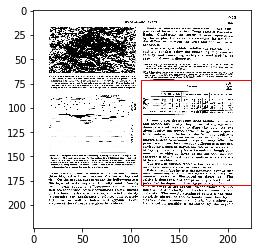

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5649_076.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 699 files and realized 0 errors


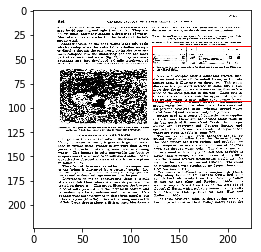

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5661_024.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 700 files and realized 0 errors


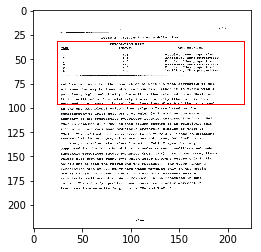

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5670_054.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 701 files and realized 0 errors


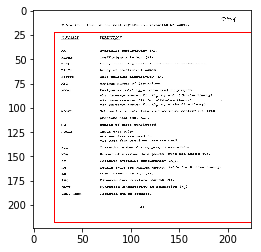

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5673_020.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 702 files and realized 0 errors


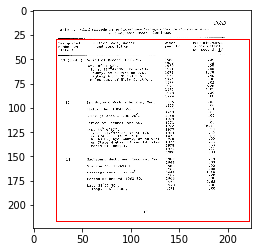

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5673_050.jpg
(2550, 3312, 3)
0.06763285024154589 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 703 files and realized 0 errors


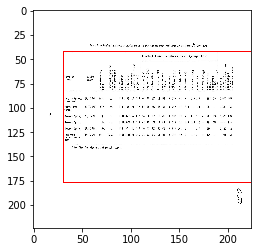

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5675_015.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 704 files and realized 0 errors


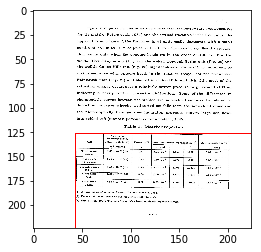

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5680_016.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 705 files and realized 0 errors


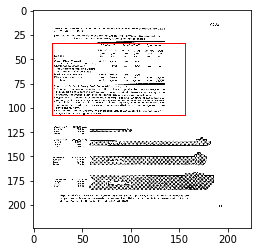

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5680_035.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 706 files and realized 0 errors


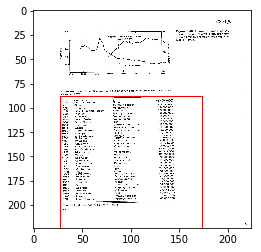

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5685_032.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 707 files and realized 0 errors


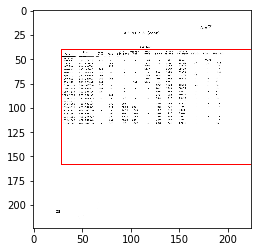

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5727_091.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 708 files and realized 0 errors


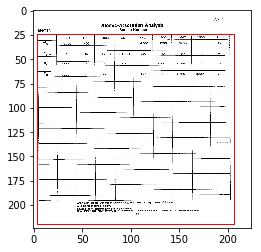

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5727_096.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 709 files and realized 0 errors


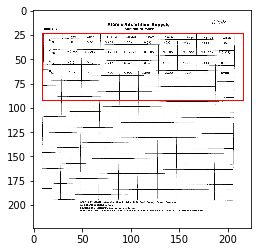

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5727_109.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 710 files and realized 0 errors


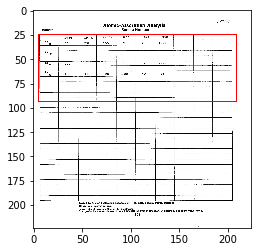

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5731_009.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 711 files and realized 0 errors


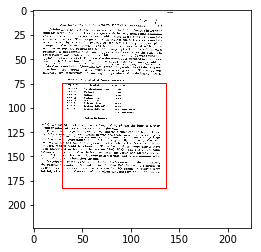

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5809_003.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 712 files and realized 0 errors


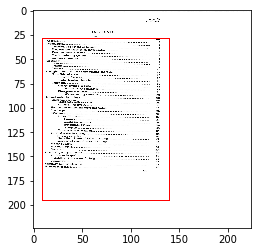

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5814_092.jpg
(2550, 3304, 3)
0.06779661016949153 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 713 files and realized 0 errors


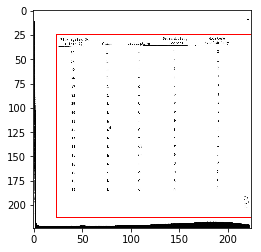

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5820_160.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 714 files and realized 0 errors


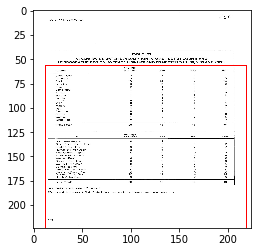

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5830_049.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 715 files and realized 0 errors


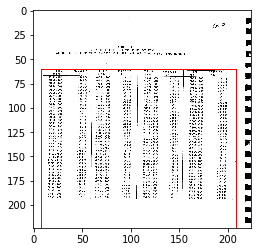

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5830_144.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 716 files and realized 0 errors


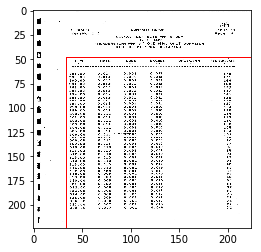

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5830_158.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 717 files and realized 0 errors


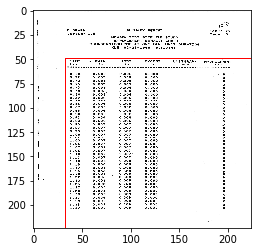

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5830_164.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 718 files and realized 0 errors


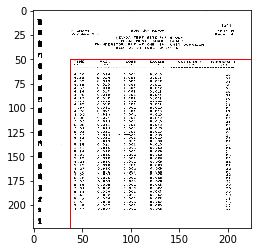

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5830_191.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 719 files and realized 0 errors


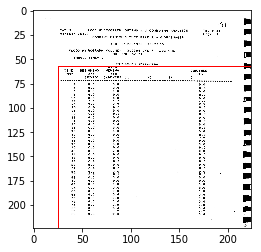

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5830_240.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 720 files and realized 0 errors


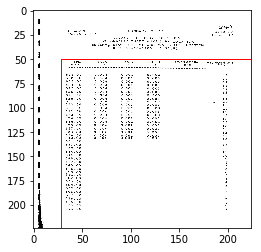

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5830_462.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 721 files and realized 0 errors


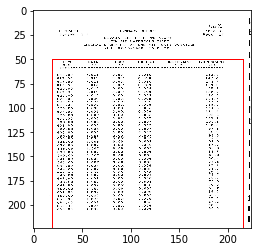

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5842_099.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 722 files and realized 0 errors


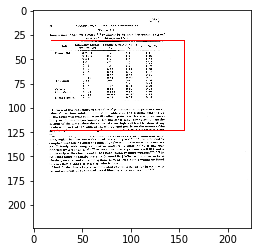

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5848_023.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 723 files and realized 0 errors


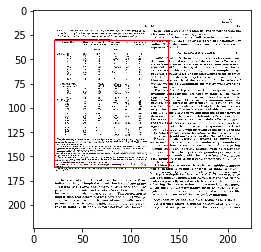

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5856_026.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 724 files and realized 0 errors


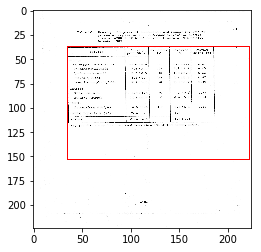

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5881_166.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 725 files and realized 0 errors


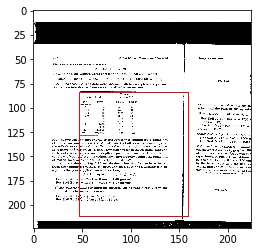

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5913_002.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 726 files and realized 0 errors


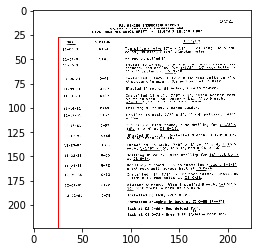

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5925_025.jpg
(2544, 3312, 3)
0.06763285024154589 0.0880503144654088
(224, 224, 3)
Reseized one image done
Checked 727 files and realized 0 errors


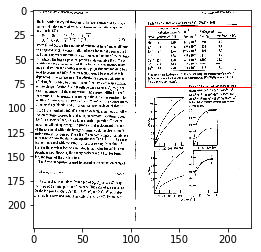

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5926_018.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 728 files and realized 0 errors


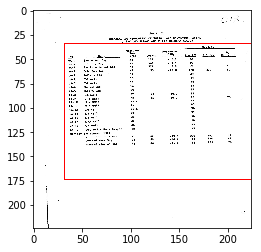

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5935_149.jpg
(2544, 3312, 3)
0.06763285024154589 0.0880503144654088
(224, 224, 3)
Reseized one image done
Checked 729 files and realized 0 errors


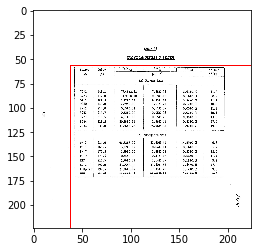

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5955_103.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 730 files and realized 0 errors


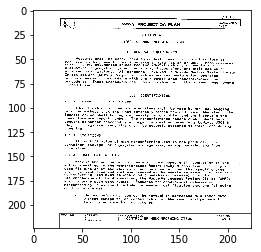

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5956_026.jpg
(2550, 3304, 3)
0.06779661016949153 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 731 files and realized 0 errors


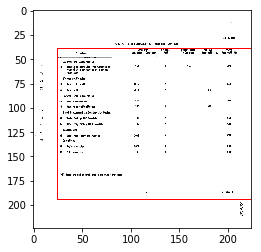

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5963_008.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 732 files and realized 0 errors


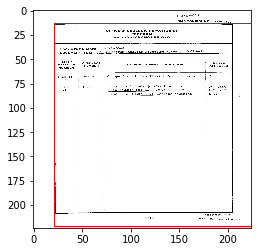

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/5992_072.jpg
(2550, 3304, 3)
0.06779661016949153 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 733 files and realized 0 errors


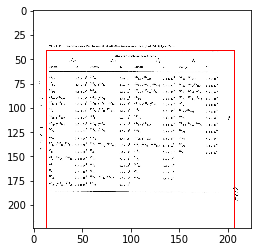

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/6008_014.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 734 files and realized 0 errors


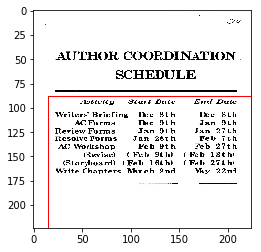

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/6114_062.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 735 files and realized 0 errors


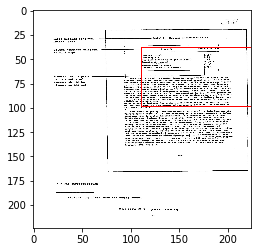

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/6286_013.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 736 files and realized 0 errors


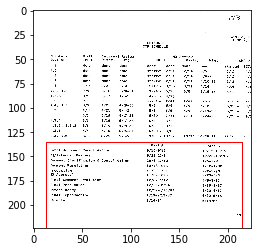

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/6294_118.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 737 files and realized 0 errors


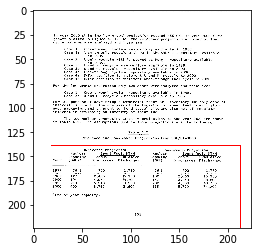

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/6294_128.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 738 files and realized 0 errors


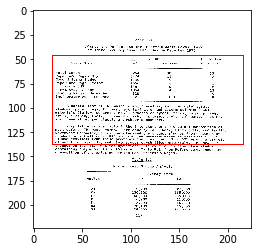

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/6294_128.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 739 files and realized 0 errors


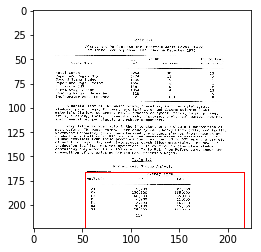

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/6294_160.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 740 files and realized 0 errors


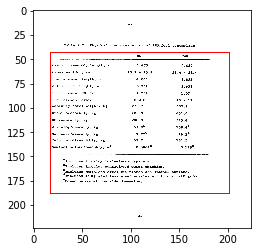

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/6294_166.jpg
(2550, 3304, 3)
0.06779661016949153 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 741 files and realized 0 errors


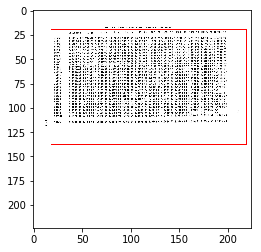

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/6346_024.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 742 files and realized 0 errors


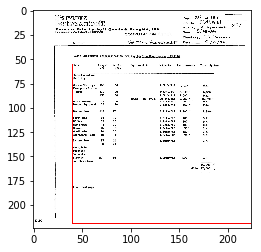

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/6347_112.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 743 files and realized 0 errors


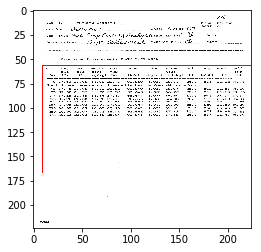

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/6415_046.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 744 files and realized 0 errors


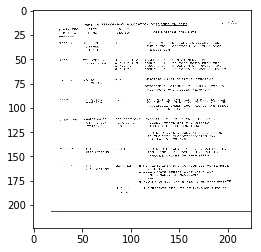

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/6546_011.jpg
(2544, 3312, 3)
0.06763285024154589 0.0880503144654088
(224, 224, 3)
Reseized one image done
Checked 745 files and realized 0 errors


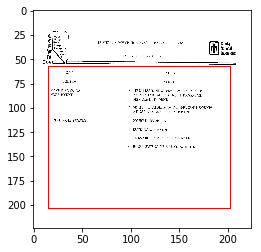

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/6546_016.jpg
(2544, 3312, 3)
0.06763285024154589 0.0880503144654088
(224, 224, 3)
Reseized one image done
Checked 746 files and realized 0 errors


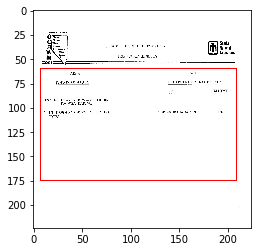

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/6575_007.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 747 files and realized 0 errors


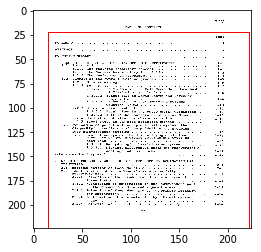

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/6577_020.jpg
(2544, 3312, 3)
0.06763285024154589 0.0880503144654088
(224, 224, 3)
Reseized one image done
Checked 748 files and realized 0 errors


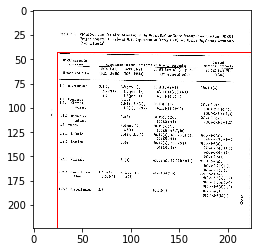

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/6578_052.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 749 files and realized 0 errors


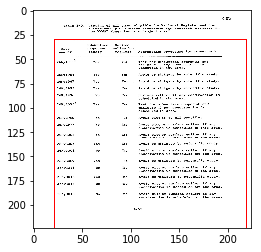

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/6580_018.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 750 files and realized 0 errors


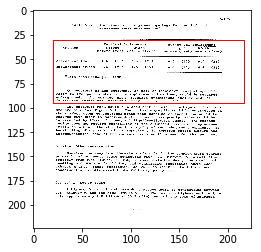

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/6580_091.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 751 files and realized 0 errors


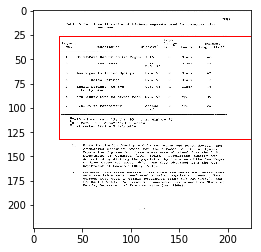

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/6580_125.jpg
(2550, 3304, 3)
0.06779661016949153 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 752 files and realized 0 errors


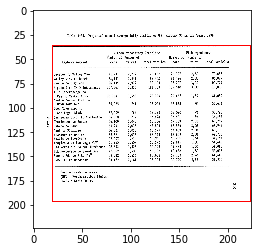

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/6581_209.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 753 files and realized 0 errors


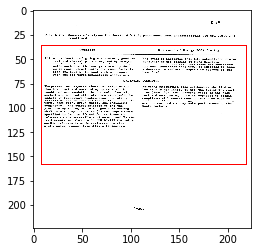

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/6583_055.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 754 files and realized 0 errors


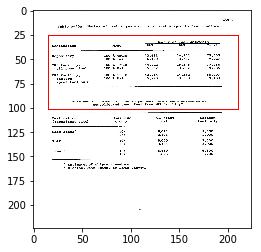

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/6583_055.jpg
(3300, 2544, 3)
0.0880503144654088 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 755 files and realized 0 errors


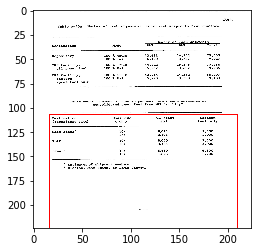

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/6585_484.jpg
(2550, 3304, 3)
0.06779661016949153 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 756 files and realized 0 errors


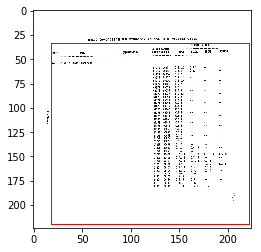

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/6585_486.jpg
(2550, 3304, 3)
0.06779661016949153 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 757 files and realized 0 errors


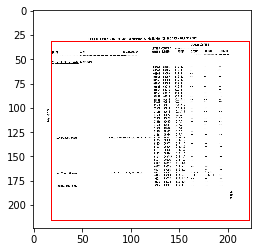

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/6585_593.jpg
(2544, 3312, 3)
0.06763285024154589 0.0880503144654088
(224, 224, 3)
Reseized one image done
Checked 758 files and realized 0 errors


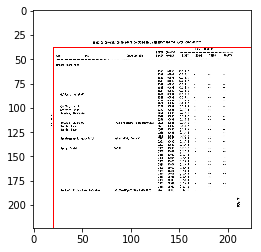

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/6790_011.jpg
(2544, 3312, 3)
0.06763285024154589 0.0880503144654088
(224, 224, 3)
Reseized one image done
Checked 759 files and realized 0 errors


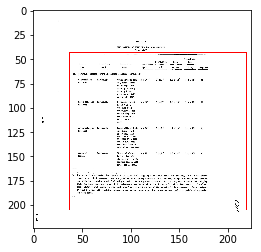

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/6814_006.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 760 files and realized 0 errors


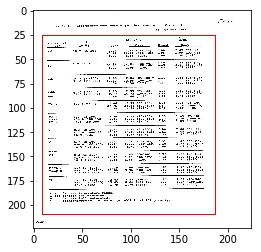

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/8005_125.jpg
(3312, 2560, 3)
0.0875 0.06763285024154589
(224, 224, 3)
Reseized one image done
Checked 761 files and realized 0 errors


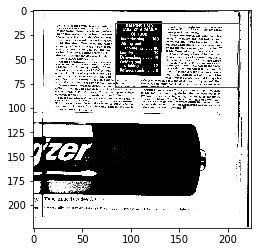

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/8024_015.jpg
(3312, 2560, 3)
0.0875 0.06763285024154589
(224, 224, 3)
Reseized one image done
Checked 762 files and realized 0 errors


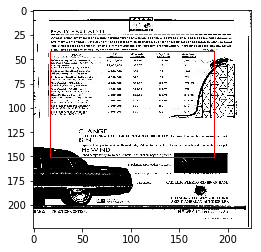

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/8025_067.jpg
(3312, 2560, 3)
0.0875 0.06763285024154589
(224, 224, 3)
Reseized one image done
Checked 763 files and realized 0 errors


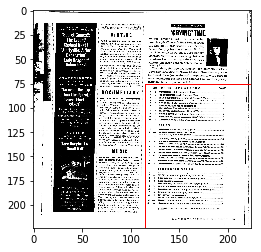

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/8031_232.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 764 files and realized 0 errors


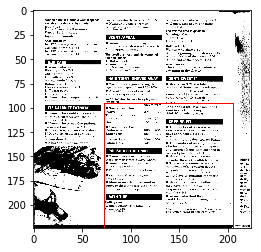

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/8095_046.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 765 files and realized 0 errors


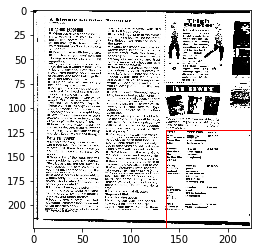

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/8209_010.jpg
(2550, 3312, 3)
0.06763285024154589 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 766 files and realized 0 errors


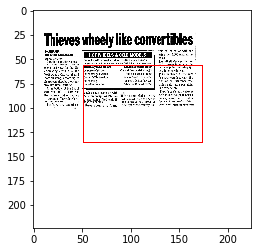

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/8232_013.jpg
(3300, 2560, 3)
0.0875 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 767 files and realized 0 errors


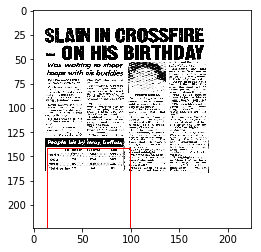

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9500_023.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 768 files and realized 0 errors


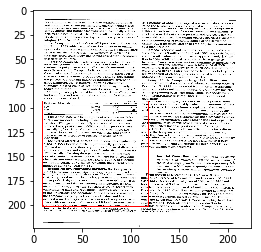

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9500_034.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 769 files and realized 0 errors


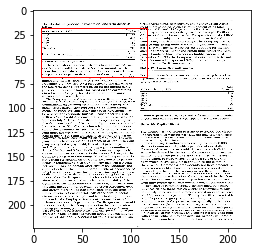

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9500_034.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 770 files and realized 0 errors


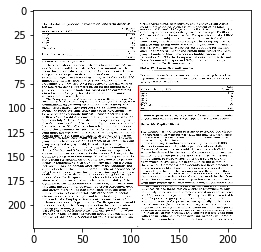

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9501_022.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 771 files and realized 0 errors


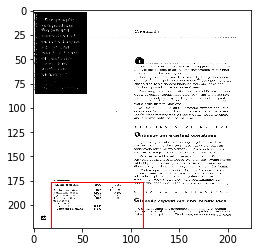

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9501_032.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 772 files and realized 0 errors


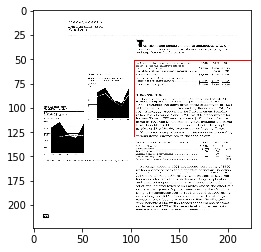

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9501_032.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 773 files and realized 0 errors


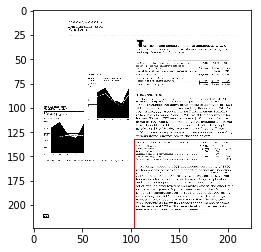

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9501_043.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 774 files and realized 0 errors


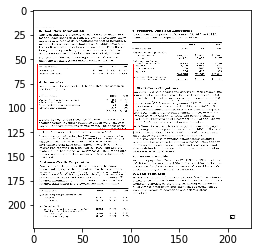

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9501_043.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 775 files and realized 0 errors


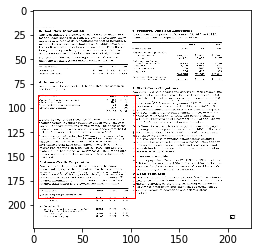

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9501_043.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 776 files and realized 0 errors


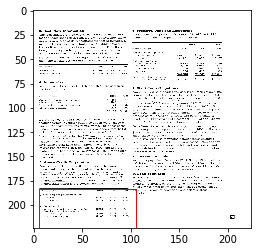

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9501_043.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 777 files and realized 0 errors


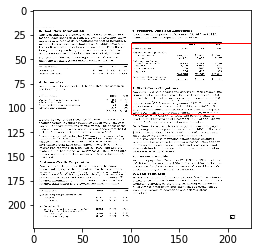

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9502_055.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 778 files and realized 0 errors


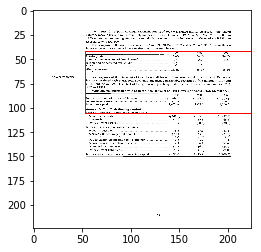

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9502_055.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 779 files and realized 0 errors


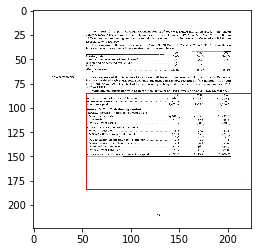

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9502_055.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 780 files and realized 0 errors


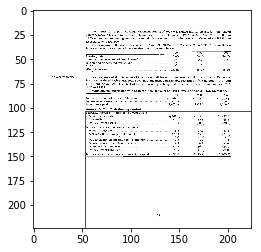

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9502_061.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 781 files and realized 0 errors


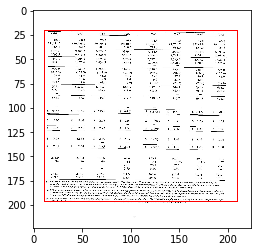

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9503_001.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 782 files and realized 0 errors


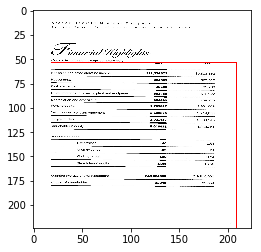

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9503_027.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 783 files and realized 0 errors


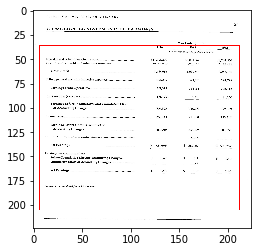

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9504_025.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 784 files and realized 0 errors


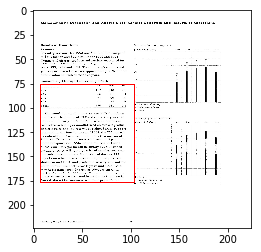

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9506_017.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 785 files and realized 0 errors


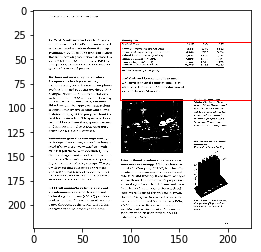

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9507_030.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 786 files and realized 0 errors


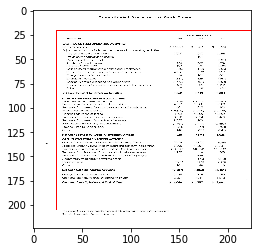

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9508_056.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 787 files and realized 0 errors


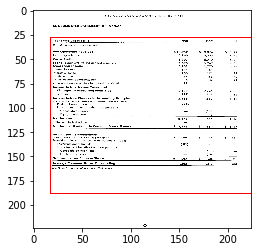

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9508_064.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 788 files and realized 0 errors


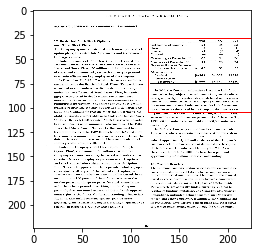

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9508_065.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 789 files and realized 0 errors


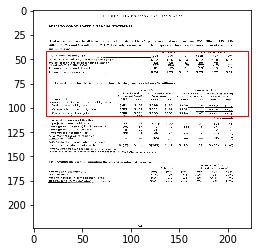

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9508_065.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 790 files and realized 0 errors


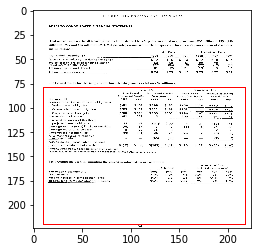

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9508_065.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 791 files and realized 0 errors


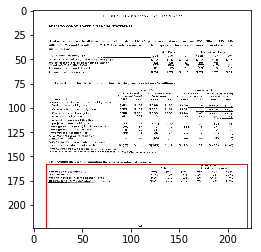

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9508_067.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 792 files and realized 0 errors


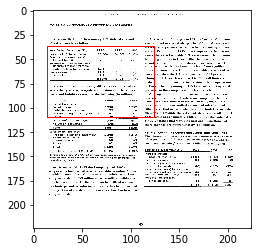

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9508_067.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 793 files and realized 0 errors


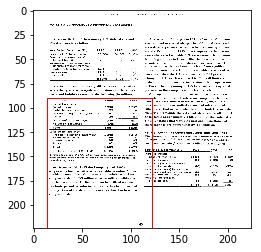

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9508_067.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 794 files and realized 0 errors


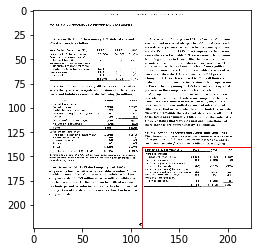

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9509_040.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 795 files and realized 0 errors


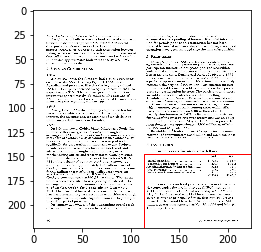

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9509_042.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 796 files and realized 0 errors


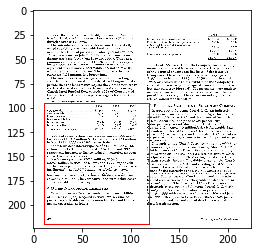

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9509_042.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 797 files and realized 0 errors


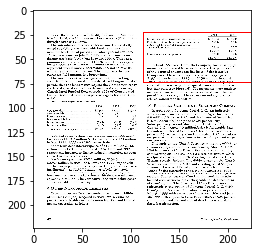

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9509_045.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 798 files and realized 0 errors


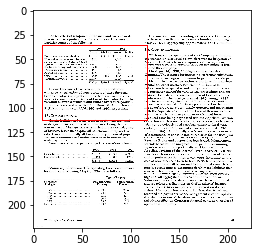

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9509_045.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 799 files and realized 0 errors


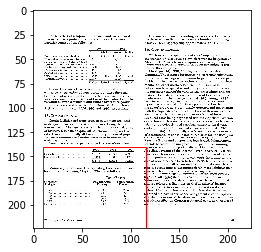

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9509_045.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 800 files and realized 0 errors


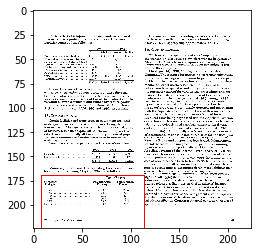

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9510_031.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 801 files and realized 0 errors


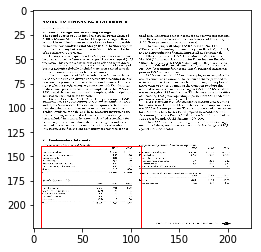

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9510_031.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 802 files and realized 0 errors


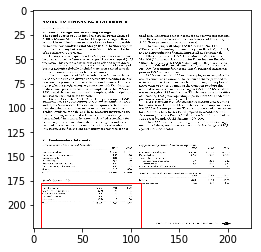

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9510_031.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 803 files and realized 0 errors


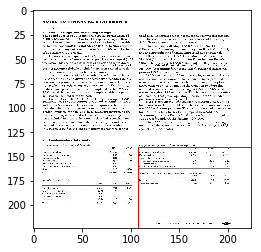

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9510_031.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 804 files and realized 0 errors


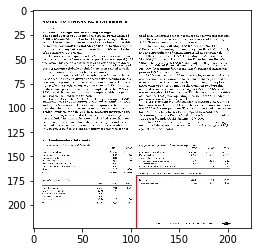

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9510_037.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 805 files and realized 0 errors


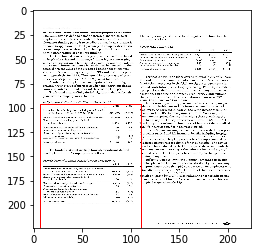

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9510_037.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 806 files and realized 0 errors


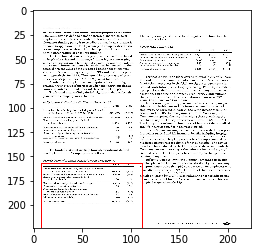

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9510_037.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 807 files and realized 0 errors


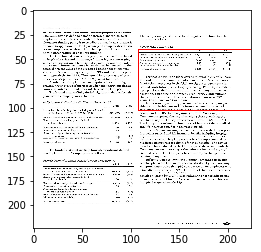

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9510_041.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 808 files and realized 0 errors


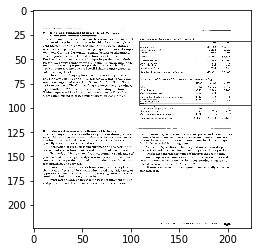

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9510_041.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 809 files and realized 0 errors


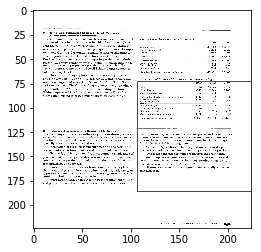

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9511_031.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 810 files and realized 0 errors


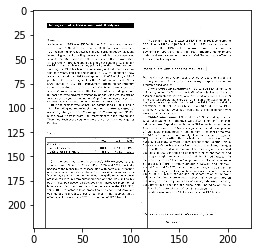

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9512_043.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 811 files and realized 0 errors


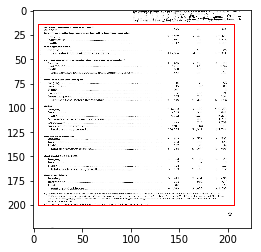

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9513_030.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 812 files and realized 0 errors


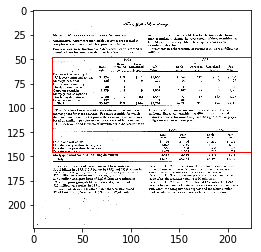

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9513_030.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 813 files and realized 0 errors


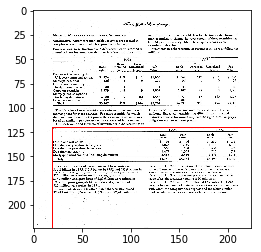

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9514_046.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 814 files and realized 0 errors


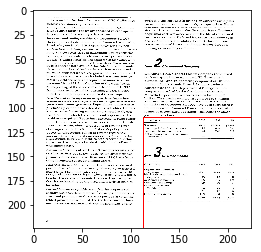

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9514_046.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 815 files and realized 0 errors


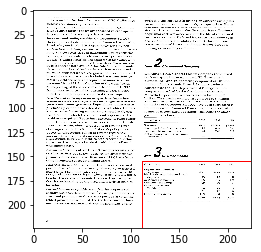

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9515_022.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 816 files and realized 0 errors


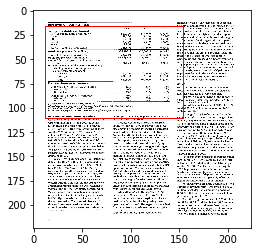

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9515_023.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 817 files and realized 0 errors


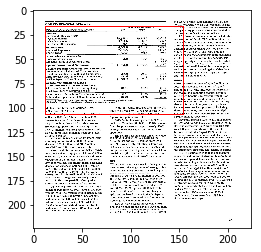

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9515_024.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 818 files and realized 0 errors


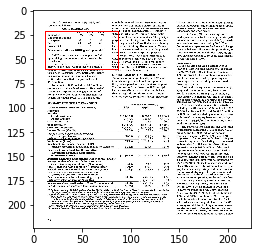

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9515_024.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 819 files and realized 0 errors


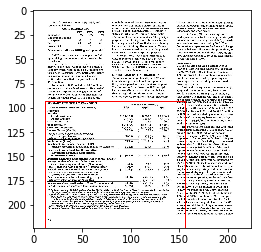

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9516_001.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 820 files and realized 0 errors


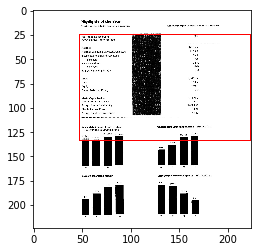

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9516_041.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 821 files and realized 0 errors


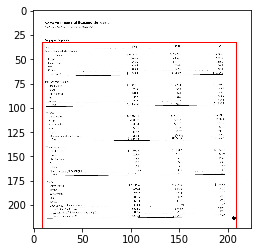

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9517_037.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 822 files and realized 0 errors


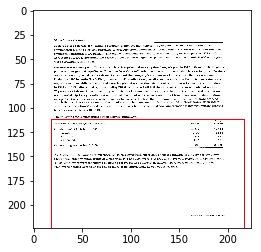

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9517_045.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 823 files and realized 0 errors


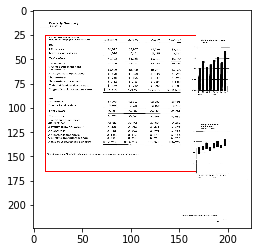

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9518_015.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 824 files and realized 0 errors


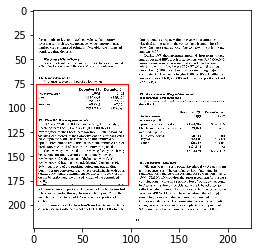

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9518_015.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 825 files and realized 0 errors


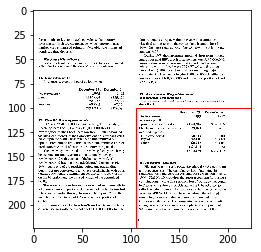

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9518_018.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 826 files and realized 0 errors


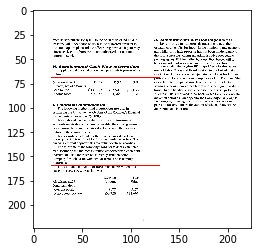

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9518_018.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 827 files and realized 0 errors


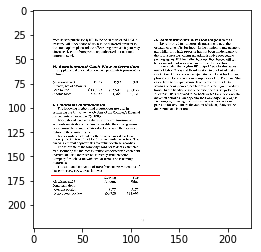

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9519_034.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 828 files and realized 0 errors


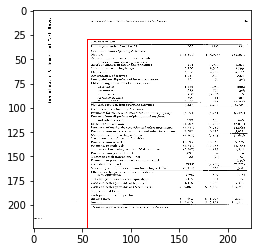

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9519_045.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 829 files and realized 0 errors


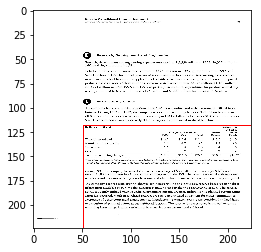

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9519_063.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 830 files and realized 0 errors


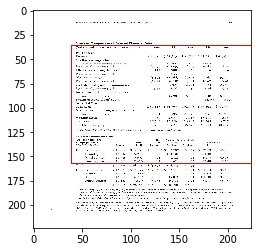

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9519_063.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 831 files and realized 0 errors


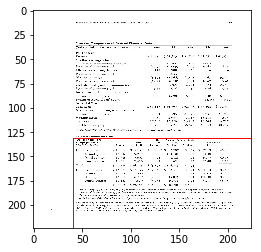

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9520_037.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 832 files and realized 0 errors


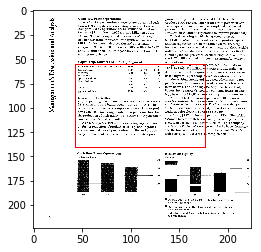

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9520_041.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 833 files and realized 0 errors


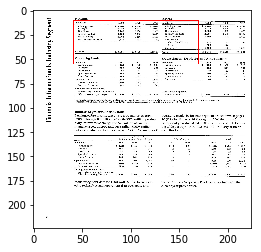

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9520_041.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 834 files and realized 0 errors


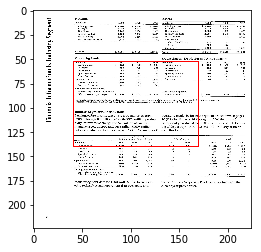

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9520_041.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 835 files and realized 0 errors


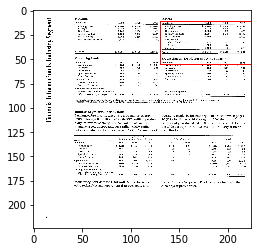

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9520_041.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 836 files and realized 0 errors


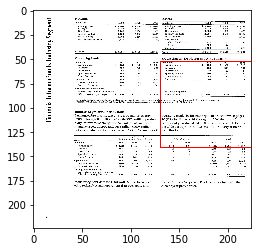

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9520_041.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 837 files and realized 0 errors


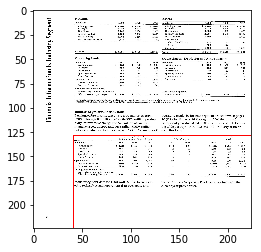

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9521_052.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 838 files and realized 0 errors


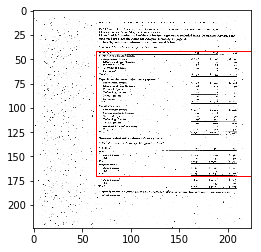

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9521_052.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 839 files and realized 0 errors


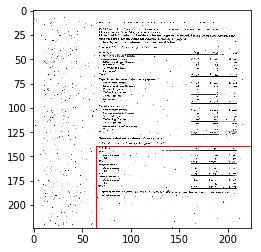

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9522_041.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 840 files and realized 0 errors


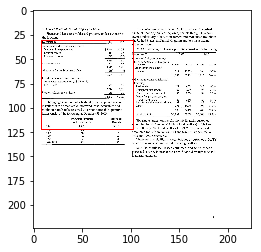

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9522_041.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 841 files and realized 0 errors


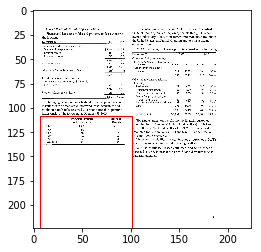

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9522_041.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 842 files and realized 0 errors


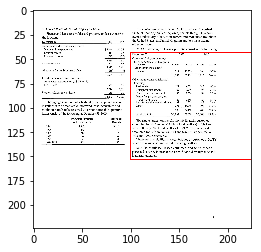

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9522_055.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 843 files and realized 0 errors


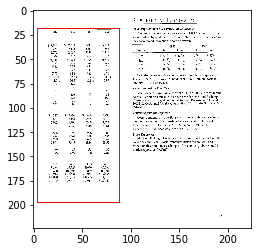

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9522_055.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 844 files and realized 0 errors


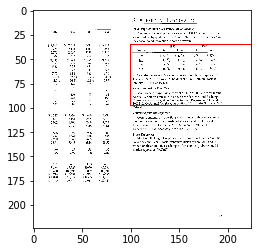

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9525_037.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 845 files and realized 0 errors


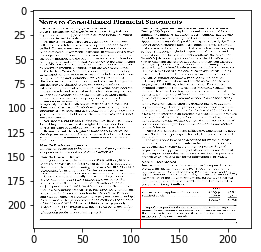

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9525_043.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 846 files and realized 0 errors


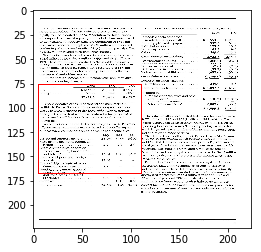

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9525_043.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 847 files and realized 0 errors


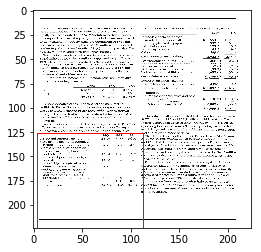

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9525_043.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 848 files and realized 0 errors


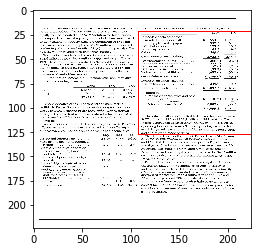

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9526_017.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 849 files and realized 0 errors


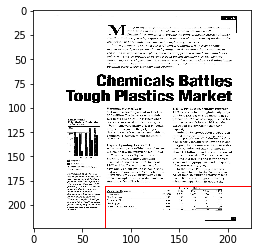

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9526_028.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 850 files and realized 0 errors


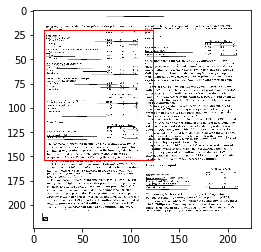

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9526_028.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 851 files and realized 0 errors


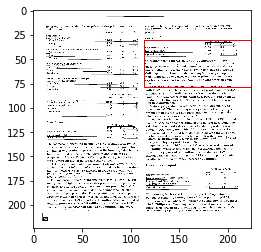

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9526_028.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 852 files and realized 0 errors


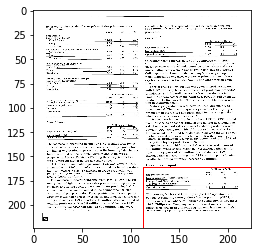

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9527_018.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 853 files and realized 0 errors


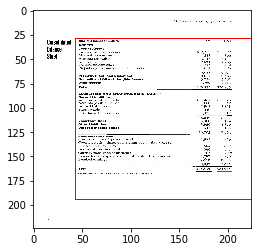

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9527_024.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 854 files and realized 0 errors


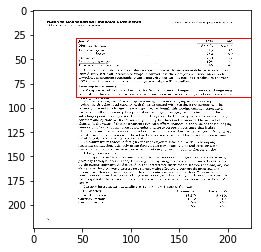

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9527_024.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 855 files and realized 0 errors


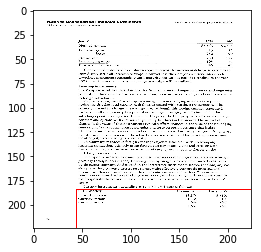

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9528_043.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 856 files and realized 0 errors


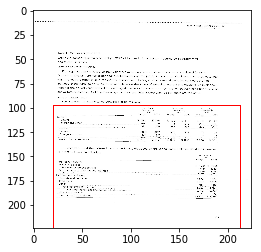

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9528_043.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 857 files and realized 0 errors


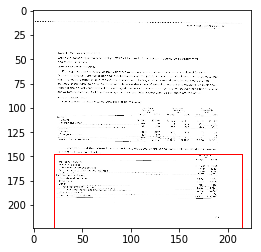

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9528_061.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 858 files and realized 0 errors


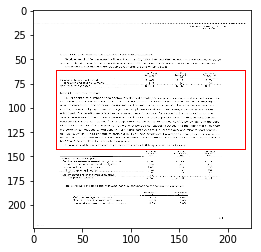

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9528_061.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 859 files and realized 0 errors


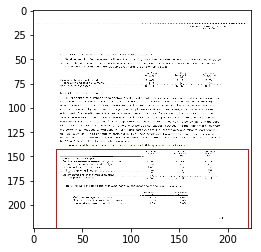

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9528_061.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 860 files and realized 0 errors


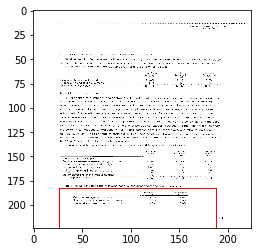

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9529_050.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 861 files and realized 0 errors


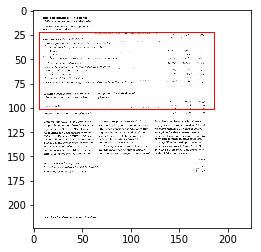

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9529_050.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 862 files and realized 0 errors


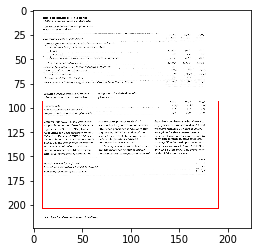

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9529_050.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 863 files and realized 0 errors


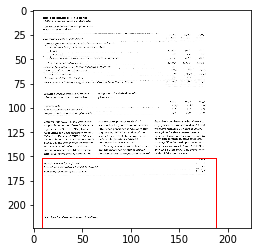

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9530_051.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 864 files and realized 0 errors


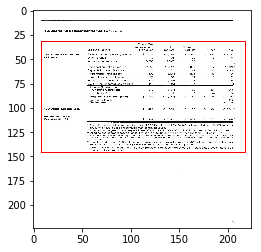

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9531_070.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 865 files and realized 0 errors


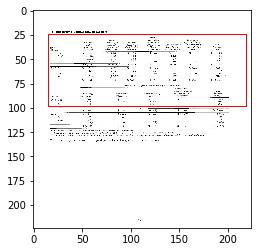

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9531_070.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 866 files and realized 0 errors


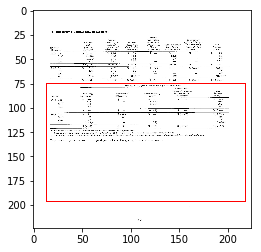

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9531_073.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 867 files and realized 0 errors


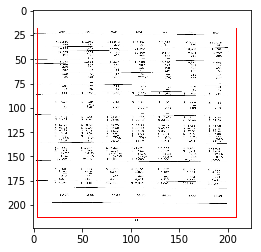

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9532_146.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 868 files and realized 0 errors


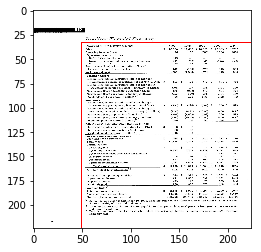

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9533_038.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 869 files and realized 0 errors


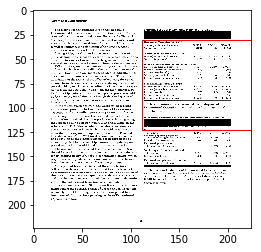

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9533_038.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 870 files and realized 0 errors


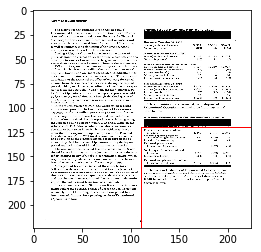

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9533_039.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 871 files and realized 0 errors


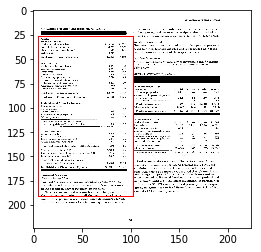

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9533_039.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 872 files and realized 0 errors


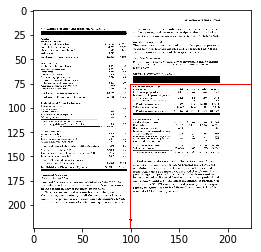

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9534_001.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 873 files and realized 0 errors


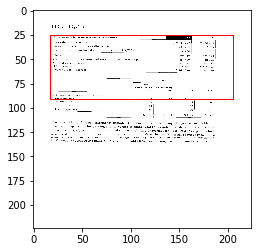

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9534_001.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 874 files and realized 0 errors


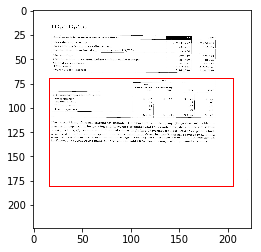

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9534_028.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 875 files and realized 0 errors


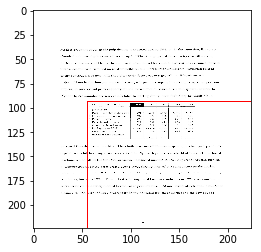

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9535_027.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 876 files and realized 0 errors


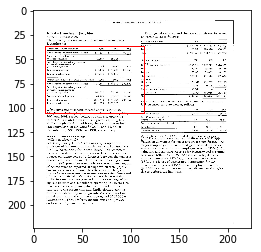

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9535_027.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 877 files and realized 0 errors


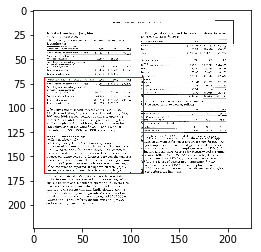

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9535_027.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 878 files and realized 0 errors


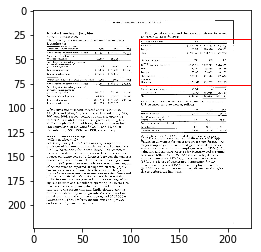

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9535_027.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 879 files and realized 0 errors


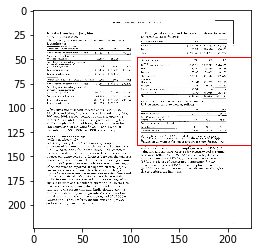

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9535_027.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 880 files and realized 0 errors


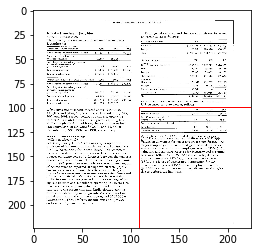

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9536_010.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 881 files and realized 0 errors


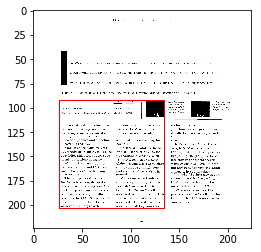

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9536_036.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 882 files and realized 0 errors


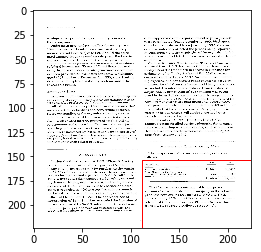

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9537_032.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 883 files and realized 0 errors


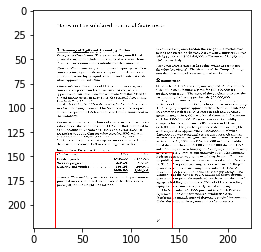

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9537_038.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 884 files and realized 0 errors


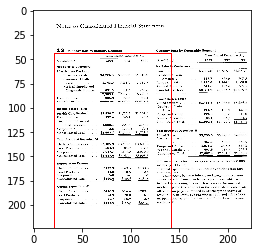

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9537_038.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 885 files and realized 0 errors


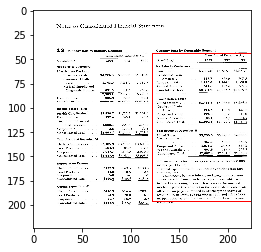

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9538_012.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 886 files and realized 0 errors


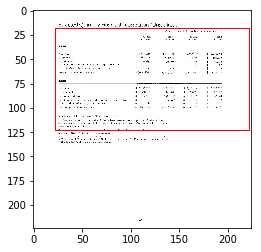

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9538_018.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 887 files and realized 0 errors


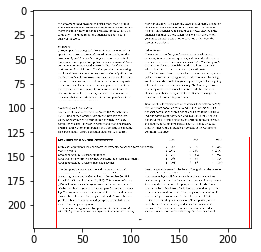

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9538_022.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 888 files and realized 0 errors


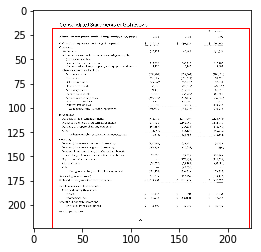

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9538_031.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 889 files and realized 0 errors


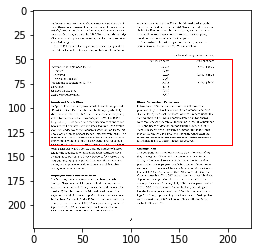

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9540_040.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 890 files and realized 0 errors


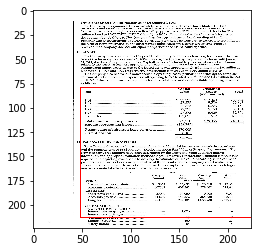

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9540_040.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 891 files and realized 0 errors


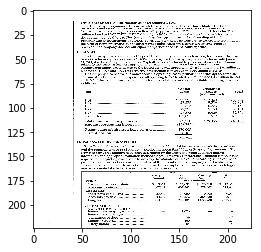

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9541_023.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 892 files and realized 0 errors


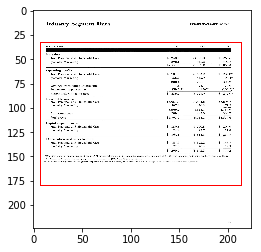

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9541_028.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 893 files and realized 0 errors


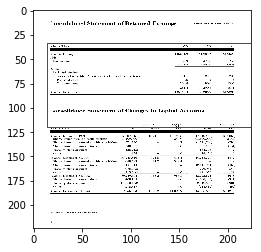

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9541_028.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 894 files and realized 0 errors


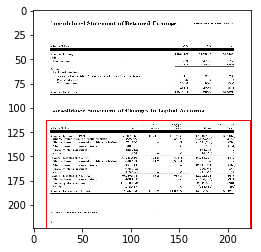

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9542_025.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 895 files and realized 0 errors


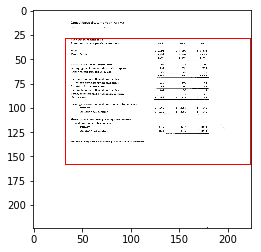

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9542_032.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 896 files and realized 0 errors


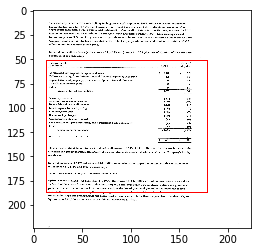

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9545_026.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 897 files and realized 0 errors


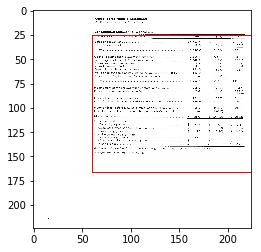

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9545_036.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 898 files and realized 0 errors


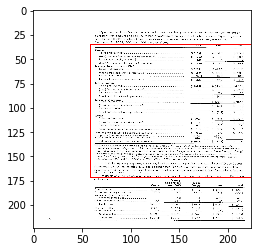

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9545_036.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 899 files and realized 0 errors


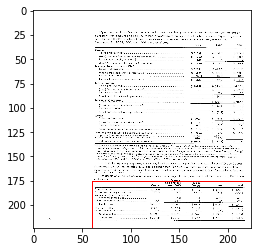

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9546_030.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 900 files and realized 0 errors


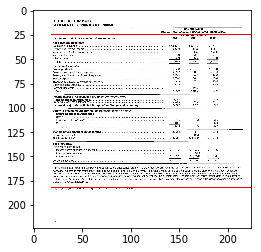

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9548_034.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 901 files and realized 0 errors


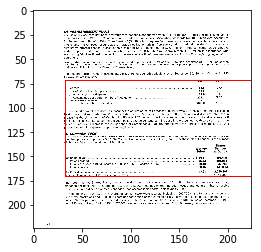

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9548_034.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 902 files and realized 0 errors


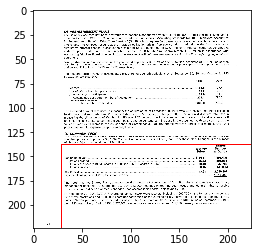

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9548_035.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 903 files and realized 0 errors


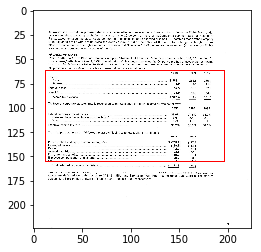

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9548_035.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 904 files and realized 0 errors


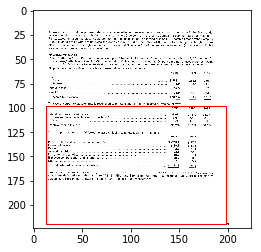

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9548_035.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 905 files and realized 0 errors


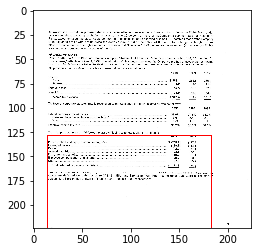

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9549_009.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 906 files and realized 0 errors


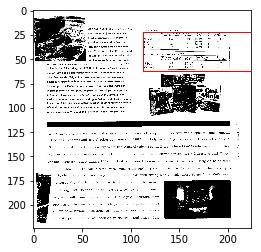

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9549_009.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 907 files and realized 0 errors


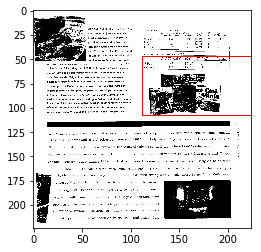

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9549_023.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 908 files and realized 0 errors


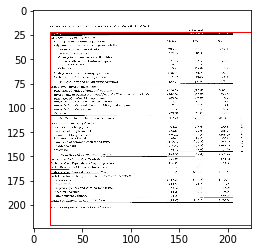

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9549_030.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 909 files and realized 0 errors


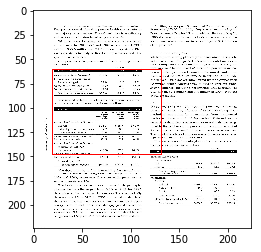

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9549_030.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 910 files and realized 0 errors


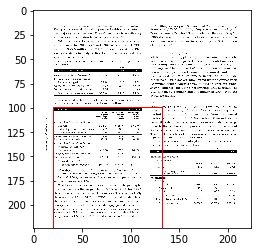

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9549_030.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 911 files and realized 0 errors


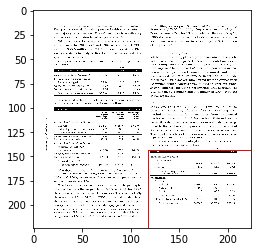

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9550_050.jpg
(2550, 3304, 3)
0.06779661016949153 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 912 files and realized 0 errors


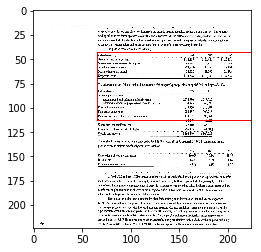

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9550_050.jpg
(2550, 3304, 3)
0.06779661016949153 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 913 files and realized 0 errors


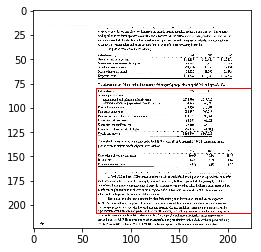

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9550_050.jpg
(2550, 3304, 3)
0.06779661016949153 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 914 files and realized 0 errors


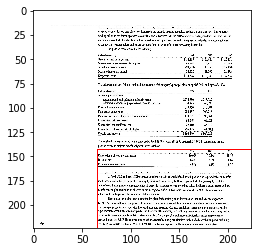

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9550_056.jpg
(2550, 3304, 3)
0.06779661016949153 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 915 files and realized 0 errors


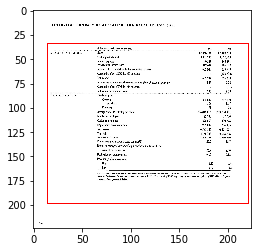

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9551_062.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 916 files and realized 0 errors


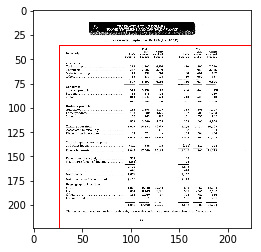

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9552_001.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 917 files and realized 0 errors


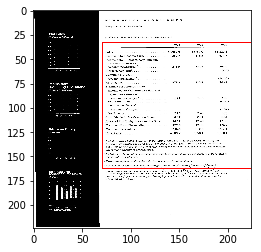

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9552_038.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 918 files and realized 0 errors


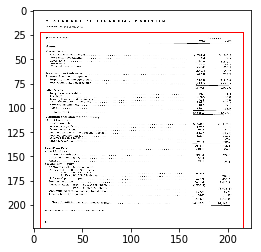

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9552_039.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 919 files and realized 0 errors


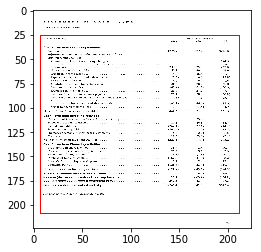

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9553_023.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 920 files and realized 0 errors


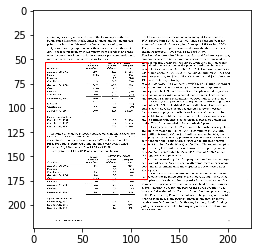

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9553_023.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 921 files and realized 0 errors


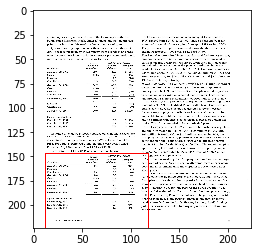

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9554_028.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 922 files and realized 0 errors


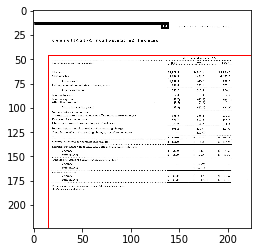

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9555_015.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 923 files and realized 0 errors


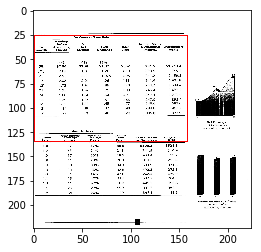

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9555_015.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 924 files and realized 0 errors


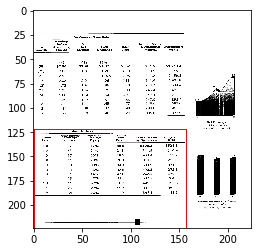

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9556_021.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 925 files and realized 0 errors


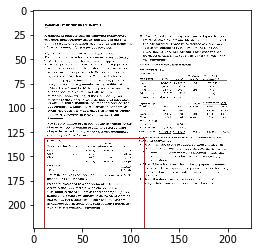

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9556_021.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 926 files and realized 0 errors


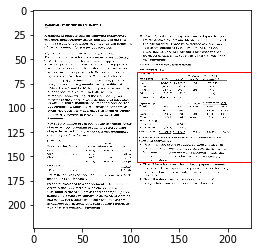

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9556_021.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 927 files and realized 0 errors


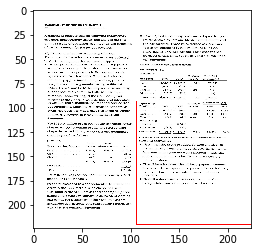

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9557_020.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 928 files and realized 0 errors


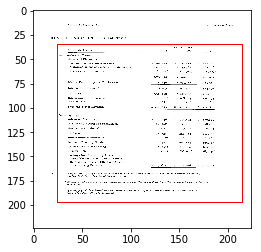

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9557_035.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 929 files and realized 0 errors


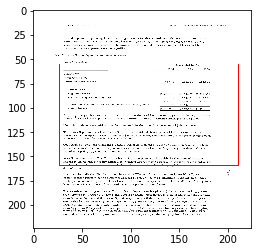

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9560_038.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 930 files and realized 0 errors


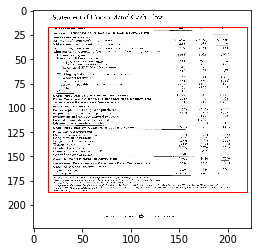

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9561_026.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 931 files and realized 0 errors


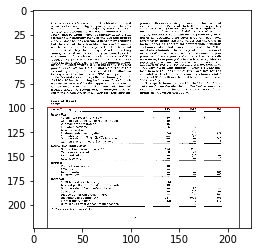

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9561_044.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 932 files and realized 0 errors


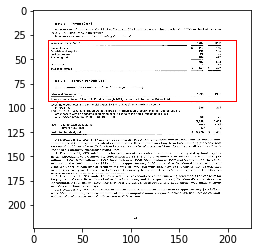

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9561_044.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 933 files and realized 0 errors


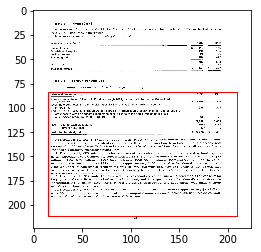

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9561_049.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 934 files and realized 0 errors


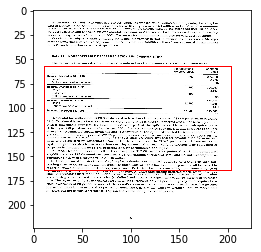

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9562_024.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 935 files and realized 0 errors


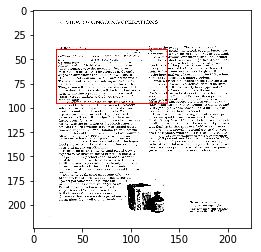

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9562_053.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 936 files and realized 0 errors


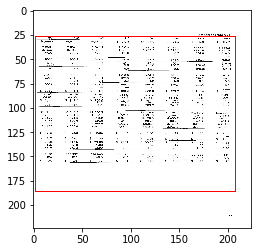

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9563_061.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 937 files and realized 0 errors


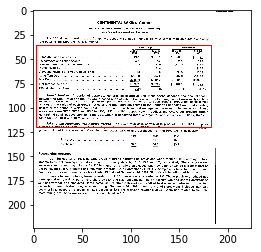

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9563_061.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 938 files and realized 0 errors


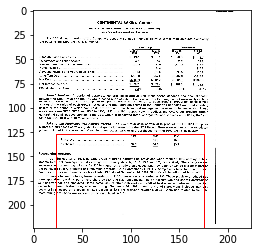

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9563_080.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 939 files and realized 0 errors


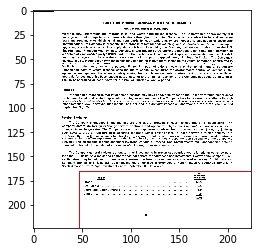

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9563_104.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 940 files and realized 0 errors


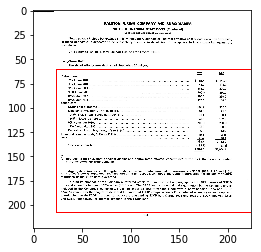

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9565_029.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 941 files and realized 0 errors


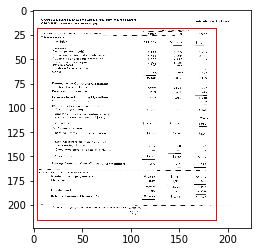

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9565_038.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 942 files and realized 0 errors


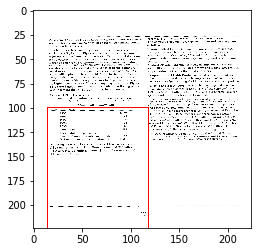

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9566_029.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 943 files and realized 0 errors


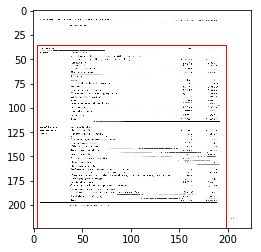

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9566_031.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 944 files and realized 0 errors


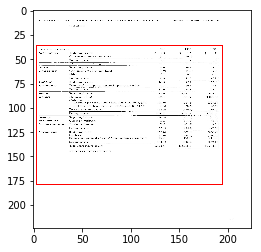

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9566_032.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 945 files and realized 0 errors


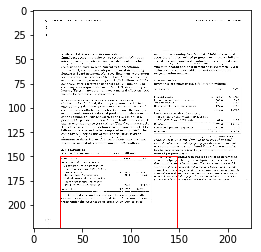

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9566_032.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 946 files and realized 0 errors


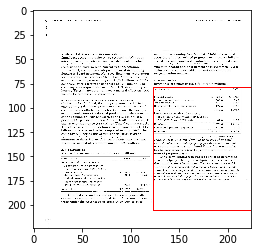

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9567_052.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 947 files and realized 0 errors


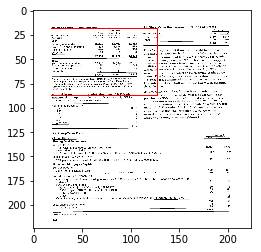

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9567_052.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 948 files and realized 0 errors


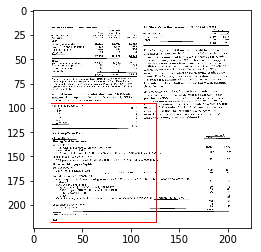

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9567_052.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 949 files and realized 0 errors


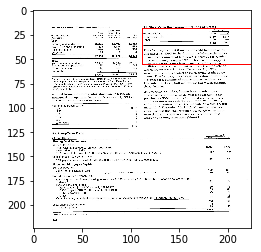

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9567_052.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 950 files and realized 0 errors


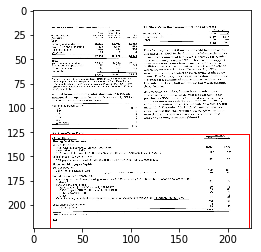

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9567_077.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 951 files and realized 0 errors


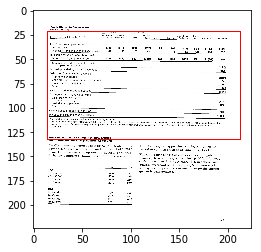

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9567_077.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 952 files and realized 0 errors


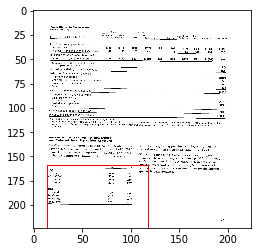

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9568_033.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 953 files and realized 0 errors


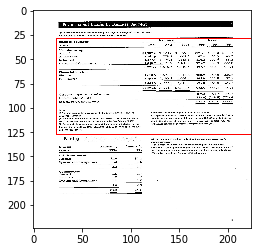

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9568_033.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 954 files and realized 0 errors


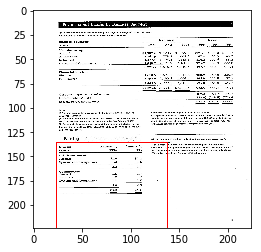

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9568_063.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 955 files and realized 0 errors


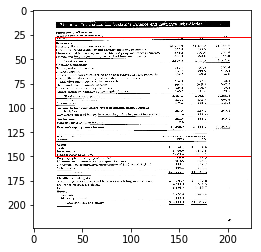

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9568_063.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 956 files and realized 0 errors


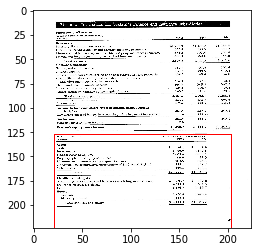

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9569_017.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 957 files and realized 0 errors


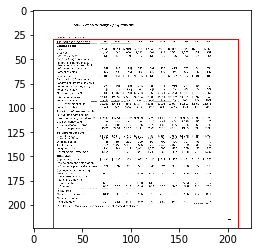

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9569_024.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 958 files and realized 0 errors


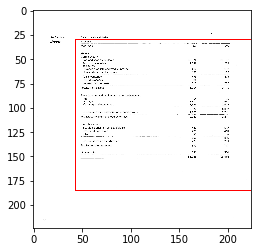

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9569_026.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 959 files and realized 0 errors


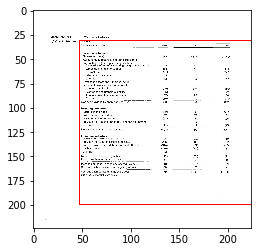

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9569_027.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 960 files and realized 0 errors


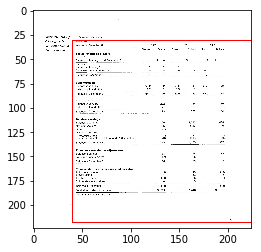

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9570_027.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 961 files and realized 0 errors


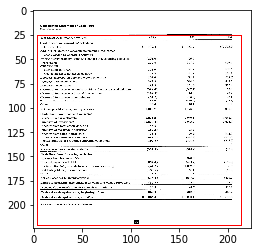

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9570_030.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 962 files and realized 0 errors


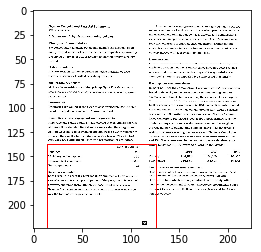

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9570_030.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 963 files and realized 0 errors


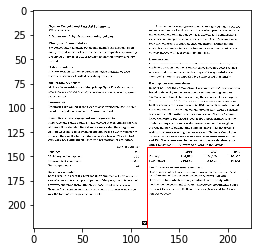

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9571_020.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 964 files and realized 0 errors


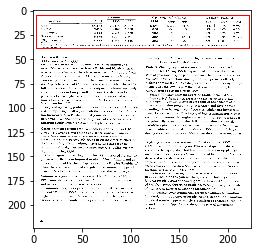

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9572_040.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 965 files and realized 0 errors


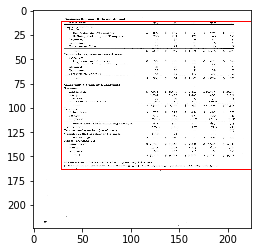

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9573_040.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 966 files and realized 0 errors


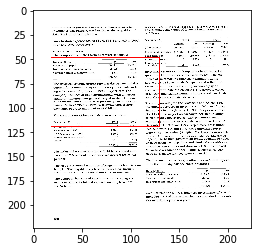

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9573_040.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 967 files and realized 0 errors


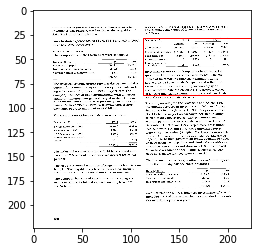

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9573_040.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 968 files and realized 0 errors


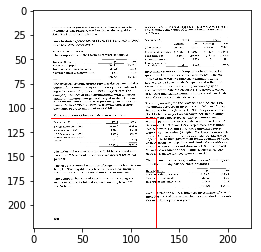

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9573_040.jpg
(3300, 2552, 3)
0.0877742946708464 0.06787878787878789
(224, 224, 3)
Reseized one image done
Checked 969 files and realized 0 errors


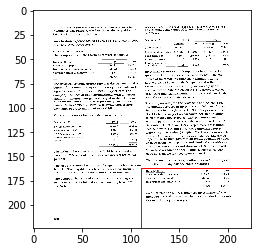

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/9574_049.jpg
(2550, 3304, 3)
0.06779661016949153 0.08784313725490196
(224, 224, 3)
Reseized one image done
Checked 970 files and realized 0 errors


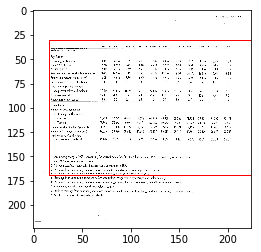

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti01410757.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 971 files and realized 0 errors


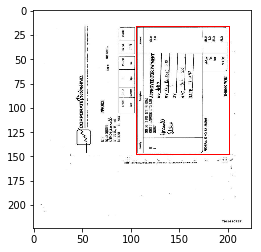

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti01410757.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 972 files and realized 0 errors


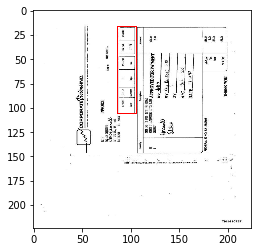

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti01410757.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 973 files and realized 0 errors


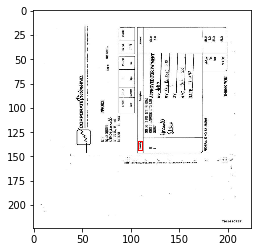

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti01410757.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 974 files and realized 0 errors


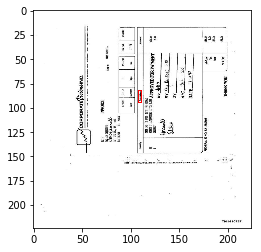

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti01410757.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 975 files and realized 0 errors


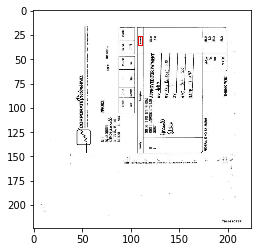

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti01410757.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 976 files and realized 0 errors


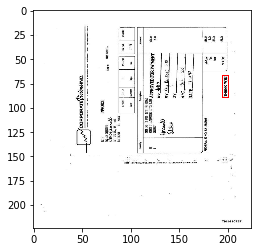

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161372.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 977 files and realized 0 errors


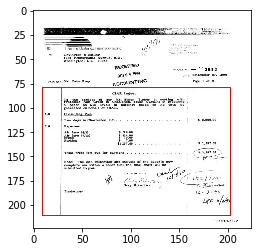

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161372.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 978 files and realized 0 errors


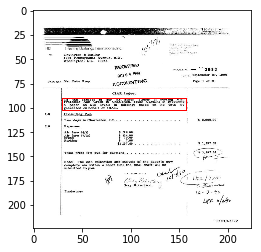

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161372.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 979 files and realized 0 errors


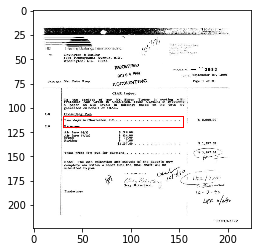

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161372.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 980 files and realized 0 errors


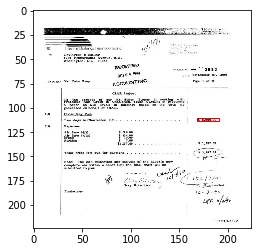

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161372.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 981 files and realized 0 errors


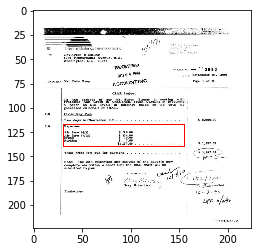

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161372.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 982 files and realized 0 errors


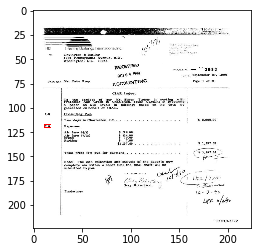

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161372.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 983 files and realized 0 errors


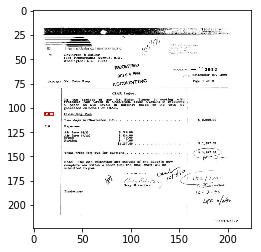

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161372.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 984 files and realized 0 errors


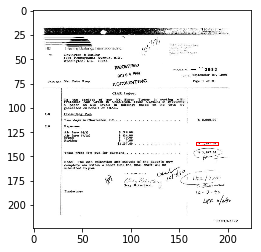

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161372.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 985 files and realized 0 errors


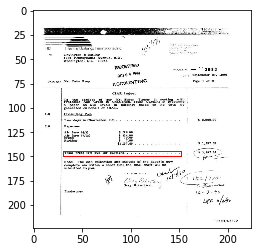

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161372.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 986 files and realized 0 errors


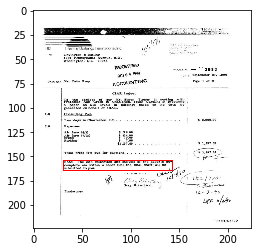

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161404.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 987 files and realized 0 errors


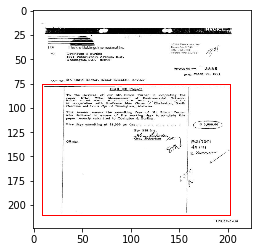

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161404.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 988 files and realized 0 errors


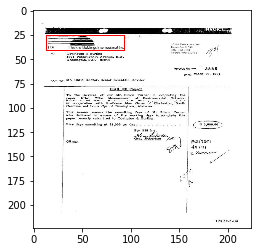

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161422.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 989 files and realized 0 errors


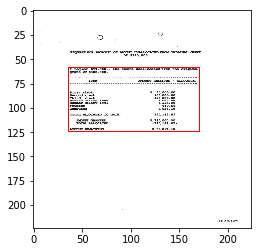

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161433.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 990 files and realized 0 errors


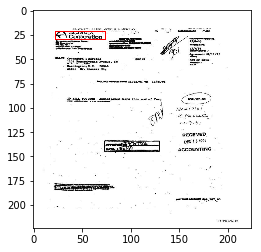

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161433.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 991 files and realized 0 errors


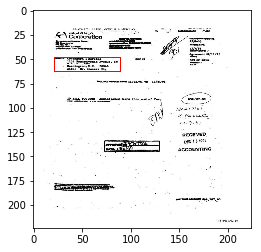

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161457.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 992 files and realized 0 errors


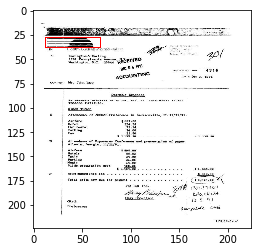

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161457.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 993 files and realized 0 errors


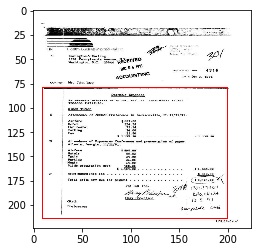

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161457.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 994 files and realized 0 errors


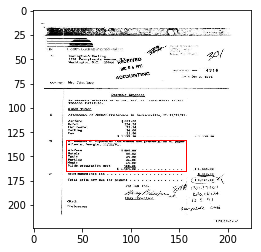

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161457.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 995 files and realized 0 errors


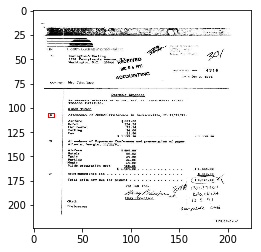

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161457.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 996 files and realized 0 errors


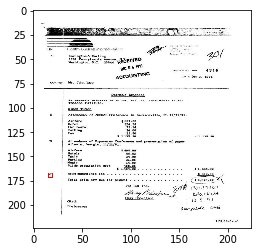

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161457.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 997 files and realized 0 errors


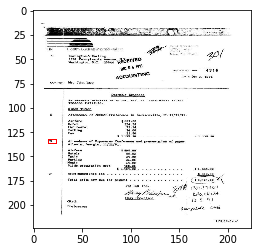

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161457.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 998 files and realized 0 errors


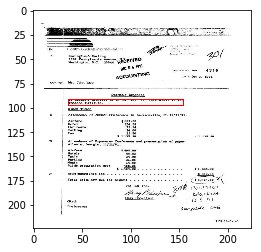

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161457.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 999 files and realized 0 errors


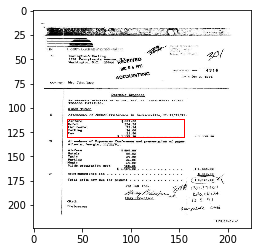

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161457.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 1000 files and realized 0 errors


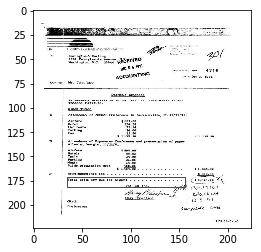

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161484.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 1001 files and realized 0 errors


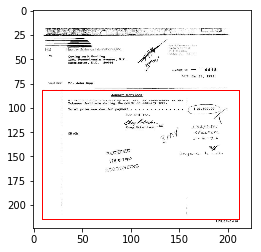

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161484.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 1002 files and realized 0 errors


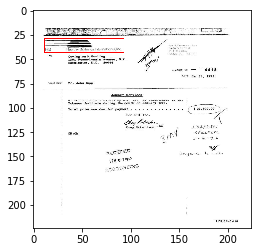

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161491.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 1003 files and realized 0 errors


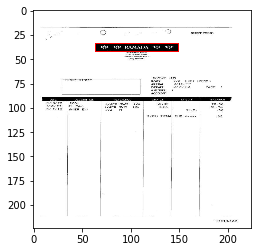

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161491.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 1004 files and realized 0 errors


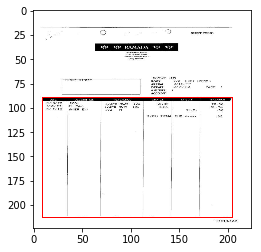

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161592.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 1005 files and realized 0 errors


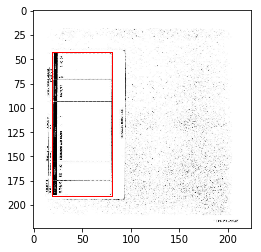

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161592.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 1006 files and realized 0 errors


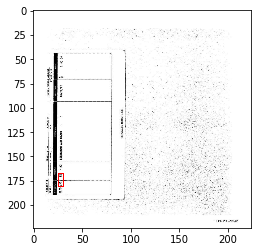

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161592.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 1007 files and realized 0 errors


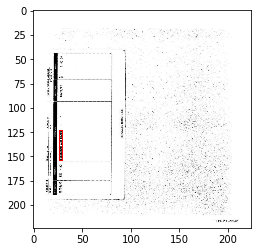

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161592.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 1008 files and realized 0 errors


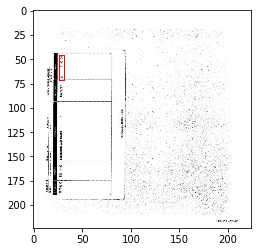

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161592.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 1009 files and realized 0 errors


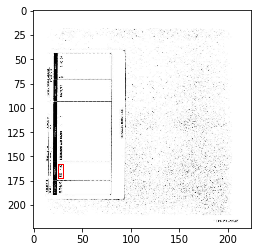

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161592.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 1010 files and realized 0 errors


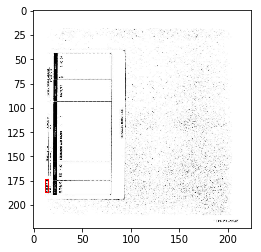

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161630.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 1011 files and realized 0 errors


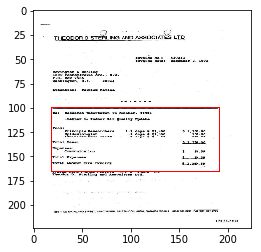

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161630.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 1012 files and realized 0 errors


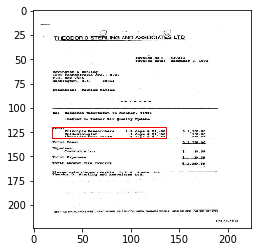

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161630.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 1013 files and realized 0 errors


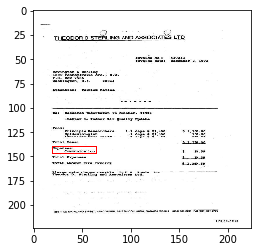

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161630.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 1014 files and realized 0 errors


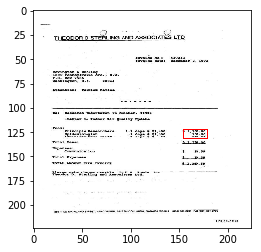

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161630.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 1015 files and realized 0 errors


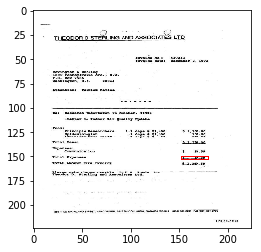

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161631.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 1016 files and realized 0 errors


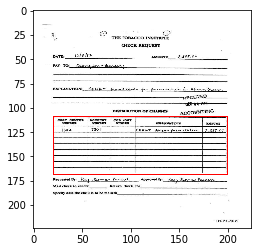

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11121470.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 1017 files and realized 0 errors


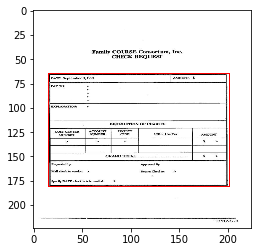

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492017.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 1018 files and realized 0 errors


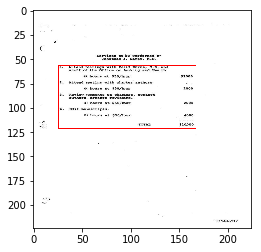

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492017.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 1019 files and realized 0 errors


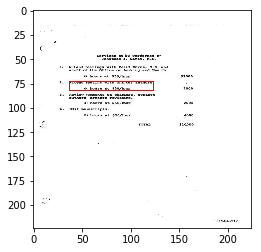

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492017.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 1020 files and realized 0 errors


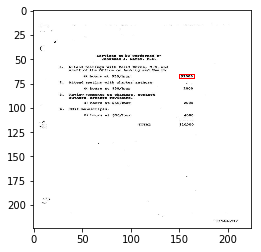

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492017.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 1021 files and realized 0 errors


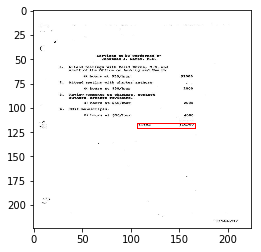

Processing /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492017.jpg
(1000, 754, 3)
0.29708222811671087 0.224
(224, 224, 3)
Reseized one image done
Checked 1022 files and realized 0 errors


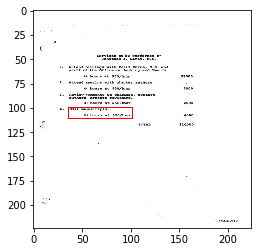

Done All


In [23]:
%matplotlib inline 
import cv2
import csv

from matplotlib import pyplot as plt
import numpy as np


def drawBox(boxes, image):
    for i in range(0, len(boxes)):
        # changed color and width to make it visible
        cv2.rectangle(image, (boxes[i][2], boxes[i][3]), (boxes[i][4], boxes[i][5]), (255, 0, 0), 1)
    #cv2.imshow("img", image)
    plt.imshow(image)
    plt.show()
    cv2.waitKey(0)
    cv2.destroyAllWindows()


def cvTest():
    
        FOLDER = '/content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages'
        CSV_FILE = '/content/Tensorflow_object_detector/workspace/training_OD/annotations/dataset_in.csv'
        new_rows = []
        
 
        with open(CSV_FILE, 'r') as fid:
   
                print('Checking file:', CSV_FILE, 'in folder:', FOLDER)
   
                file = csv.reader(fid, delimiter=',')
                first = True
   
                cnt = 0
                error_cnt = 0
                error = False
                for row in file:
                    new_row = row
                    if error == True:
                       error_cnt += 1
                       error = False
                    if first == True:
                       first = False
                       continue
                    cnt += 1
                    name = row[0]
                    file_name = os.path.join(FOLDER, name)
                    print("Processing %s" % file_name)
                    #image = Image.open(os.path.join(directory, file_name))

                    imageToPredict = cv2.imread(file_name, 3)
                    print(imageToPredict.shape)
                    # Note: flipped comparing to your original code!
                    # x_ = imageToPredict.shape[0]
                    # y_ = imageToPredict.shape[1]
                    y_ = imageToPredict.shape[0]
                    x_ = imageToPredict.shape[1]
                    targetSize = 224
                    x_scale = targetSize / x_
                    y_scale = targetSize / y_
                    print(x_scale, y_scale)
                    img = cv2.resize(imageToPredict, (targetSize, targetSize));
                    print(img.shape)
                    #img = np.array(img);
        
                    folder = '/content/Tensorflow_object_detector/workspace/training_OD/images/reseizedImages'
                    if not os.path.exists(folder):
                        os.makedirs(folder)
                    output_file_name = os.path.join(folder, name)
                    #output.save(output_file_name, "JPEG", quality = 95)
                    cv2.imwrite(output_file_name,img)
                    #img.save(output_file_name) with pil
                    print("Reseized one image done")
                    # original frame as named values
                    (origLeft, origTop, origRight, origBottom) = (float(row[4]), float(row[5]), float(row[6]), float(row[7]))
      
                    xmin = int(np.round(origLeft * x_scale))
                    ymin = int(np.round(origTop * y_scale))
                    xmax = int(np.round(origRight * x_scale))
                    ymax = int(np.round(origBottom * y_scale))
                    
                    label = row[3]
                    height, width = img.shape[:2]
       
               
                    
       
                    print('Checked %d files and realized %d errors' % (cnt, error_cnt))
                    changes = {row[0]:name , row[1]:width , row[2]: height, row[3]:label, row[4]: xmin , row[5]: ymin , row[6]: xmax , row[7]: ymax }
                
                    for key ,value in changes.items():
                         new_row = [x.replace(key,str(value)) for x  in new_row ]
                    new_rows.append(new_row)
                    #(row[4],row[5],row[6],row[7]) = (x, y , xmax , ymax)
                    # Box.drawBox([[1, 0, x, y, xmax, ymax]], img)
                    drawBox([[1, 0, xmin, ymin, xmax, ymax]], img)
                print("Done All")
        OUT = '/content/Tensorflow_object_detector/workspace/training_OD/annotations/dataset_out.csv'
        with open(OUT , 'w') as f:
            writer = csv.writer(f)
            writer.writerows(new_rows)
    


cvTest()

## Test

In [0]:
'''
def cvTest():
    
        FOLDER = '/content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages'
        CSV_FILE = '/content/Tensorflow_object_detector/workspace/training_OD/annotations/dataset_out.csv'
        new_rows = []
       
        
 
        with open(CSV_FILE, 'r') as fid:
                 next(fid)
   
                 print('Checking file:', CSV_FILE, 'in folder:', FOLDER)
   
                 file = csv.reader(fid, delimiter=',')
                 for row in file:
                    
                    
                    name = row[0]
                    file_name = os.path.join(FOLDER, name)
                    print("Processing %s" % file_name)
                    #image = Image.open(os.path.join(directory, file_name))
                    
                    imageToPredict = cv2.imread(file_name, 3)
                    print(row[1]) 
                    print(row[2])
                    print(row[4])
                    print(row[5])
                    print(row[6])
                    print(row[7])
                    width, height, xmin, ymin, xmax, ymax = float(row[1]), float(row[2]), float(row[4]), float(row[5]), float(row[6]), float(row[7])
                    
                    label = row[3]
                    
       
                    if type(imageToPredict) != type(None):
                           print('image exists:', imageToPredict)
                           org_height, org_width = imageToPredict.shape[:2]
                           if org_width == width and org_height == height and xmin < org_width and xmax < org_width and  ymin < org_height and ymax < org_height:
                                new_row = [row[0], row[1],row[2],row[3],row[4],row[5],row[6],row[7]]
                                new_rows.append(new_row)
                    
        OUT = '/content/Tensorflow_object_detector/workspace/training_OD/annotations/dataset_out1.csv'
        with open(OUT , 'w') as f:
              writer = csv.writer(f)
              writer.writerows(new_rows)
            
                           
                    
                         
                         
cvTest()
'''

In [27]:
#test if filenames of dataset_out exists in reseized folder
FOLDER = '/content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages'
CSV_FILE = '/content/Tensorflow_object_detector/workspace/training_OD/annotations/dataset_out.csv'
with open(CSV_FILE, 'r') as fid:
   
                 print('Checking file:', CSV_FILE, 'in folder:', FOLDER)
   
                 file = csv.reader(fid, delimiter=',')
                 for row in file:
                    name = row[0]
                    file_name = os.path.join(FOLDER, name)
                    if os.path.isfile(file_name) == False:
                      print('image', file_name , 'doesnt exist!')
                    
                    
                    

Checking file: /content/Tensorflow_object_detector/workspace/training_OD/annotations/dataset_out.csv in folder: /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages
image /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10118112.jpg doesnt exist!
image /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti10161321.jpg doesnt exist!
image /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti3061592.jpg doesnt exist!
image /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti269770.jpg doesnt exist!
image /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492132_2448.jpg doesnt exist!
image /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti11492452_2135.jpg doesnt exist!
image /content/Tensorflow_object_detector/workspace/training_OD/images/RGBImages/ti1486143.jpg doesnt exist!
image /content/Tensorflow_object_dete

## Delete wrong filenames from datset.csv and add its header
and reload it as dataset_out1

In [29]:
import shutil
shutil.copy('/content/drive/My Drive/dataset_out1.csv','/content/Tensorflow_object_detector/workspace/training_OD/annotations')

'/content/Tensorflow_object_detector/workspace/training_OD/annotations/dataset_out1.csv'

## Splitting Dataset into train and test

In [0]:
#shutil.copy('/content/drive/My Drive/RFCN/dataaa_corrected_bbx.csv','/content/Tensorflow_object_detector/workspace/training_OD/annotations')

In [0]:
    import pandas as pd

    import numpy as np

    #df = pd.read_csv('/content/drive/My Drive/Tensorflow_object_detector/workspace/training_OD/annotations/mydataset.csv',error_bad_lines=False)
    #df = pd.read_csv('/content/Tensorflow_object_detector/workspace/training_OD/annotations/annotation.csv',error_bad_lines=False)
    #df = pd.read_csv('/content/Tensorflow_object_detector/workspace/training_OD/annotations/dataset.csv',error_bad_lines=False)
    #df = pd.read_csv('/content/Tensorflow_object_detector/workspace/training_OD/annotations/dataset_out.csv',error_bad_lines=False)
    df = pd.read_csv('/content/Tensorflow_object_detector/workspace/training_OD/annotations/dataset_out1.csv',error_bad_lines=False)
    df['split'] = np.random.randn(df.shape[0], 1)

    msk = np.random.rand(len(df)) <= 0.8

    train = df[msk]

    test = df[~msk]

    train.to_csv('/content/Tensorflow_object_detector/workspace/training_OD/annotations/train.csv', index=None)
    test.to_csv('/content/Tensorflow_object_detector/workspace/training_OD/annotations/test.csv', index=None)

## Label map

In [31]:
import shutil
shutil.copy('/content/drive/My Drive/RFCN/dataset_label_map.pbtxt','/content/Tensorflow_object_detector/workspace/training_OD/annotations')

'/content/Tensorflow_object_detector/workspace/training_OD/annotations/dataset_label_map.pbtxt'

# Creating TFRecords

In [32]:
%cd /content/Tensorflow_object_detector/workspace/training_OD/scripts
!mkdir preprocessing

/content/Tensorflow_object_detector/workspace/training_OD/scripts


In [33]:
%cd /content/Tensorflow_object_detector/models/research
!python setup.py build
!python setup.py install

/content/Tensorflow_object_detector/models/research
running build
running build_py
creating build
creating build/lib
creating build/lib/object_detection
copying object_detection/exporter_test.py -> build/lib/object_detection
copying object_detection/inputs_test.py -> build/lib/object_detection
copying object_detection/__init__.py -> build/lib/object_detection
copying object_detection/exporter.py -> build/lib/object_detection
copying object_detection/export_inference_graph.py -> build/lib/object_detection
copying object_detection/export_tflite_ssd_graph_lib_test.py -> build/lib/object_detection
copying object_detection/model_main.py -> build/lib/object_detection
copying object_detection/model_tpu_main.py -> build/lib/object_detection
copying object_detection/eval_util_test.py -> build/lib/object_detection
copying object_detection/model_hparams.py -> build/lib/object_detection
copying object_detection/export_tflite_ssd_graph_lib.py -> build/lib/object_detection
copying object_detection/m

In [34]:
%cd /content/Tensorflow_object_detector/workspace/training_OD

/content/Tensorflow_object_detector/workspace/training_OD


In [35]:
import shutil
shutil.copy("/content/drive/My Drive/RFCN/generate_TFRecords.py","/content/Tensorflow_object_detector/workspace/training_OD/scripts/preprocessing")

'/content/Tensorflow_object_detector/workspace/training_OD/scripts/preprocessing/generate_TFRecords.py'

In [36]:
#!python scripts/preprocessing/generate_TFRecords.py --csv_input=annotations/train.csv --output_path=annotations/train.record --image_dir=
!python scripts/preprocessing/generate_TFRecords.py --csv_input=annotations/train.csv --output_path=annotations/train.record 

W0817 23:18:31.440605 139666767308672 deprecation_wrapper.py:119] From scripts/preprocessing/generate_TFRecords.py:103: The name tf.app.run is deprecated. Please use tf.compat.v1.app.run instead.

W0817 23:18:31.441357 139666767308672 deprecation_wrapper.py:119] From scripts/preprocessing/generate_TFRecords.py:89: The name tf.python_io.TFRecordWriter is deprecated. Please use tf.io.TFRecordWriter instead.

W0817 23:18:31.698701 139666767308672 deprecation_wrapper.py:119] From scripts/preprocessing/generate_TFRecords.py:48: The name tf.gfile.GFile is deprecated. Please use tf.io.gfile.GFile instead.

Successfully created the TFRecords: /content/Tensorflow_object_detector/workspace/training_OD/annotations/train.record


In [37]:
!python scripts/preprocessing/generate_TFRecords.py --csv_input=annotations/test.csv --output_path=annotations/eval.record 

W0817 23:18:42.723549 140561660577664 deprecation_wrapper.py:119] From scripts/preprocessing/generate_TFRecords.py:103: The name tf.app.run is deprecated. Please use tf.compat.v1.app.run instead.

W0817 23:18:42.724483 140561660577664 deprecation_wrapper.py:119] From scripts/preprocessing/generate_TFRecords.py:89: The name tf.python_io.TFRecordWriter is deprecated. Please use tf.io.TFRecordWriter instead.

W0817 23:18:42.814174 140561660577664 deprecation_wrapper.py:119] From scripts/preprocessing/generate_TFRecords.py:48: The name tf.gfile.GFile is deprecated. Please use tf.io.gfile.GFile instead.

Successfully created the TFRecords: /content/Tensorflow_object_detector/workspace/training_OD/annotations/eval.record


## Loading the pretrained model

In [38]:
%cd /content/Tensorflow_object_detector/workspace/training_OD/pre-trained_model

/content/Tensorflow_object_detector/workspace/training_OD/pre-trained_model


In [0]:
!wget http://download.tensorflow.org/models/object_detection/rfcn_resnet101_coco_2018_01_28.tar.gz

--2019-08-17 23:18:52--  http://download.tensorflow.org/models/object_detection/rfcn_resnet101_coco_2018_01_28.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 74.125.206.128, 2a00:1450:400c:c09::80
Connecting to download.tensorflow.org (download.tensorflow.org)|74.125.206.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 652955004 (623M) [application/x-tar]
Saving to: ‘rfcn_resnet101_coco_2018_01_28.tar.gz’

  rfcn_resnet101_co  29%[====>               ] 184.01M  83.0MB/s               

In [0]:
!tar -C /content/Tensorflow_object_detector/workspace/training_OD/pre-trained_model  -xzvf /content/Tensorflow_object_detector/workspace/training_OD/pre-trained_model/rfcn_resnet101_coco_2018_01_28.tar.gz

## Training

In [0]:
shutil.copy("/content/drive/My Drive/RFCN/rfcn_resnet101_coco.config","/content/Tensorflow_object_detector/workspace/training_OD/training")

In [0]:
shutil.copy("/content/drive/My Drive/RFCN/train.py","/content/Tensorflow_object_detector/workspace/training_OD")

In [0]:
#fixes nets import error 
import os
os.environ['PYTHONPATH'] += ':/content/Tensorflow_object_detector/models/research/:/content/Tensorflow_object_detector/models/research/slim/'

In [0]:
%cd /content/Tensorflow_object_detector/workspace/training_OD

In [0]:
!python /content/Tensorflow_object_detector/workspace/training_OD/train.py --logtostderr --train_dir=training --pipeline_config_path=training/rfcn_resnet101_coco.config

## Training Evaluation

In [0]:
shutil.copy("/content/drive/My Drive/RFCN/eval.py","/content/Tensorflow_object_detector/workspace/training_OD")

In [0]:
%cd /content/Tensorflow_object_detector/workspace/training_OD

In [0]:
!python /content/Tensorflow_object_detector/workspace/training_OD/eval.py --logtostderr --pipeline_config_path=training/rfcn_resnet101_coco.config --checkpoint_dir=training/ --eval_dir=training/

## Tensorboard

In [0]:
%cd /content/Tensorflow_object_detector/workspace/training_OD

In [0]:
!tensorboard --logdir=training